# P07A DeepDown Comparison

@author: Midhun Murukesh (midhunmachari@gmail.com)

Date: 21 August 2024

### Common Utilities

In [1]:
# Define other utility functions

def create_directory(directory_path):
    if not os.path.exists(directory_path):
        os.makedirs(directory_path)
        print(f"Directory '{directory_path}' created.")
    else:
        print(f"Directory '{directory_path}' already exists.")

In [2]:
SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
DATA_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/GENDATA"

## Figure - Study Area

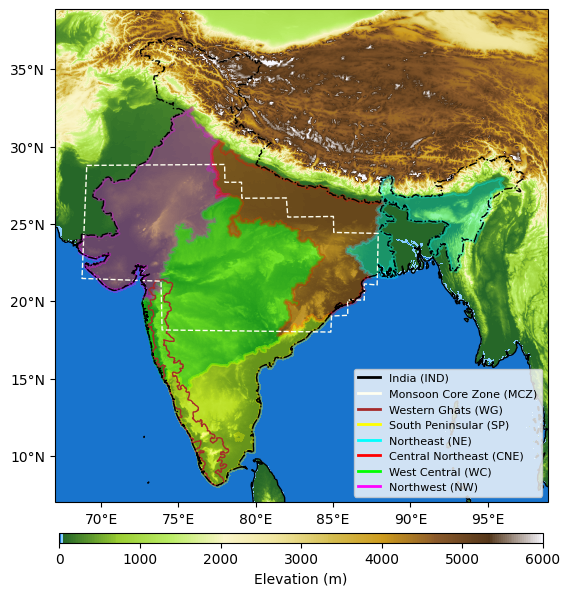

In [148]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.io.shapereader as shpreader
import xarray as xr
import geopandas as gpd
import cmaps
from cartopy.mpl.gridliner import LongitudeFormatter, LatitudeFormatter

SHAPE_PATH = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES'
DPATH = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA'

## Smart City Locations
city_loc = pd.read_csv(f'{DPATH}/India_Smart_Cities_Selected_12.csv')

## Load orography data
ds = xr.open_dataset(f'{DPATH}/IND_GTOPO30_30ARCSEC_50r.nc')
orog = ds['z']

# Get latitude and longitude coordinates from xarray dataset
lats = ds['lat']
lons = ds['lon']

# Define plot extent
lat_range = (ds.lat.data.min(), ds.lat.data.max())
lon_range = (ds.lon.data.min(), ds.lon.data.max())

# Create figure and axis objects
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

# Plot orography data with inverted y-axis
im = ax.imshow(orog, 
               cmap=cmaps.OceanLakeLandSnow,
               alpha=1.0, vmin=0, vmax=6000,
               extent=[lon_range[0], lon_range[1], lat_range[1], lat_range[0]], 
               origin='upper', 
               transform=ccrs.PlateCarree())

# Add coastlines and colorbar
ax.coastlines(resolution='50m')
cbar = plt.colorbar(im, orientation='horizontal', pad=0.05, aspect=50, shrink=0.78)
cbar.set_label('Elevation (m)')

# Overlay other shapefiles
india_subzones = [   
    {'shapefile': 'Northwest.shp', 
     'label': 'Northwest (NW)', 
     'linestyle': '-', 
     'color': 'magenta'
    }, 

    {'shapefile': 'West_Central.shp', 
     'label': 'West Central (WC)', 
     'linestyle': '-', 
     'color': 'lime'
    },
    
    {'shapefile': 'Central_Northeast.shp', 
     'label': 'Central Northeast (CNE)', 
     'linestyle': '-',
     'color': 'red'
    }, 
    
    {'shapefile': 'Northeast.shp', 
     'label': 'Northeast (NE)', 
     'linestyle': '-', 
     'color': 'cyan'
    },
    
    {'shapefile': 'South_Peninsular.shp', 
     'label': 'South Peninsular (SP)', 
     'linestyle': '-', 
     'color': 'yellow'
    },

    {'shapefile': 'Western_Ghats.shp', 
     'label': 'Western Ghats (WG)', 
     'linestyle': '-', 
     'color': 'brown'
    },

    {'shapefile': 'Monsoon_Core_Zone.shp', 
     'label': 'Monsoon Core Zone (MCZ)', 
     'linestyle': '--', 
     'color': 'ivory'
    },
    
    {'shapefile': 'India.shp', 
     'label': 'India (IND)', 
     'linestyle': '-.', 
     'color': 'k'
    },    

    # {'shapefile': 'Himalaya.shp', 
    #  'label': 'Himalayas (HIM)', 
    #  'linestyle': '-', 
    #  'color': 'blue'
    # },
    
    # {'shapefile': 'Hilly_Regions.shp', 
    #  'label': 'Hilly Regions (HR)', 
    #  'linestyle': '-', 
    #  'color': 'blue'
    # },
    
]

for region in india_subzones:
    geometries = gpd.read_file(f'{SHAPE_PATH}/{region["shapefile"]}')['geometry']
    for geometry in geometries:
        if region['label'] in ['Himalayas (HIM)', 'Northwest (NW)', 'Central Northeast (CNE)', 
                               'Northeast (NE)', 'West Central (WC)', 'South Peninsular (SP)', 'Hilly Regions (HR)']:
            ax.add_geometries([geometry], ccrs.PlateCarree(), 
                              facecolor= region['color'], 
                              edgecolor=region['color'], linewidth=2, linestyle=region['linestyle'], 
                              alpha=0.3)
        else:
            ax.add_geometries([geometry], ccrs.PlateCarree(), 
                              facecolor='none', 
                              edgecolor=region['color'], linewidth=1, linestyle=region['linestyle'])
    ax.plot([], [], color=region['color'], label=region['label'], linewidth=2)

# # Plot Smart City Locations
# ax.scatter(city_loc['Longitude'], city_loc['Latitude'], 
#            color='red', s=120, marker='*', 
#            transform=ccrs.PlateCarree(), 
#            edgecolor='black', linewidth=1, zorder=10, label='Selected Cities')

ax.invert_yaxis()

# Add a legend with reversed order
handles, labels = ax.get_legend_handles_labels()  # Get current legend handles and labels
ax.legend(handles[::-1], labels[::-1], loc='lower right', fontsize=8)  # Reverse the order
fig.canvas.draw()  

# Add latitude and longitude ticks
ax.set_xticks(np.arange(70, 99, 5), crs=ccrs.PlateCarree())
ax.set_yticks(np.arange(10, 38, 5), crs=ccrs.PlateCarree())
lon_formatter = LongitudeFormatter(zero_direction_label=False)
lat_formatter = LatitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.yaxis.set_major_formatter(lat_formatter)

SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
plt.savefig(f'{SAVE_PATH}/Figure_Elevation_Map.png', 
            format='png', dpi=600, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()


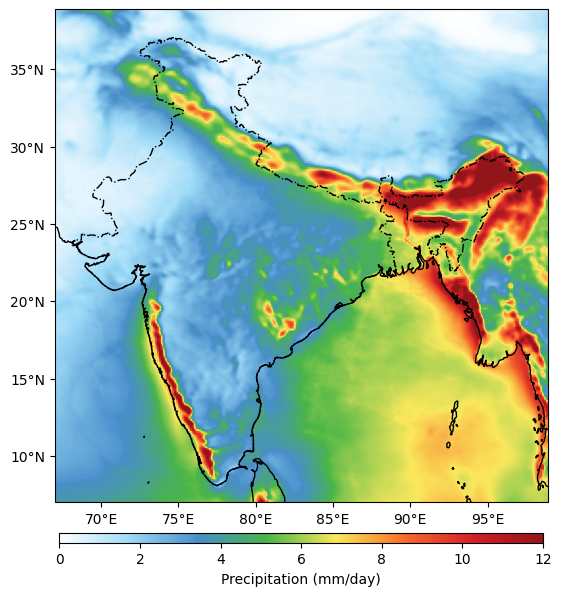

In [23]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.io.shapereader as shpreader
import xarray as xr
import geopandas as gpd
import cmaps
from cartopy.mpl.gridliner import LongitudeFormatter, LatitudeFormatter

SHAPE_PATH = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES'
DPATH = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA'

## Smart City Locations
city_loc = pd.read_csv(f'{DPATH}/India_Smart_Cities_Selected_12.csv')

## Load orography data
ds = xr.open_dataset(f'{DPATH}/IMDAA_2015_2020_TIMMEAN.nc')
orog = ds['prec'][0]

# Get latitude and longitude coordinates from xarray dataset
lats = ds['lat']
lons = ds['lon']

# Define plot extent
lat_range = (ds.lat.data.min(), ds.lat.data.max())
lon_range = (ds.lon.data.min(), ds.lon.data.max())

# Create figure and axis objects
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

# Plot orography data with inverted y-axis
im = ax.imshow(orog, 
               cmap=cmaps.WhiteBlueGreenYellowRed,
               alpha=1.0, vmin=0, vmax=12,
               extent=[lon_range[0], lon_range[1], lat_range[1], lat_range[0]], 
               origin='upper', 
               transform=ccrs.PlateCarree())

# Add coastlines and colorbar
ax.coastlines(resolution='50m')
cbar = plt.colorbar(im, orientation='horizontal', pad=0.05, aspect=50, shrink=0.78)
cbar.set_label('Precipitation (mm/day)')

# Overlay other shapefiles
india_subzones = [   
    # {'shapefile': 'Northwest.shp', 
    #  'label': 'Northwest (NW)', 
    #  'linestyle': '-', 
    #  'color': 'magenta'
    # }, 

    # {'shapefile': 'West_Central.shp', 
    #  'label': 'West Central (WC)', 
    #  'linestyle': '-', 
    #  'color': 'lime'
    # },
    
    # {'shapefile': 'Central_Northeast.shp', 
    #  'label': 'Central Northeast (CNE)', 
    #  'linestyle': '-',
    #  'color': 'red'
    # }, 
    
    # {'shapefile': 'Northeast.shp', 
    #  'label': 'Northeast (NE)', 
    #  'linestyle': '-', 
    #  'color': 'cyan'
    # },
    
    # {'shapefile': 'South_Peninsular.shp', 
    #  'label': 'South Peninsular (SP)', 
    #  'linestyle': '-', 
    #  'color': 'yellow'
    # },

    # {'shapefile': 'Western_Ghats.shp', 
    #  'label': 'Western Ghats (WG)', 
    #  'linestyle': '-', 
    #  'color': 'brown'
    # },

    # {'shapefile': 'Monsoon_Core_Zone.shp', 
    #  'label': 'Monsoon Core Zone (MCZ)', 
    #  'linestyle': '--', 
    #  'color': 'ivory'
    # },
    
    {'shapefile': 'India.shp', 
     'label': 'India (IND)', 
     'linestyle': '-.', 
     'color': 'k'
    },    

    # {'shapefile': 'Himalaya.shp', 
    #  'label': 'Himalayas (HIM)', 
    #  'linestyle': '-', 
    #  'color': 'blue'
    # },
    
    # {'shapefile': 'Hilly_Regions.shp', 
    #  'label': 'Hilly Regions (HR)', 
    #  'linestyle': '-', 
    #  'color': 'blue'
    # },
    
] 

for region in india_subzones:
    geometries = gpd.read_file(f'{SHAPE_PATH}/{region["shapefile"]}')['geometry']
    for geometry in geometries:
        if region['label'] in ['Himalayas (HIM)', 'Northwest (NW)', 'Central Northeast (CNE)', 
                               'Northeast (NE)', 'West Central (WC)', 'South Peninsular (SP)', 'Hilly Regions (HR)']:
            ax.add_geometries([geometry], ccrs.PlateCarree(), 
                              facecolor= region['color'], 
                              edgecolor=region['color'], linewidth=2, linestyle=region['linestyle'], 
                              alpha=0)
        else:
            ax.add_geometries([geometry], ccrs.PlateCarree(), 
                              facecolor='none', 
                              edgecolor=region['color'], linewidth=1, linestyle=region['linestyle'])
    ax.plot([], [], color=region['color'], label=region['label'], linewidth=2)

# # Plot Smart City Locations
# ax.scatter(city_loc['Longitude'], city_loc['Latitude'], 
#            color='red', s=120, marker='*', 
#            transform=ccrs.PlateCarree(), 
#            edgecolor='black', linewidth=1, zorder=10, label='Selected Cities')

ax.invert_yaxis()

# Add a legend with reversed order
handles, labels = ax.get_legend_handles_labels()  # Get current legend handles and labels
# ax.legend(handles[::-1], labels[::-1], loc='lower right', fontsize=8)  # Reverse the order
fig.canvas.draw()  

# Add latitude and longitude ticks
ax.set_xticks(np.arange(70, 99, 5), crs=ccrs.PlateCarree())
ax.set_yticks(np.arange(10, 38, 5), crs=ccrs.PlateCarree())
lon_formatter = LongitudeFormatter(zero_direction_label=False)
lat_formatter = LatitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.yaxis.set_major_formatter(lat_formatter)

# SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
# plt.savefig(f'{SAVE_PATH}/Figure_Timmean_Map.png', 
#             format='png', dpi=600, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()


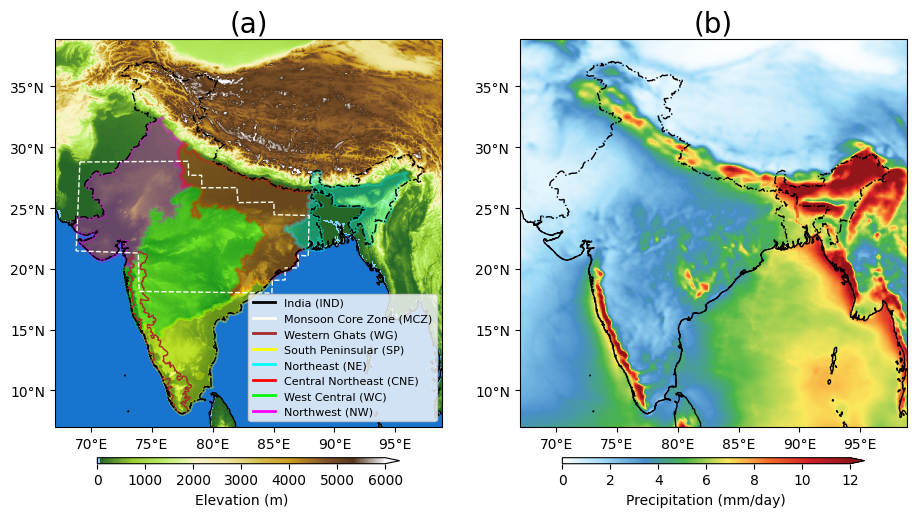

In [44]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import xarray as xr
import geopandas as gpd
import cmaps
from cartopy.mpl.gridliner import LongitudeFormatter, LatitudeFormatter

SHAPE_PATH = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES'
DPATH = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA'

## Load orography data
ds_orog = xr.open_dataset(f'{DPATH}/IND_GTOPO30_30ARCSEC_50r.nc')
orog = ds_orog['z']

## Load precipitation data
ds_prec = xr.open_dataset(f'{DPATH}/IMDAA_2015_2020_TIMMEAN.nc')
prec = ds_prec['prec'][0]

# Get latitude and longitude coordinates
lat_range_orog = (ds_orog.lat.data.min(), ds_orog.lat.data.max())
lon_range_orog = (ds_orog.lon.data.min(), ds_orog.lon.data.max())
lat_range_prec = (ds_prec.lat.data.min(), ds_prec.lat.data.max())
lon_range_prec = (ds_prec.lon.data.min(), ds_prec.lon.data.max())

# Create a 1x2 subplot
fig, axes = plt.subplots(1, 2, figsize=(11, 8), subplot_kw={'projection': ccrs.PlateCarree()})

# Plot orography map
ax1 = axes[0]
im1 = ax1.imshow(orog,
                 cmap=cmaps.OceanLakeLandSnow,
                 alpha=1.0, vmin=0, vmax=6000,
                 extent=[lon_range_orog[0], lon_range_orog[1], lat_range_orog[1], lat_range_orog[0]],
                 origin='upper',
                 transform=ccrs.PlateCarree())
ax1.coastlines(resolution='50m')
cbar1 = plt.colorbar(im1, ax=ax1, orientation='horizontal', pad=0.05, aspect=50, shrink=0.78, extend='max')
cbar1.set_label('Elevation (m)')
ax1.set_title("(a)", fontsize=20)
ax1.invert_yaxis()

# Plot precipitation map
ax2 = axes[1]
im2 = ax2.imshow(prec,
                 cmap=cmaps.WhiteBlueGreenYellowRed,
                 alpha=1.0, vmin=0, vmax=12,
                 extent=[lon_range_prec[0], lon_range_prec[1], lat_range_prec[1], lat_range_prec[0]],
                 origin='upper',
                 transform=ccrs.PlateCarree())
ax2.coastlines(resolution='50m')
cbar2 = plt.colorbar(im2, ax=ax2, orientation='horizontal', pad=0.05, aspect=50, shrink=0.78, extend='max')
cbar2.set_label('Precipitation (mm/day)')
ax2.set_title("(b)", fontsize=20)
ax2.invert_yaxis()

# Add latitude and longitude ticks for both subplots
for ax in axes:
    ax.set_xticks(np.arange(70, 99, 5), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(10, 38, 5), crs=ccrs.PlateCarree())
    lon_formatter = LongitudeFormatter(zero_direction_label=False)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)

## Add Shapefiles
# Define subregion shapefiles and properties
india_subzones = [
    {'shapefile': 'Northwest.shp', 'label': 'Northwest (NW)', 'linestyle': '-', 'color': 'magenta'},
    {'shapefile': 'West_Central.shp', 'label': 'West Central (WC)', 'linestyle': '-', 'color': 'lime'},
    {'shapefile': 'Central_Northeast.shp', 'label': 'Central Northeast (CNE)', 'linestyle': '-', 'color': 'red'},
    {'shapefile': 'Northeast.shp', 'label': 'Northeast (NE)', 'linestyle': '-', 'color': 'cyan'},
    {'shapefile': 'South_Peninsular.shp', 'label': 'South Peninsular (SP)', 'linestyle': '-', 'color': 'yellow'},
    {'shapefile': 'Western_Ghats.shp', 'label': 'Western Ghats (WG)', 'linestyle': '-', 'color': 'brown'},
    {'shapefile': 'Monsoon_Core_Zone.shp', 'label': 'Monsoon Core Zone (MCZ)', 'linestyle': '--', 'color': 'ivory'},
    {'shapefile': 'India.shp', 'label': 'India (IND)', 'linestyle': '-.', 'color': 'k'},
]

for region in india_subzones:
    geometries = gpd.read_file(f'{SHAPE_PATH}/{region["shapefile"]}')['geometry']
    for geometry in geometries:
        if region['label'] in ['Himalayas (HIM)', 'Northwest (NW)', 'Central Northeast (CNE)', 
                               'Northeast (NE)', 'West Central (WC)', 'South Peninsular (SP)', 'Hilly Regions (HR)']:
            ax1.add_geometries([geometry], ccrs.PlateCarree(), 
                              facecolor= region['color'], 
                              edgecolor=region['color'], linewidth=2, linestyle=region['linestyle'], 
                              alpha=0.3)
        else:
            ax1.add_geometries([geometry], ccrs.PlateCarree(), 
                              facecolor='none', 
                              edgecolor=region['color'], linewidth=1, linestyle=region['linestyle'])
    ax1.plot([], [], color=region['color'], label=region['label'], linewidth=2)

# Add legend to ax1

handles, labels = ax1.get_legend_handles_labels()  # Get current legend handles and labels
ax1.legend(handles[::-1], labels[::-1], loc='lower right', fontsize=8)  # Reverse the order
fig.canvas.draw()  

#### For ax2
# Define subregion shapefiles and properties
india_subzones = [
    {'shapefile': 'India.shp', 'label': 'India (IND)', 'linestyle': '-.', 'color': 'k'},
]

# Add shapefiles for subregions to ax1
for region in india_subzones:
    geometries = gpd.read_file(f'{SHAPE_PATH}/{region["shapefile"]}')['geometry']
    for geometry in geometries:
        ax2.add_geometries(
            [geometry], ccrs.PlateCarree(),
            facecolor='none',
            edgecolor=region['color'],
            linewidth=1,
            linestyle=region['linestyle']
        )

# Save the figure
SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
# plt.savefig(f'{SAVE_PATH}/Figure01_Elevation_Climatology.png', format='png', dpi=600, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()


## Figure: Boxplot Eval Metrics

### Prepare dataset as csv

In [13]:
# import numpy as np
# import pandas as pd
# import xarray as xr

# def custom_masker(mask_path, data_ds, model_id, metric_name='KGE'):
#     """Mask an xarray DataArray to apply the region mask and flatten the data."""
#     dataarray = data_ds[f'{model_id}_{metric_name}'].squeeze()
#     maskarray = xr.open_dataset(mask_path).mask.squeeze()
    
#     if isinstance(maskarray, xr.DataArray):
#         maskarray = maskarray.values
#     if dataarray.shape != maskarray.shape:
#         raise ValueError("dataarray and maskarray must have the same shape")
        
#     masked_array = (dataarray * maskarray).data.flatten()
#     masked_array = masked_array[~np.isnan(masked_array)]
#     return masked_array

# def df_to_dict(df, key_col, value_col):
#     """Convert a DataFrame to a dictionary with unique keys and corresponding values."""
#     return df.set_index(key_col)[value_col].to_dict()

# def filter_df(df, column, string):
#     """Select and merge rows from the dataframe where the specified string is present in the specified column."""
#     return df[df[column].str.contains(string, na=False)]

# MASK_PATH = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES'
# zones_dict = {'IND': [f'{MASK_PATH}/India.nc', 'INDIA']} 

# DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
# SPATH = DPATH

# df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")
# df = filter_df(df, column='ZONE_NAME', string="INDIA")
# data_dict = df_to_dict(df, key_col="EXP_ID", value_col="LABEL")

# data_ds = xr.open_dataset(f'{DPATH}/EVAL_METRICS_SPATIAL_v1.nc')

# ########## Save the PCC, NSE, RMSE and PBIAS data as separate csv ###########
# for metric_name in ["PCC", "NSE", "RMSE", "PBIAS"]:

#     data_load = {zone: pd.DataFrame({model_label: custom_masker(zone_mask_path, data_ds, model_id, metric_name) 
#                                      for model_id, model_label in data_dict.items()}) 
#                  for zone, (zone_mask_path, zone_label) in zones_dict.items()}
    
#     df = pd.DataFrame(data_load['IND'])

#     csv_name = f"EVAL_METRICS_SPATIAL_FLATTEN_{metric_name}.csv"
#     df.to_csv(f"{SPATH}/{csv_name}", index=False)
#     print(f"Saved {SPATH}/{csv_name}")


### Plot the Diagram

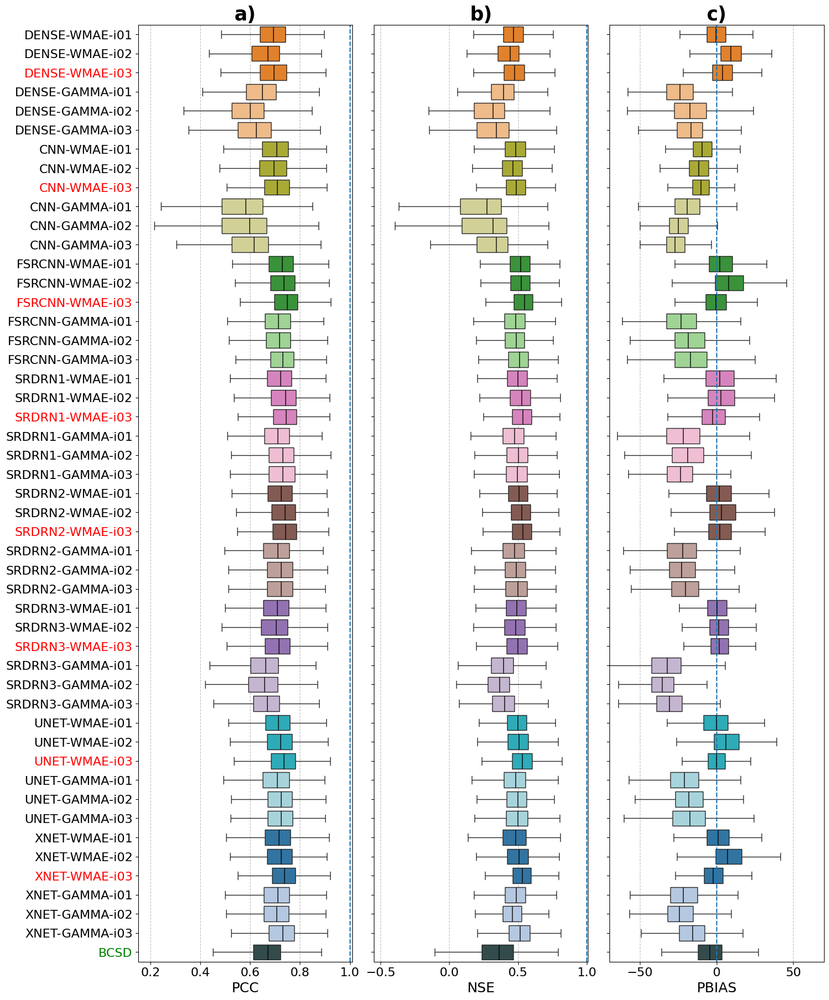

In [14]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

def plot_hboxes(ax, df, xlabel="PCC", xlim=(None, None), title='Box Plots', ref_val=None, yticks_off=False):

    # # Set the style of the plots
    # sns.set_style("white")
    
    # # Create a color list with the desired pattern
    # colours = ["grey"]  # Start with dark grey for the 0th bar
    
    # # Alternate between blue colors for the remaining bars
    # for i in range(1, len(df.columns)):
    #     if (i - 1) // 3 % 2 == 0:
    #         colours.append("#87CEEB")  # Light blue
    #     else:
    #         colours.append("#4682B4")  # Dark blue

        
    colours = [
    "#2F4F4F",
    "#aec7e8", "#aec7e8", "#aec7e8", "#1f77b4", "#1f77b4", "#1f77b4",  # Blue pair
    "#9edae5", "#9edae5", "#9edae5", "#17becf", "#17becf", "#17becf",  # Teal pair 
    "#c5b0d5", "#c5b0d5", "#c5b0d5", "#9467bd", "#9467bd", "#9467bd",  # Purple pair
    "#c49c94", "#c49c94", "#c49c94", "#8c564b", "#8c564b", "#8c564b",  # Brown pair
    "#f7b6d2", "#f7b6d2", "#f7b6d2", "#e377c2", "#e377c2", "#e377c2",  # Pink pair
     "#98df8a", "#98df8a", "#98df8a", "#2ca02c", "#2ca02c", "#2ca02c",  # Green pair
    "#dbdb8d", "#dbdb8d", "#dbdb8d", "#bcbd22", "#bcbd22", "#bcbd22",  # Yellow-green pair
    "#ffbb78", "#ffbb78", "#ffbb78", "#ff7f0e", "#ff7f0e", "#ff7f0e",  # Orange pair
    ]
    # Reverse the order of colors
    colours.reverse()  # This will reverse the list
    
    # Create the boxplot in the first subplot with specified colors
    # sns.boxplot(data=df, ax=ax, orient='h', showfliers=False, palette=colours)  # Use the palette directly
    ax.grid(True, axis='both', linestyle='--', alpha=0.8, zorder=1)
    
    sns.boxplot(data=df, ax=ax, orient='h', showfliers=False, palette=colours, 
                medianprops=dict(color='black'),
                meanprops=dict(marker='o', markerfacecolor='orange'), zorder=2,
                )
    
    ax.set_title(title, fontsize=25, fontweight='bold')
    ax.set_xlabel(xlabel, fontsize=18)
    ax.tick_params(axis='both', labelsize=16) 

    ax.set_xlim(xlim[0], xlim[1])

    if ref_val is not None:
        ax.axvline(x=ref_val, linestyle='--') 
    
    # Change the color of ytick if label is "WMAE-i03"
    for label in ax.get_yticklabels():
        if "WMAE-i03" in label.get_text():
            label.set_color("red")
        if "BCSD" in label.get_text():
            label.set_color("green")
    
    if yticks_off:
        ax.tick_params(axis='y', which='both', labelleft=False)

    # ax.grid(True, axis='y', linestyle='--', alpha=0.8)
    
###########################################################################################

# Assuming df contains the DataFrame with your data
# csv_save_dir = '/home/midhunm/AI4KLIM/EXPMNTS/P03B_SRDRN_Downscaling_AuxVars/ANALYSE/RESULTS'
# csv_name = 'P03B_TABLE_INDMASK_TEST_R99Mon_SelExp_EXPLAINED_VARIANCE_v1.0.0.csv'

CSV_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

df_pcc = pd.read_csv(f"{CSV_PATH}/EVAL_METRICS_SPATIAL_FLATTEN_PCC.csv")
df_nse = pd.read_csv(f"{CSV_PATH}/EVAL_METRICS_SPATIAL_FLATTEN_NSE.csv")
df_pbias = pd.read_csv(f"{CSV_PATH}/EVAL_METRICS_SPATIAL_FLATTEN_PBIAS.csv")

# Create a 1x4 grid of subplots with specified figure size and spacing
fig, axs = plt.subplots(1, 3, figsize=(16, 22), gridspec_kw={'wspace': 0.1, 'hspace': 0.15}) 

# Plotting the box plots in the correct subplot axes
plot_hboxes(axs[0], df_pcc, xlabel="PCC", title='a)', ref_val=1, xlim=(0.15, 1.01),)
plot_hboxes(axs[1], df_nse, xlabel="NSE", title='b)', yticks_off=True, ref_val=1, xlim=(-0.55, 1.01),)
plot_hboxes(axs[2], df_pbias, xlabel="PBIAS", title='c)', xlim=(-70, 70), yticks_off=True, ref_val=0)

# SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
# plt.savefig(f'{SAVE_PATH}/Figure_Eval_Metrics_Spatial_BoxPlots.png', 
#             format='png', dpi=600, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()


## Figure 05: Spatial Map of Eval Metrics: NSE

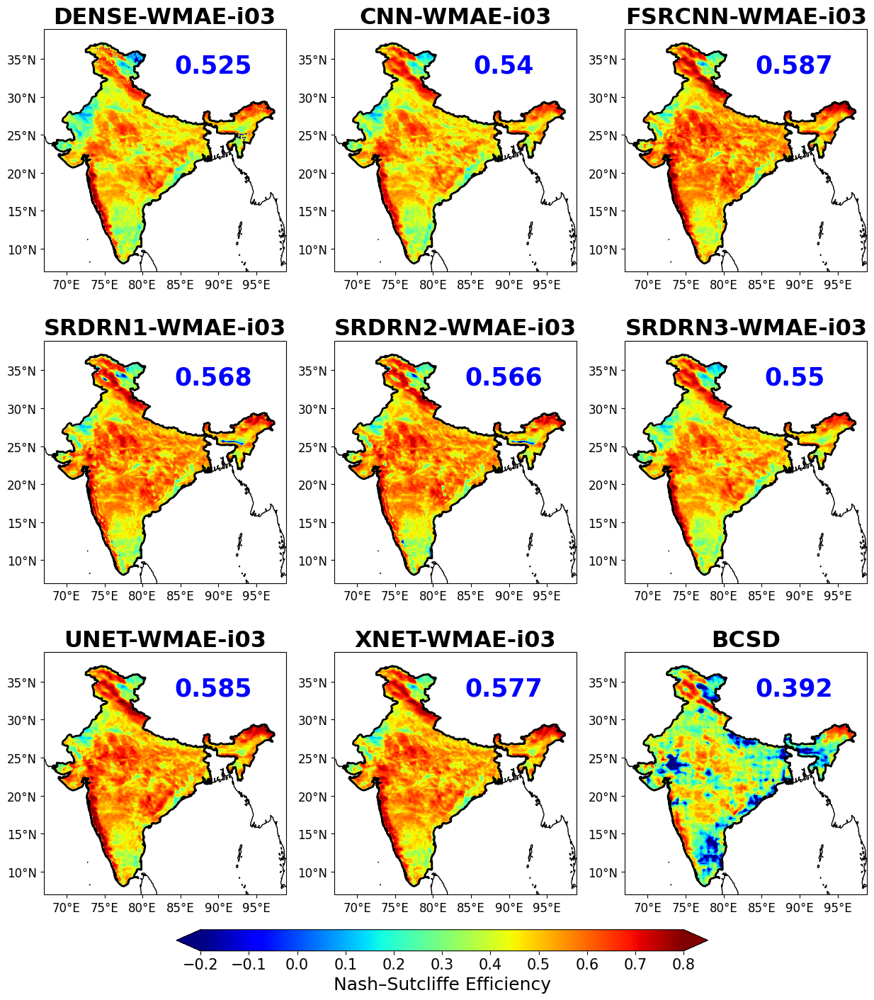

In [55]:
## Masked spatial plots
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import geopandas as gpd
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.patches import PathPatch
import cmaps
from shapely.geometry import box
from matplotlib.gridspec import GridSpec
import matplotlib.patches as patches

#################### Calculate metric value ####################

def abs_mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(abs(arr))
    return arr

def mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(arr)
    return arr

def create_axes(nrows, ncols, figsize=(13,13), hspace=None, wspace=None):
    
    # Create figure and axis objects
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows, ncols, figure=fig, hspace=hspace) #  , wspace=wspace hspace=0.5, wspace=0

    # Create subplots with specific projection using GridSpec
    axes = []
    for i in range(nrows):
        for j in range(ncols):
            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
            axes.append(ax)
    # fig.tight_layout()

    # fig.tight_layout(pad=0) 
    # plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
    return fig, axes

def get_lon_lat(ds, data_var):
    """
    Extract longitude and latitude values from 
    xarray array and variable name
    """
    
    data_coords = ds[data_var].coords
    lon_var, lat_var = None, None

    for coord_name, coord_var in data_coords.items():
        if 'longitude' in coord_var.standard_name or 'lon' in coord_var.standard_name:
            lon_var = coord_var
        elif 'latitude' in coord_var.standard_name or 'lat' in coord_var.standard_name:
            lat_var = coord_var

    return lon_var, lat_var

def filter_df(df, column, string):
    """ Select and merge rows from the dataframe where the specified string is present in the specified column""" 
    filtered_df = df[df[column].str.contains(string, na=False)]
    return filtered_df

def df_to_dict(df, key_col, value_cols):
    """
    Convert multiple columns of a DataFrame into a dictionary with lists of values.
    """
    return df.set_index(key_col)[value_cols].T.to_dict('list')

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray*maskarray

def my_custom_subplot(ax, ds, lonlat, cmap, vmin, vmax, 
                      title=None, ylabel=None, 
                      text=None, text_loc=None, 
                      overlay_pval=False, pval_data=None, 
                     ):
    
    # Plot data ds1 with inverted y-axis
    im = ax.imshow(ds, 
                   cmap=cmap, 
                   alpha=1.0, 
                   vmin=vmin, 
                   vmax=vmax,
                   extent=[lonlat[0].data.min(), 
                           lonlat[0].data.max(),
                           lonlat[1].data.max(),
                           lonlat[1].data.min()], 
                   origin='upper', 
                   transform=ccrs.PlateCarree()
                  )
    # ---------------
    # Add coastlines
    # ---------------
    ax.coastlines(resolution='50m')
    ax.invert_yaxis()
    
    # --------------------
    # Add India shapefile
    # --------------------
    shapefile_path = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES/India.shp"         
    shapefile_df = gpd.read_file(shapefile_path)
    countries = shapefile_df['geometry']
    ax.add_geometries(countries, ccrs.PlateCarree(), facecolor='none', edgecolor='black', linewidth=2)

    # -----------------------
    # Overlay pvalue hatches 
    # -----------------------
    if overlay_pval:

        if pval_data is None:
            raise ValueError('You have asked to plot pval stipples, but no data passed.')
        else:
            significance_threshold = 0.01
            significant_mask = pval_data <= significance_threshold
        

    
        # Overlay hatched polygons for significant correlations
        bbox = box(lonlat[0].data.min(), lonlat[1].data.min(), lonlat[0].data.max(), lonlat[1].data.max())
        for geom in countries:
            if bbox.intersects(geom):
                masked_geom = geom.intersection(bbox)
                if masked_geom.is_empty:
                    continue   
                if significant_mask.sel(longitude=slice(masked_geom.bounds[0], masked_geom.bounds[2]),
                                         latitude=slice(masked_geom.bounds[1], masked_geom.bounds[3])).any():
                    ax.add_geometries([masked_geom], 
                                      ccrs.PlateCarree(), 
                                      facecolor='none', 
                                      edgecolor='k', 
                                      hatch='.', 
                                      linewidth=1)
                    continue
    
    # -------------------------
    # Add text inside the plot
    # -------------------------
    if text is not None:
        ax.text(text_loc[0], text_loc[1], 
                text, 
                transform=ax.transAxes, ha='center', va='center', 
                fontsize=25, fontweight='bold', 
                color='blue', backgroundcolor=None, bbox=None)

    # ------------------------------
    # Additional plot customization
    # ------------------------------
    ax.set_title(title, loc='center', fontsize=23, fontweight='semibold')
    ax.set_ylabel(ylabel, loc='center', fontsize=22, fontweight='semibold')
    ax.set_xticks(np.arange(70, 100, 5), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(10, 40, 5), crs=ccrs.PlateCarree())
    lon_formatter = LongitudeFormatter(zero_direction_label=False)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.tick_params(axis="both", labelsize=12)

    # ax.set_axis_off()
    
    return im


#-----------------------------------------------------------------------
######################## Main run control below ########################
#-----------------------------------------------------------------------

# Create axes for subplots and set lonlat limits
fig, axes = create_axes(nrows=3, ncols=3, figsize=(15,15), hspace=None, wspace=None)
lon_l, lat_l = (70, 98, 5), (10, 38, 5)

# Load datafiles
DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
d = xr.open_dataset(f'{DPATH}/EVAL_METRICS_SPATIAL_v1.nc')
df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")

m = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES/India.nc')

varname = 'NSE'
cbar_label = 'Nash–Sutcliffe Efficiency'

DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")
df = filter_df(df, column='ZONE_NAME', string="INDIA")
df1 = filter_df(df, column='EXP_ID', string="L01_I03")
df2 = filter_df(df, column='EXP_ID', string="C01")
df = pd.concat([df1, df2], ignore_index=True)

exp_dict = df_to_dict(df, key_col="EXP_ID", value_cols=["LABEL", varname])

#-----------------------------------------------------------------------
############################# Edit below ###############################
#-----------------------------------------------------------------------

cmap = 'jet' #cmaps.GMT_panoply
vmin, vmax, inc = -0.2, 0.8, 0.1



for i, (exp_id, (title, metric_val)) in enumerate(exp_dict.items()):
    
    my_var = f'{exp_id}_{varname}'
    ds_f = mask_array(d[my_var].squeeze(), m['mask'].squeeze())
    im = my_custom_subplot(ax=axes[i], 
                    ds=ds_f,
                    lonlat=get_lon_lat(d, my_var), 
                    cmap=cmap, vmin=vmin, vmax=vmax,
                    text= f"{round(metric_val, 3)}", #f"{abs_mean(ds_f.data).round(2)}%", #, %" #, #mean(d[my_var][:].data).round(4),
                    text_loc=[0.7, 0.85],
                    ylabel=None,
                    title=title,
                    overlay_pval=False,
                    pval_data = None #d[f'{exp_id}_PCC_PVAL'],
                    )


#----------------------------------------------------
# Uncomment below code snippet to set horizontal cbar 
#----------------------------------------------------

fig.subplots_adjust(bottom=0.05)
cbar_ax = fig.add_axes([0.25, 0.005, 0.5, 0.02])
cb = fig.colorbar(im, cax=cbar_ax, 
                  ticks=np.arange(vmin, vmax+inc, inc), 
                  orientation="horizontal", 
                  extend='both')
cb.ax.tick_params(labelsize=15)
cb.set_label(cbar_label, 
             rotation = 0, 
             fontsize = 18, 
             fontweight='normal') 

# SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
# plt.savefig(f'{SAVE_PATH}/Figure_SpatialMap_{varname.upper()}.png', 
#             format='png', dpi=600, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()


## Figure 06: Spatial Map of Eval Metrics: PBIAS

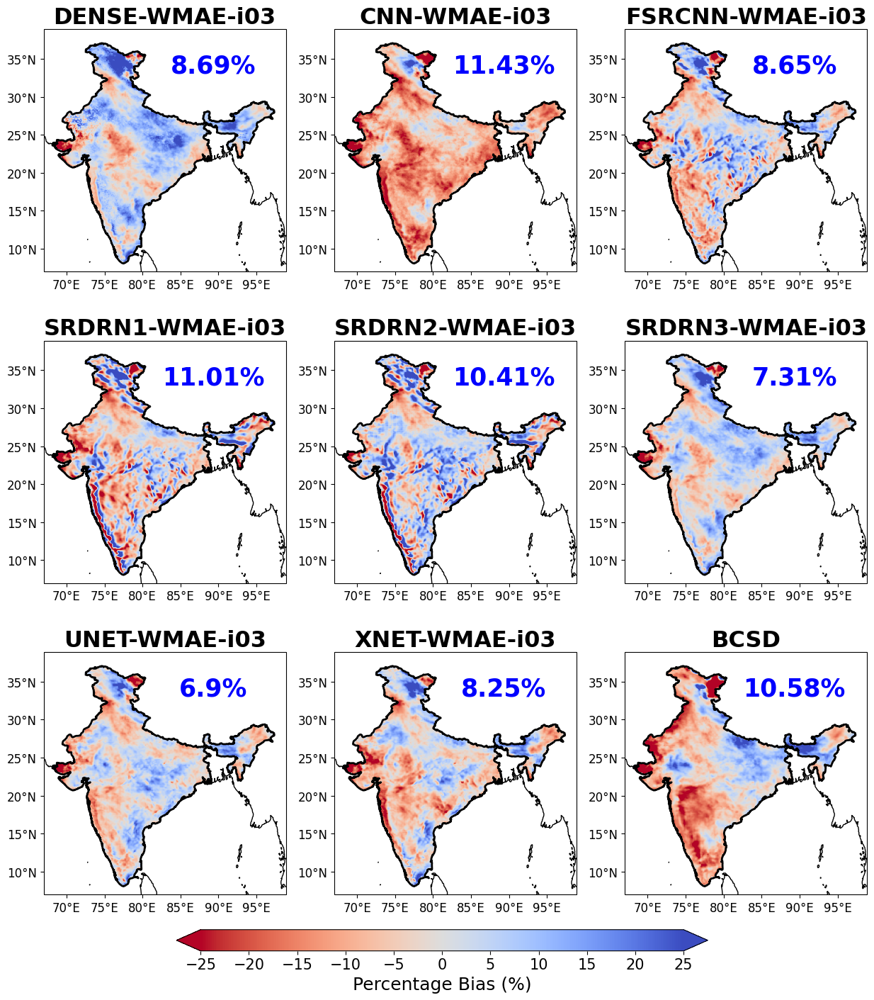

In [141]:
## Masked spatial plots
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import geopandas as gpd
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.patches import PathPatch
import cmaps
from shapely.geometry import box
from matplotlib.gridspec import GridSpec
import matplotlib.patches as patches

#################### Calculate metric value ####################

def abs_mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(abs(arr))
    return arr

def mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(arr)
    return arr

def create_axes(nrows, ncols, figsize=(13,13), hspace=None, wspace=None):
    
    # Create figure and axis objects
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows, ncols, figure=fig, hspace=hspace) #  , wspace=wspace hspace=0.5, wspace=0

    # Create subplots with specific projection using GridSpec
    axes = []
    for i in range(nrows):
        for j in range(ncols):
            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
            axes.append(ax)
    # fig.tight_layout()

    # fig.tight_layout(pad=0) 
    # plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
    return fig, axes

def get_lon_lat(ds, data_var):
    """
    Extract longitude and latitude values from 
    xarray array and variable name
    """
    
    data_coords = ds[data_var].coords
    lon_var, lat_var = None, None

    for coord_name, coord_var in data_coords.items():
        if 'longitude' in coord_var.standard_name or 'lon' in coord_var.standard_name:
            lon_var = coord_var
        elif 'latitude' in coord_var.standard_name or 'lat' in coord_var.standard_name:
            lat_var = coord_var

    return lon_var, lat_var

def filter_df(df, column, string):
    """ Select and merge rows from the dataframe where the specified string is present in the specified column""" 
    filtered_df = df[df[column].str.contains(string, na=False)]
    return filtered_df

def df_to_dict(df, key_col, value_cols):
    """
    Convert multiple columns of a DataFrame into a dictionary with lists of values.
    """
    return df.set_index(key_col)[value_cols].T.to_dict('list')

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray*maskarray

def my_custom_subplot(ax, ds, lonlat, cmap, vmin, vmax, 
                      title=None, ylabel=None, 
                      text=None, text_loc=None, 
                      overlay_pval=False, pval_data=None, 
                     ):
    
    # Plot data ds1 with inverted y-axis
    im = ax.imshow(ds, 
                   cmap=cmap, 
                   alpha=1.0, 
                   vmin=vmin, 
                   vmax=vmax,
                   extent=[lonlat[0].data.min(), 
                           lonlat[0].data.max(),
                           lonlat[1].data.max(),
                           lonlat[1].data.min()], 
                   origin='upper', 
                   transform=ccrs.PlateCarree()
                  )
    # ---------------
    # Add coastlines
    # ---------------
    ax.coastlines(resolution='50m')
    ax.invert_yaxis()
    
    # --------------------
    # Add India shapefile
    # --------------------
    shapefile_path = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES/India.shp"         
    shapefile_df = gpd.read_file(shapefile_path)
    countries = shapefile_df['geometry']
    ax.add_geometries(countries, ccrs.PlateCarree(), facecolor='none', edgecolor='black', linewidth=2)

    # -----------------------
    # Overlay pvalue hatches 
    # -----------------------
    if overlay_pval:

        if pval_data is None:
            raise ValueError('You have asked to plot pval stipples, but no data passed.')
        else:
            significance_threshold = 0.01
            significant_mask = pval_data <= significance_threshold
        

    
        # Overlay hatched polygons for significant correlations
        bbox = box(lonlat[0].data.min(), lonlat[1].data.min(), lonlat[0].data.max(), lonlat[1].data.max())
        for geom in countries:
            if bbox.intersects(geom):
                masked_geom = geom.intersection(bbox)
                if masked_geom.is_empty:
                    continue   
                if significant_mask.sel(longitude=slice(masked_geom.bounds[0], masked_geom.bounds[2]),
                                         latitude=slice(masked_geom.bounds[1], masked_geom.bounds[3])).any():
                    ax.add_geometries([masked_geom], 
                                      ccrs.PlateCarree(), 
                                      facecolor='none', 
                                      edgecolor='k', 
                                      hatch='.', 
                                      linewidth=1)
                    continue
    
    # -------------------------
    # Add text inside the plot
    # -------------------------
    if text is not None:
        ax.text(text_loc[0], text_loc[1], 
                text, 
                transform=ax.transAxes, ha='center', va='center', 
                fontsize=25, fontweight='bold', 
                color='blue', backgroundcolor=None, bbox=None)

    # ------------------------------
    # Additional plot customization
    # ------------------------------
    ax.set_title(title, loc='center', fontsize=23, fontweight='semibold')
    ax.set_ylabel(ylabel, loc='center', fontsize=22, fontweight='semibold')
    ax.set_xticks(np.arange(70, 100, 5), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(10, 40, 5), crs=ccrs.PlateCarree())
    lon_formatter = LongitudeFormatter(zero_direction_label=False)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.tick_params(axis="both", labelsize=12)

    # ax.set_axis_off()
    
    return im


#-----------------------------------------------------------------------
######################## Main run control below ########################
#-----------------------------------------------------------------------

# Create axes for subplots and set lonlat limits
fig, axes = create_axes(nrows=3, ncols=3, figsize=(15,15), hspace=None, wspace=None)
lon_l, lat_l = (70, 98, 5), (10, 38, 5)

# Load datafiles
DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
d = xr.open_dataset(f'{DPATH}/EVAL_METRICS_SPATIAL_v1.nc')
df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")

m = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES/India.nc')

varname = 'PBIAS'
cbar_label = 'Percentage Bias (%)'

DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")
df = filter_df(df, column='ZONE_NAME', string="INDIA")
df1 = filter_df(df, column='EXP_ID', string="L01_I03")
df2 = filter_df(df, column='EXP_ID', string="C01")
df = pd.concat([df1, df2], ignore_index=True)

exp_dict = df_to_dict(df, key_col="EXP_ID", value_cols=["LABEL", varname])

#-----------------------------------------------------------------------
############################# Edit below ###############################
#-----------------------------------------------------------------------

cmap = 'coolwarm_r' #cmaps.GMT_panoply
vmin, vmax, inc = -25, 25, 5



for i, (exp_id, (title, metric_val)) in enumerate(exp_dict.items()):
    
    my_var = f'{exp_id}_{varname}'
    ds_f = mask_array(d[my_var].squeeze(), m['mask'].squeeze())
    im = my_custom_subplot(ax=axes[i], 
                    ds=ds_f,
                    lonlat=get_lon_lat(d, my_var), 
                    cmap=cmap, vmin=vmin, vmax=vmax,
                    text= f"{abs_mean(ds_f.data).round(2)}%", #,f"{round(metric_val, 2)} %" #, #mean(d[my_var][:].data).round(4),
                    text_loc=[0.7, 0.85],
                    ylabel=None,
                    title=title,
                    overlay_pval=False,
                    pval_data = None, #d[f'{exp_id}_TSTAT_PVAL'],
                    )


#----------------------------------------------------
# Uncomment below code snippet to set horizontal cbar 
#----------------------------------------------------

fig.subplots_adjust(bottom=0.05)
cbar_ax = fig.add_axes([0.25, 0.005, 0.5, 0.02])
cb = fig.colorbar(im, cax=cbar_ax, 
                  ticks=np.arange(vmin, vmax+inc, inc), 
                  orientation="horizontal", 
                  extend='both')
cb.ax.tick_params(labelsize=15)
cb.set_label(cbar_label, 
             rotation = 0, 
             fontsize = 18, 
             fontweight='normal') 

SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
plt.savefig(f'{SAVE_PATH}/Figure_SpatialMap_{varname.upper()}.png', 
            format='png', dpi=600, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()


## Figure 05: CSI of >1MM, >95P, >99P

### Prepare the CSVs: calc_eval_binary_scores_table.py

In [53]:
# import os
# import pickle
# import numpy as np
# import pandas as pd
# import xarray as xr
# from tqdm import tqdm


    
# #%% 
# import numpy as np
# import xarray as xr

# def calculate_binary_metrics(obs_events, pred_events):
#     """
#     Calculate binary classification metrics: CSI, POD, FAR, and ETS.

#     Parameters:
#     - obs_events: array-like
#         Array of observed event values (binary).
#     - pred_events: array-like
#         Array of predicted event values (binary).

#     Returns:
#     - CSI: Critical Success Index
#     - POD: Probability of Detection
#     - FAR: False Alarm Rate
#     - ETS: Equitable Threat Score
#     """
#     # Calculate confusion matrix elements
#     TP = np.sum((obs_events == 1) & (pred_events == 1))
#     FP = np.sum((obs_events == 0) & (pred_events == 1))
#     FN = np.sum((obs_events == 1) & (pred_events == 0))
#     TN = np.sum((obs_events == 0) & (pred_events == 0))

#     # Compute metrics
#     CSI = TP / (TP + FP + FN) if (TP + FP + FN) > 0 else 0
#     POD = TP / (TP + FN) if (TP + FN) > 0 else 0
#     FAR = FP / (TP + FP) if (TP + FP) > 0 else 0
    
#     # Calculate ETS
#     total = TP + FP + FN + TN
#     random_hits = ((TP + FN) * (TP + FP)) / total if total > 0 else 0  # Expected hits by chance
#     ETS = (TP - random_hits) / (TP + FP + FN - random_hits) if (TP + FP + FN - random_hits) > 0 else 0

#     return CSI, POD, FAR, ETS, TP, FP, FN, TN 

# def convert_percentile_events_to_binary(ds, ref_ds=None, thresh_ds=None, percentile=99):
#     """
#     Converts values in a dataset to binary based on a threshold derived from a reference dataset
#     or a predefined threshold dataset.
    
#     Parameters:
#     - ds: xarray.Dataset or xarray.DataArray
#         The dataset or data array to be converted to binary.
#     - ref_ds: xarray.Dataset or xarray.DataArray, optional
#         Reference dataset to calculate the threshold from, if `thresh_ds` is not provided.
#     - thresh_ds: xarray.DataArray, optional
#         Predefined threshold dataset to use for conversion. Overrides `ref_ds` and `percentile`.
#     - percentile: float, optional
#         The percentile value to use when calculating the threshold from `ref_ds`. Defaults to 99.

#     Returns:
#     - binary_ds: xarray.DataArray
#         Binary dataset or data array where values above or equal to the threshold are 1, otherwise 0.
#     """
    
#     # Determine the threshold based on precedence
#     if thresh_ds is not None:
#         threshold = thresh_ds
#     elif ref_ds is not None:
#         threshold = ref_ds.quantile(percentile / 100.0, dim='time')
#     else:
#         raise ValueError("Either `ref_ds` or `thresh_ds` must be provided to determine the threshold.")
    
#     # Convert values to binary: 1 for values above or equal to the threshold, 0 otherwise
#     binary_ds = xr.where(ds >= threshold, 1, 0)
    
#     return binary_ds

# def convert_percentile_events_to_binary_pair(ds_true, ds_pred, thresh_ds=None, percentile=99):
#     """
#     Converts values in a dataset to binary based on a threshold.

#     Parameters:
#     - ds: xarray.DataArray
#         Input data to convert to binary.
#     - ref_ds: xarray.DataArray, optional
#         Reference dataset to calculate the threshold.
#     - thresh_ds: xarray.DataArray, optional
#         Provided threshold to use directly.
#     - percentile: int, optional
#         Percentile to use for threshold calculation from `ref_ds` if `thresh_ds` is not provided.

#     Returns:
#     - binary_ds: xarray.DataArray
#         Binary dataset where values are 1 if above threshold, 0 otherwise.
#     """
#     # Determine the threshold based on precedence
#     if thresh_ds is not None:
#         print('Using provided threshold dataset...')
#         threshold = thresh_ds
#     else:
#         print(f'Calculating threshold using the {percentile}th percentile of reference data...')
#         threshold = ds_true.quantile(percentile / 100.0, dim='time')
    
#     # Convert values to binary: 1 for values above or equal to the threshold, 0 otherwise
#     true_binary_ds = xr.where(ds_true >= threshold, 1, 0)
#     pred_binary_ds = xr.where(ds_pred >= threshold, 1, 0)
    
#     return true_binary_ds, pred_binary_ds

# def convert_threshold_events_to_binary(ds, threshold=1):
#     """
#     Converts values in a dataset to binary based on a threshold.
#     """
    
#     # Convert values to binary: 1 for values above or equal to the threshold, 0 otherwise
#     binary_ds = xr.where(ds >= threshold, 1, 0)

#     return binary_ds

# def convert_threshold_events_to_binary_pair(ds_true, ds_pred, threshold=1):
#     """
#     Converts values in a dataset to binary based on a threshold.
#     """
    
#     # Convert values to binary: 1 for values above or equal to the threshold, 0 otherwise
#     true_binary_ds = xr.where(ds_true >= threshold, 1, 0)
#     pred_binary_ds = xr.where(ds_pred >= threshold, 1, 0)
    
#     return true_binary_ds, pred_binary_ds


# def mask_array(dataarray, maskarray):
#     """
#     Masks an xarray.DataArray using a provided mask array.

#     Parameters:
#     - dataarray: xarray.DataArray
#         Data to apply the mask to.
#     - maskarray: xarray.DataArray or numpy.ndarray
#         The mask array. Values of 1 will keep the data, and values of 0 will mask them.

#     Returns:
#     - masked_data: xarray.DataArray
#         Masked data array.
#     """
#     if isinstance(maskarray, xr.DataArray):
#         maskarray = maskarray.values

#     if dataarray.shape[1:3] != maskarray.shape[1:3]:
#         raise ValueError("Data array and mask array must have the same shape in the latitude and longitude dimensions.")
    
#     return dataarray * maskarray


# def calculate_binary_scores(true_binary_arr, pred_binary_arr):

#     """
#     Calculates binary evaluation metrics (CSI, POD, FAR, ETS) between observed and predicted binary datasets.

#     """
#     observed = true_binary_arr.flatten()
#     predicted = pred_binary_arr.flatten()

#     # Remove NaN values
#     valid_mask = np.isfinite(observed) & np.isfinite(predicted)
#     observed = observed[valid_mask]
#     predicted = predicted[valid_mask]

#     # Ensure observed and predicted have the same shape after NaN removal
#     assert observed.shape == predicted.shape, "Observed and predicted arrays must have the same shape after NaN removal."
#     print(f"\tObserved shape: {observed.shape}\n\tPredicted shape: {predicted.shape}")

#     # Calculate binary metrics
#     CSI, POD, FAR, ETS, TP, FP, FN, TN = calculate_binary_metrics(observed, predicted)

#     # Prepare and return the result dictionary
#     return {
#         "POD": POD,
#         "FAR": FAR,
#         "CSI": CSI,
#         "ETS": ETS,
#         "TP": TP,
#         "FP": FP,
#         "FN": FN,
#         "TN": TN,
#     }

# def make_percentile_events_scores_table(data_dict,
#                                         percentile_thresh=99,
#                                         mask_dict=None, 
#                                         suffix='OK', 
#                                         csv_save_path = '.'
#                                         ):

#     if mask_dict is not None:
        
#         results = []
        
#         for zone, (zone_mask_path, zone_name) in mask_dict.items():
    
#             print(f'\nCalculating metrics for ... {zone}: {zone_name}')
#             print(f'Loading ... {zone_mask_path}')
            
#             mask = xr.open_dataset(zone_mask_path).mask
#             y_true = y_true_ref = xr.open_dataset(data_dict['REF'][0])

#             y_true = convert_percentile_events_to_binary(y_true, ref_ds=y_true, thresh_ds=None, percentile=percentile_thresh)
#             y_true = mask_array(y_true['prec'], mask)
#             y_true = y_true.data.squeeze()
            
#             for exp_id, (exp_data_path, label) in data_dict.items():
            
#                 if exp_id=='REF':
#                     continue
            
#                 else:
#                     print(f'\n\tCalculating metrics for ... {exp_id}: {label}')
#                     print(f'\tLoading ... {exp_data_path}')
                    
#                     y_pred = xr.open_dataset(exp_data_path)
#                     y_pred = convert_percentile_events_to_binary(y_pred, ref_ds=y_true_ref, thresh_ds=None, percentile=percentile_thresh)
#                     y_pred = mask_array(y_pred['prec'], mask)
#                     y_pred = y_pred.data.squeeze()

                    
#                     metrics_values = calculate_binary_scores(y_true, y_pred)
        
#                     # Round metrics to the desired decimal place
#                     rounded_metrics_values = {key: round(value, 8) for key, value in metrics_values.items()}
    
#                     value = metrics_values['ETS']
#                     print(f'\tETS: {value}')
                    
#                     # Append results to the list
#                     results.append([zone, zone_name, exp_id, label] + list(rounded_metrics_values.values()))
            
#         # Give headers to CSV file
#         header = ['ZONE', 'ZONE_NAME', 'EXP_ID', 'LABEL'] + list(rounded_metrics_values.keys())

#         #################### SAVE RESULTS ####################
    
#         # Convert the results to a DataFrame
#         df = pd.DataFrame(results, columns=header)
        
#         print("\nFinal Results:")
#         print(df.to_string(index=False))

#         csv_name = f'TABLE_EVALMETRICS_{suffix}.csv'
#         df.to_csv(f'{csv_save_path}/{csv_name}', index=False)
        
#         print(f'\nResults saved at {csv_save_path}/{csv_name}')

#     # else:
#     #     make_eval_table_generic(data_dict, suffix=suffix, csv_save_path = csv_save_path)
        
# def make_threshold_events_scores_table(data_dict,
#                                         threshold=1,
#                                         mask_dict=None, 
#                                         suffix='OK', 
#                                         csv_save_path = '.'
#                                         ):

#     if mask_dict is not None:
        
#         results = []
        
#         for zone, (zone_mask_path, zone_name) in mask_dict.items():
    
#             print(f'\nCalculating metrics for ... {zone}: {zone_name}')
#             print(f'Loading ... {zone_mask_path}')
            
#             mask = xr.open_dataset(zone_mask_path).mask
#             y_true = y_true_ref = xr.open_dataset(data_dict['REF'][0])

#             y_true = convert_threshold_events_to_binary(y_true, threshold)
#             y_true = mask_array(y_true['prec'], mask)
#             y_true = y_true.data.squeeze()
            
#             for exp_id, (exp_data_path, label) in data_dict.items():
            
#                 if exp_id=='REF':
#                     continue
            
#                 else:
#                     print(f'\n\tCalculating metrics for ... {exp_id}: {label}')
#                     print(f'\tLoading ... {exp_data_path}')
                    
#                     y_pred = xr.open_dataset(exp_data_path)
#                     y_pred = convert_threshold_events_to_binary(y_pred, threshold)
#                     y_pred = mask_array(y_pred['prec'], mask)
#                     y_pred = y_pred.data.squeeze()

                    
#                     metrics_values = calculate_binary_scores(y_true, y_pred)
        
#                     # Round metrics to the desired decimal place
#                     rounded_metrics_values = {key: round(value, 8) for key, value in metrics_values.items()}
    
#                     value = metrics_values['ETS']
#                     print(f'\tETS: {value}')
                    
#                     # Append results to the list
#                     results.append([zone, zone_name, exp_id, label] + list(rounded_metrics_values.values()))
            
#         # Give headers to CSV file
#         header = ['ZONE', 'ZONE_NAME', 'EXP_ID', 'LABEL'] + list(rounded_metrics_values.keys())

#         #################### SAVE RESULTS ####################
    
#         # Convert the results to a DataFrame
#         df = pd.DataFrame(results, columns=header)
        
#         print("\nFinal Results:")
#         print(df.to_string(index=False))

#         csv_name = f'TABLE_EVALMETRICS_{suffix}.csv'
#         df.to_csv(f'{csv_save_path}/{csv_name}', index=False)
        
#         print(f'\nResults saved at {csv_save_path}/{csv_name}')

#     # else:
#     #     make_eval_table_generic(data_dict, suffix=suffix, csv_save_path = csv_save_path)

# #%% Calculte and save csv.


# DATA_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/GENDATA"
# data_dict = {  
    
#     'REF': [f'{DATA_PATH}/ref_imda_012_data.nc', 'IMDAA'],
    
#     'N01_L01_I01': [f'{DATA_PATH}/p07a_n01_l01_i01_b01_r01_012_out.nc', 'DENSE-WMAE-i01'  ],
#     'N01_L01_I02': [f'{DATA_PATH}/p07a_n01_l01_i02_b01_r01_012_out.nc', 'DENSE-WMAE-i02'  ],
#     'N01_L01_I03': [f'{DATA_PATH}/p07a_n01_l01_i03_b01_r01_012_out.nc', 'DENSE-WMAE-i03'  ],
#     'N01_L02_I01': [f'{DATA_PATH}/p07a_n01_l02_i01_b01_r01_012_out.nc', 'DENSE-GAMMA-i01' ],
#     'N01_L02_I02': [f'{DATA_PATH}/p07a_n01_l02_i02_b01_r01_012_out.nc', 'DENSE-GAMMA-i02' ],
#     'N01_L02_I03': [f'{DATA_PATH}/p07a_n01_l02_i03_b01_r01_012_out.nc', 'DENSE-GAMMA-i03' ],

#     'N02_L01_I01': [f'{DATA_PATH}/p07a_n02_l01_i01_b01_r01_012_out.nc', 'CNN-WMAE-i01'    ],
#     'N02_L01_I02': [f'{DATA_PATH}/p07a_n02_l01_i02_b01_r01_012_out.nc', 'CNN-WMAE-i02'    ],
#     'N02_L01_I03': [f'{DATA_PATH}/p07a_n02_l01_i03_b01_r01_012_out.nc', 'CNN-WMAE-i03'    ],
#     'N02_L02_I01': [f'{DATA_PATH}/p07a_n02_l02_i01_b01_r01_012_out.nc', 'CNN-GAMMA-i01'   ],
#     'N02_L02_I02': [f'{DATA_PATH}/p07a_n02_l02_i02_b01_r01_012_out.nc', 'CNN-GAMMA-i02'   ],
#     'N02_L02_I03': [f'{DATA_PATH}/p07a_n02_l02_i03_b01_r01_012_out.nc', 'CNN-GAMMA-i03'   ],
    
#     'N03_L01_I01': [f'{DATA_PATH}/p07a_n03_l01_i01_b01_r01_012_out.nc', 'FSRCNN-WMAE-i01' ],
#     'N03_L01_I02': [f'{DATA_PATH}/p07a_n03_l01_i02_b01_r01_012_out.nc', 'FSRCNN-WMAE-i02' ],
#     'N03_L01_I03': [f'{DATA_PATH}/p07a_n03_l01_i03_b01_r01_012_out.nc', 'FSRCNN-WMAE-i03' ],
#     'N03_L02_I01': [f'{DATA_PATH}/p07a_n03_l02_i01_b01_r01_012_out.nc', 'FSRCNN-GAMMA-i01'],
#     'N03_L02_I02': [f'{DATA_PATH}/p07a_n03_l02_i02_b01_r01_012_out.nc', 'FSRCNN-GAMMA-i02'],
#     'N03_L02_I03': [f'{DATA_PATH}/p07a_n03_l02_i03_b01_r01_012_out.nc', 'FSRCNN-GAMMA-i03'],

#     'S01_L01_I01': [f'{DATA_PATH}/p07a_s01_l01_i01_b01_r01_012_out.nc', 'SRDRN1-WMAE-i01' ],
#     'S01_L01_I02': [f'{DATA_PATH}/p07a_s01_l01_i02_b01_r01_012_out.nc', 'SRDRN1-WMAE-i02' ],
#     'S01_L01_I03': [f'{DATA_PATH}/p07a_s01_l01_i03_b01_r01_012_out.nc', 'SRDRN1-WMAE-i03' ],
#     'S01_L02_I01': [f'{DATA_PATH}/p07a_s01_l02_i01_b01_r01_012_out.nc', 'SRDRN1-GAMMA-i01'],
#     'S01_L02_I02': [f'{DATA_PATH}/p07a_s01_l02_i02_b01_r01_012_out.nc', 'SRDRN1-GAMMA-i02'],
#     'S01_L02_I03': [f'{DATA_PATH}/p07a_s01_l02_i03_b01_r01_012_out.nc', 'SRDRN1-GAMMA-i03'],
    
#     'S02_L01_I01': [f'{DATA_PATH}/p07a_s02_l01_i01_b01_r01_012_out.nc', 'SRDRN2-WMAE-i01' ],
#     'S02_L01_I02': [f'{DATA_PATH}/p07a_s02_l01_i02_b01_r01_012_out.nc', 'SRDRN2-WMAE-i02' ],
#     'S02_L01_I03': [f'{DATA_PATH}/p07a_s02_l01_i03_b01_r01_012_out.nc', 'SRDRN2-WMAE-i03' ],
#     'S02_L02_I01': [f'{DATA_PATH}/p07a_s02_l02_i01_b01_r01_012_out.nc', 'SRDRN2-GAMMA-i01'],
#     'S02_L02_I02': [f'{DATA_PATH}/p07a_s02_l02_i02_b01_r01_012_out.nc', 'SRDRN2-GAMMA-i02'],
#     'S02_L02_I03': [f'{DATA_PATH}/p07a_s02_l02_i03_b01_r01_012_out.nc', 'SRDRN2-GAMMA-i03'],

#     'S03_L01_I01': [f'{DATA_PATH}/p07a_s03_l01_i01_b01_r01_012_out.nc', 'SRDRN3-WMAE-i01' ],
#     'S03_L01_I02': [f'{DATA_PATH}/p07a_s03_l01_i02_b01_r01_012_out.nc', 'SRDRN3-WMAE-i02' ],
#     'S03_L01_I03': [f'{DATA_PATH}/p07a_s03_l01_i03_b01_r01_012_out.nc', 'SRDRN3-WMAE-i03' ],
#     'S03_L02_I01': [f'{DATA_PATH}/p07a_s03_l02_i01_b01_r01_012_out.nc', 'SRDRN3-GAMMA-i01'],
#     'S03_L02_I02': [f'{DATA_PATH}/p07a_s03_l02_i02_b01_r01_012_out.nc', 'SRDRN3-GAMMA-i02'],
#     'S03_L02_I03': [f'{DATA_PATH}/p07a_s03_l02_i03_b01_r01_012_out.nc', 'SRDRN3-GAMMA-i03'],

#     'U01_L01_I01': [f'{DATA_PATH}/p07a_u01_l01_i01_b01_r01_012_out.nc', 'UNET-WMAE-i01'   ],
#     'U01_L01_I02': [f'{DATA_PATH}/p07a_u01_l01_i02_b01_r01_012_out.nc', 'UNET-WMAE-i02'   ],
#     'U01_L01_I03': [f'{DATA_PATH}/p07a_u01_l01_i03_b01_r01_012_out.nc', 'UNET-WMAE-i03'   ],
#     'U01_L02_I01': [f'{DATA_PATH}/p07a_u01_l02_i01_b01_r01_012_out.nc', 'UNET-GAMMA-i01'  ],
#     'U01_L02_I02': [f'{DATA_PATH}/p07a_u01_l02_i02_b01_r01_012_out.nc', 'UNET-GAMMA-i02'  ],
#     'U01_L02_I03': [f'{DATA_PATH}/p07a_u01_l02_i03_b01_r01_012_out.nc', 'UNET-GAMMA-i03'  ],

#     'U02_L01_I01': [f'{DATA_PATH}/p07a_u02_l01_i01_b01_r01_012_out.nc', 'XNET-WMAE-i01'   ],
#     'U02_L01_I02': [f'{DATA_PATH}/p07a_u02_l01_i02_b01_r01_012_out.nc', 'XNET-WMAE-i02'   ],
#     'U02_L01_I03': [f'{DATA_PATH}/p07a_u02_l01_i03_b01_r01_012_out.nc', 'XNET-WMAE-i03'   ],
#     'U02_L02_I01': [f'{DATA_PATH}/p07a_u02_l02_i01_b01_r01_012_out.nc', 'XNET-GAMMA-i01'  ],
#     'U02_L02_I02': [f'{DATA_PATH}/p07a_u02_l02_i02_b01_r01_012_out.nc', 'XNET-GAMMA-i02'  ],
#     'U02_L02_I03': [f'{DATA_PATH}/p07a_u02_l02_i03_b01_r01_012_out.nc', 'XNET-GAMMA-i03'  ],

#     'C01': [f'{DATA_PATH}/c01_quantile_mapping_disagregated_out.nc' , 'BCSD'],

#     }

# MASK_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES"
# mask_dict = {
#     'IND': [f'{MASK_PATH}/India.nc'             , 'INDIA'], 
#     # 'MCZ': [f'{MASK_PATH}/Monsoon_Core_Zone.nc' , 'MONSOON CORE ZONE'], 
#     # 'WG' : [f'{MASK_PATH}/Western_Ghats.nc'     , 'WESTERN GHATS'], 
#     # 'SP' : [f'{MASK_PATH}/South_Peninsular.nc'  , 'SOUTHERN PENINSULA'], 
#     # 'CNE': [f'{MASK_PATH}/Central_Northeast.nc' , 'CENTRAL NORTHEAST'], 
#     # 'NE' : [f'{MASK_PATH}/Northeast.nc'         , 'NORTHEAST'], 
#     # 'WC' : [f'{MASK_PATH}/West_Central.nc'      , 'WEST CENTRAL'], 
#     # 'NW' : [f'{MASK_PATH}/Northwest.nc'         , 'NORTHWEST'], 
#     # 'HIM': [f'{MASK_PATH}/Himalaya.nc'          , 'THE HIMALAYAS'], 
#     # 'HR' : [f'{MASK_PATH}/Hilly_Regions.nc'     , 'HILLY REGION'],
#  }

# SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

# if __name__ == "__main__":
#     # make_percentile_events_scores_table(data_dict,
#     #                                     percentile_thresh=99,
#     #                                     mask_dict=mask_dict, 
#     #                                     suffix='BINARY_METRICS_IND_A99P_v1', 
#     #                                     csv_save_path = SAVE_PATH
#     #                                     )
    
#     # make_percentile_events_scores_table(data_dict,
#     #                                     percentile_thresh=95,
#     #                                     mask_dict=mask_dict, 
#     #                                     suffix='BINARY_METRICS_IND_A95P_v1', 
#     #                                     csv_save_path = SAVE_PATH
#                                         # )
    
#     make_threshold_events_scores_table(data_dict,
#                                         threshold=1,
#                                         mask_dict=mask_dict, 
#                                         suffix='BINARY_METRICS_IND_A1MM_v1', 
#                                         csv_save_path = SAVE_PATH
#                                         )




### Plot the Diagram

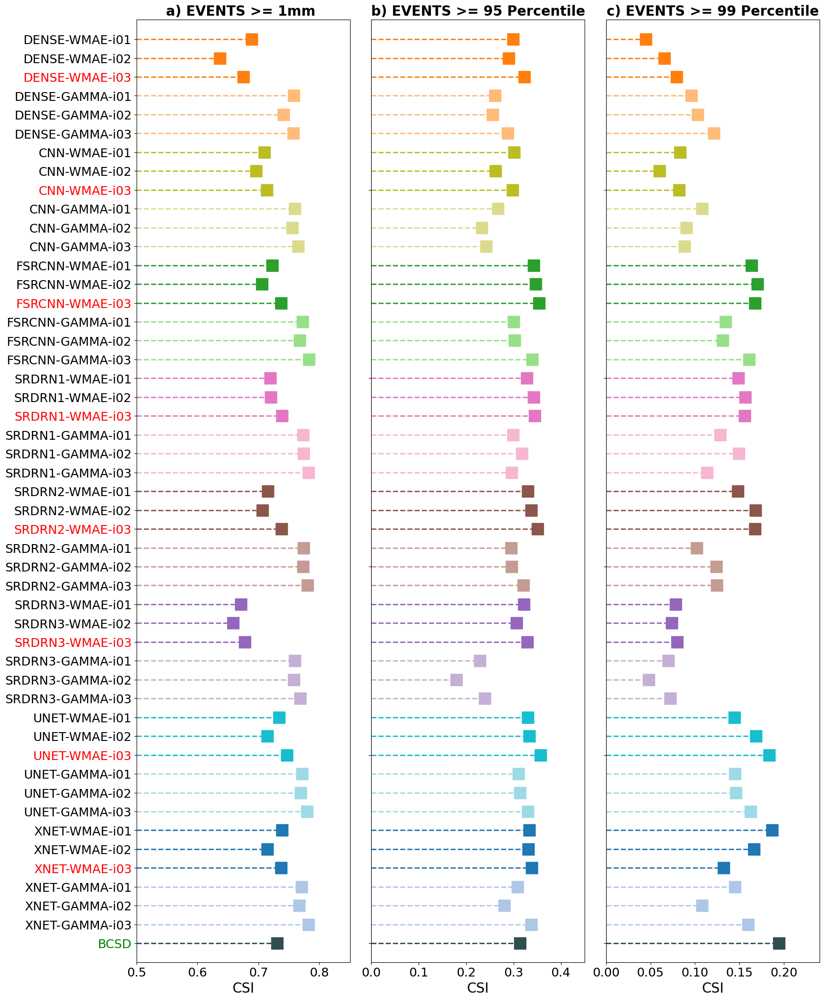

In [57]:
import pandas as pd
import matplotlib.pyplot as plt

def filter_df(df, column, string):
    """Select and merge rows from the dataframe where the specified string is present in the specified column."""
    return df[df[column].str.contains(string, na=False)]

def plot_hstems(ax, df, metric_name="PCC", xlabel=None, xlim=(None, None), title='Metric Markers', yticks_off=False, ref_val=0):
    
    # Reverse the order of rows
    df = df.iloc[::-1]
    
    # Marker colors
    marker_colors = [
        "#2F4F4F",
        "#aec7e8", "#aec7e8", "#aec7e8", "#1f77b4", "#1f77b4", "#1f77b4",  # Blue pair
        "#9edae5", "#9edae5", "#9edae5", "#17becf", "#17becf", "#17becf",  # Teal pair 
        "#c5b0d5", "#c5b0d5", "#c5b0d5", "#9467bd", "#9467bd", "#9467bd",  # Purple pair
        "#c49c94", "#c49c94", "#c49c94", "#8c564b", "#8c564b", "#8c564b",  # Brown pair
        "#f7b6d2", "#f7b6d2", "#f7b6d2", "#e377c2", "#e377c2", "#e377c2",  # Pink pair
        "#98df8a", "#98df8a", "#98df8a", "#2ca02c", "#2ca02c", "#2ca02c",  # Green pair
        "#dbdb8d", "#dbdb8d", "#dbdb8d", "#bcbd22", "#bcbd22", "#bcbd22",  # Yellow-green pair
        "#ffbb78", "#ffbb78", "#ffbb78", "#ff7f0e", "#ff7f0e", "#ff7f0e",  # Orange pair
    ]
    
    ax.grid(False)

    if ref_val is not None:
        ax.axvline(x=ref_val, color='grey', linestyle='--', linewidth=1)

    # Plot stems and markers individually
    for i, (label, value, color) in enumerate(zip(df['LABEL'], df[metric_name], marker_colors)):
        ax.plot([0, value], [i, i], color=color, linewidth=2, linestyle='--', zorder=2)
        ax.plot(value, i, marker='s', markersize=17, color=color, markeredgecolor=color, zorder=2)

    if yticks_off:
        ax.tick_params(axis='y', which='both', labelleft=False)
    else:
        # Set custom y-ticks and labels
        ax.set_yticks(range(len(df)))
        ax.set_yticklabels(df['LABEL'])
        
    # Labels and title
    ax.tick_params(axis='both', labelsize=18)  # Set x tick size
    ax.set_xlabel(metric_name if xlabel is None else xlabel, fontsize=20, fontweight='normal')
    ax.set_title(title, fontsize=20, fontweight='bold')
    ax.set_xlim(xlim[0], xlim[1])
   
    # Change the color of ytick if label is "WMAE-i03"
    for label in ax.get_yticklabels():
        if "WMAE-i03" in label.get_text():
            label.set_color("red")
        if "BCSD" in label.get_text():
            label.set_color("green")

    ax.set_ylim(-1, len(df) + 0.05)
#####################################################################################################
# File paths and loading data
DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

fig, axs = plt.subplots(1, 3, figsize=(18, 25), gridspec_kw={'wspace': 0.1, 'hspace': 0.15}) 

# Load and filter data
df1 = pd.read_csv(f'{DPATH}/TABLE_EVALMETRICS_BINARY_METRICS_IND_A1MM_v1.csv')
df2 = pd.read_csv(f'{DPATH}/TABLE_EVALMETRICS_BINARY_METRICS_IND_A95P_v1.csv')
df3 = pd.read_csv(f'{DPATH}/TABLE_EVALMETRICS_BINARY_METRICS_IND_A99P_v1.csv')
df1 = filter_df(df1, column='ZONE_NAME', string="INDIA")

# Plotting with markers
plot_hstems(axs[0], df1, metric_name="CSI", title='a) EVENTS >= 1mm ', xlim=(0.5, 0.85))
plot_hstems(axs[1], df2, metric_name="CSI", title='b) EVENTS >= 95 Percentile', xlim=(0, 0.45), yticks_off=True)
plot_hstems(axs[2], df3, metric_name="CSI", title='c) EVENTS >= 99 Percentile', xlim=(0, 0.24), yticks_off=True)

# SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
# plt.savefig(f'{SAVE_PATH}/Figure_CSI_StemPlots.png', 
#             format='png', dpi=600, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()


## Figure 08: MultiBar Plot of Homogeneous Zones

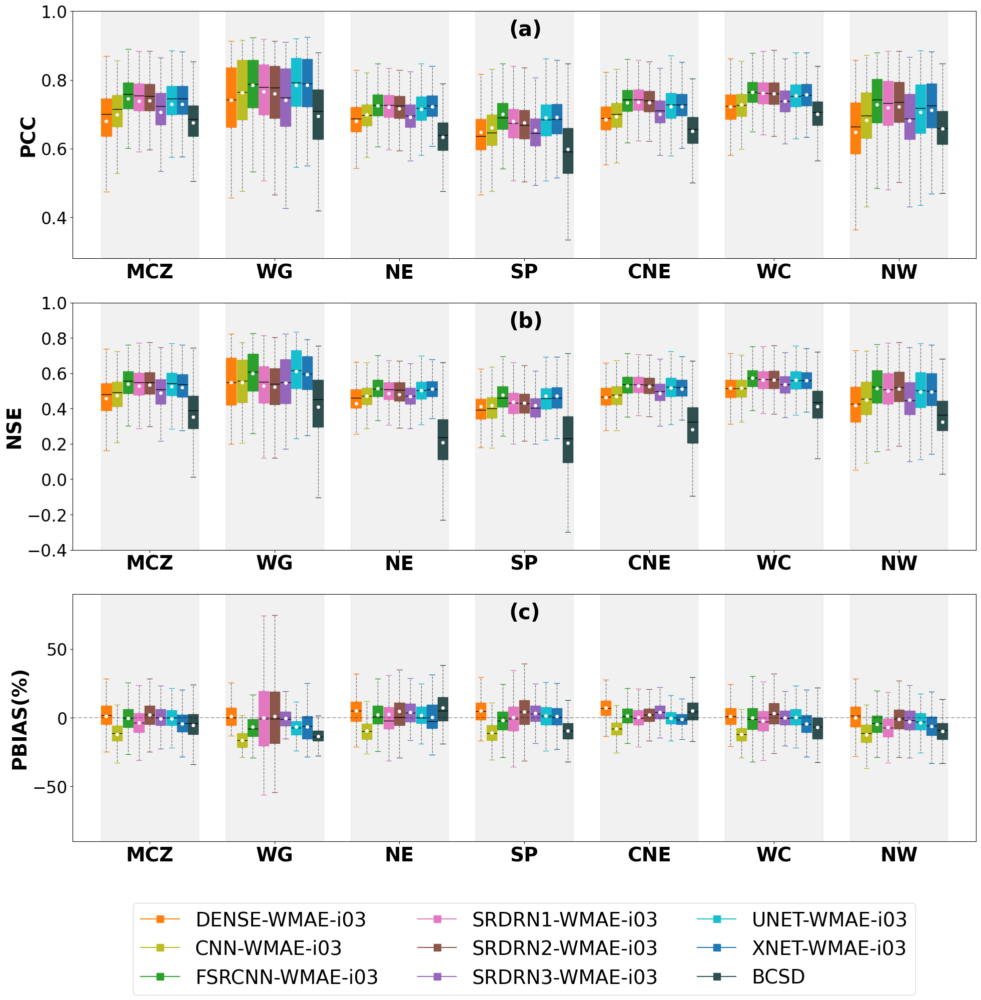

In [78]:
import pandas as pd
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt

def custom_masker(mask_path, data_ds, model_id, metric_name='KGE'):
    """Mask an xarray dataarray"""
    dataarray = data_ds[f'{model_id}_{metric_name}'].squeeze()
    maskarray = xr.open_dataset(mask_path).mask.squeeze()
    
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape != maskarray.shape:
        raise ValueError("dataarray and maskarray must have the same shape")
        
    masked_array = (dataarray * maskarray).data.flatten()
    masked_array = masked_array[~np.isnan(masked_array)]
    return masked_array

def plot_multibar(data_ds, data_dict, zones_dict, metric_name='KGE', metric_label='KGE', best_val_line=None, ylim=(None, None), 
                  show_legend=False, ax=None):
    # Load and mask data for each zone and model
    data_load = {zone: pd.DataFrame({model_label: custom_masker(zone_mask_path, data_ds, model_id, metric_name) 
                                     for model_id, model_label in data_dict.items()}) 
                 for zone, (zone_mask_path, zone_label) in zones_dict.items()}
    
    # Extract the data into a format suitable for boxplotting
    boxplot_data = []
    positions = []
    pos = 0
    zone_labels = []
    
    for zone in zones_dict.keys():
        for model in data_dict.keys():
            boxplot_data.append(data_load[zone][data_dict[model]])
            positions.append(pos)
            pos += 0.16
        zone_labels.append((positions[-len(data_dict)] + positions[-1]) / 2)  # Position the zone label in the middle of the models
        pos += 0.4  # Add extra space between different zones

    if ax is None:
        fig, ax = plt.subplots(figsize=(20, 4))
        
    # Define colors for each model
    # colors = plt.get_cmap('tab10', len(data_dict))
    # colors = ["#ffbb78","#dbdb8d","#98df8a","#f7b6d2","#c49c94","#c5b0d5","#9edae5","#aec7e8","#2F4F4F"]

    colors = [
        "#ff7f0e",  # Orange pair
        "#bcbd22",  # Yellow-green pair
        "#2ca02c",  # Green pair
        "#e377c2",  # Pink pair
        "#8c564b",  # Brown pair
        "#9467bd",  # Purple pair
        "#17becf",  # Teal pair
        "#1f77b4",  # Blue pair
        "#2F4F4F",
    ]

    # Shade background for intermittent x-tick groups
    for i in range(0, len(positions), len(data_dict)):
        start_pos = positions[i] - 0.08
        end_pos = positions[i + len(data_dict) - 1] + 0.08
        ax.axvspan(start_pos, end_pos, color='lightgrey', alpha=0.3)
    
    # Create the boxplots
    for i, (data, position) in enumerate(zip(boxplot_data, positions)):
        ax.boxplot(data, positions=[position], showfliers=False, widths=0.15, patch_artist=True,
                   showmeans=True,
                   boxprops=dict(facecolor=colors[i % len(data_dict)], color=colors[i % len(data_dict)]),
                   capprops=dict(color=colors[i % len(data_dict)]),
                   whiskerprops=dict(visible=True,  linestyle='--', alpha=0.5),
                   flierprops=dict(markeredgecolor=colors[i % len(data_dict)]),
                   medianprops=dict(color='black'),
                   meanprops=dict(marker='o', markerfacecolor='white', markeredgecolor=colors[i % len(data_dict)]))

    
    # Customize the plot
    ax.set_ylabel(metric_label, fontsize=20, fontweight="semibold")
    ax.tick_params(axis='y', labelsize=24)
    ax.tick_params(axis='x', labelsize=24)
    ax.set_ylim(ylim[0], ylim[1])
    
    # Set x-ticks and labels
    ax.set_xticks(zone_labels)
    ax.set_xticklabels(zones_dict.keys(), rotation=0, fontsize=28, fontweight='bold')
    ax.set_ylabel(metric_label, fontsize=28, fontweight='bold')
    
    # Add a legend for the models
    handles = [plt.Line2D([0], [0], color=colors[i], marker='s', markersize=10, markerfacecolor=colors[i], 
                          label=model) for i, model in enumerate(data_dict.values())]

    if show_legend:
        ax.legend(handles=handles, loc='upper center', fontsize=28, ncol=3, bbox_to_anchor=(0.5, -0.21))
    if best_val_line is not None:
        ax.axhline(y=best_val_line, color='k', linestyle='--', alpha=0.3)

#######################################################################################################################

# Create a 4x1 grid of subplots
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(20, 20))

MASK_PATH = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES'
zones_dict = {
     # 'IND': [f'{MASK_PATH}/India.nc', 'INDIA'], 
    'MCZ': [f'{MASK_PATH}/Monsoon_Core_Zone.nc', 'MONSOON CORE ZONE'], 
    'WG' : [f'{MASK_PATH}/Western_Ghats.nc' , 'WESTERN GHATS'],
    'NE' : [f'{MASK_PATH}/Northeast.nc' , 'NORTHEAST'], 
    'SP' : [f'{MASK_PATH}/South_Peninsular.nc' , 'SOUTHERN PENINSULA'], 
    'CNE': [f'{MASK_PATH}/Central_Northeast.nc', 'CENTRAL NORTHEAST'],   
    'WC' : [f'{MASK_PATH}/West_Central.nc' , 'WEST CENTRAL'], 
    'NW' : [f'{MASK_PATH}/Northwest.nc' , 'NORTHWEST'], 
}

index_dict = {

    'N01_L01_I03': 	'DENSE-WMAE-i03', 
    'N02_L01_I03': 	'CNN-WMAE-i03', 
    'N03_L01_I03': 	'FSRCNN-WMAE-i03',  
    'S01_L01_I03': 	'SRDRN1-WMAE-i03', 
    'S02_L01_I03': 	'SRDRN2-WMAE-i03', 
    'S03_L01_I03': 	'SRDRN3-WMAE-i03',  
    'U01_L01_I03': 	'UNET-WMAE-i03', 
    'U02_L01_I03': 	'XNET-WMAE-i03', 
    'C01'        :  'BCSD',
    
}


data_ds = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/EVAL_METRICS_SPATIAL_v1.nc')

# Plotting
plot_multibar(data_ds, index_dict, zones_dict, metric_name='PCC', metric_label='PCC', best_val_line=1, ylim=(0.28, 1), show_legend=False, ax=axs[0])
plot_multibar(data_ds, index_dict, zones_dict, metric_name='NSE', metric_label='NSE', best_val_line=1, ylim=(-0.4, 1), show_legend=False, ax=axs[1])
plot_multibar(data_ds, index_dict, zones_dict, metric_name='PBIAS', metric_label='PBIAS(%)',  best_val_line=0, ylim=(-90, 90), show_legend=True, ax=axs[2])

# Add labels for each subplot
mark_list = ['(a)', '(b)', '(c)']
for i, mark in enumerate(mark_list):
    axs[i].text(0.483, 0.9, mark, transform=axs[i].transAxes, fontsize=30, color='k', fontweight='bold')

# Adjust layout
plt.tight_layout(h_pad=2)

# SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
# plt.savefig(f'{SAVE_PATH}/Figure_MultiBox_Plot_Zones.png', 
#             format='png', dpi=600, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()

## Figure 

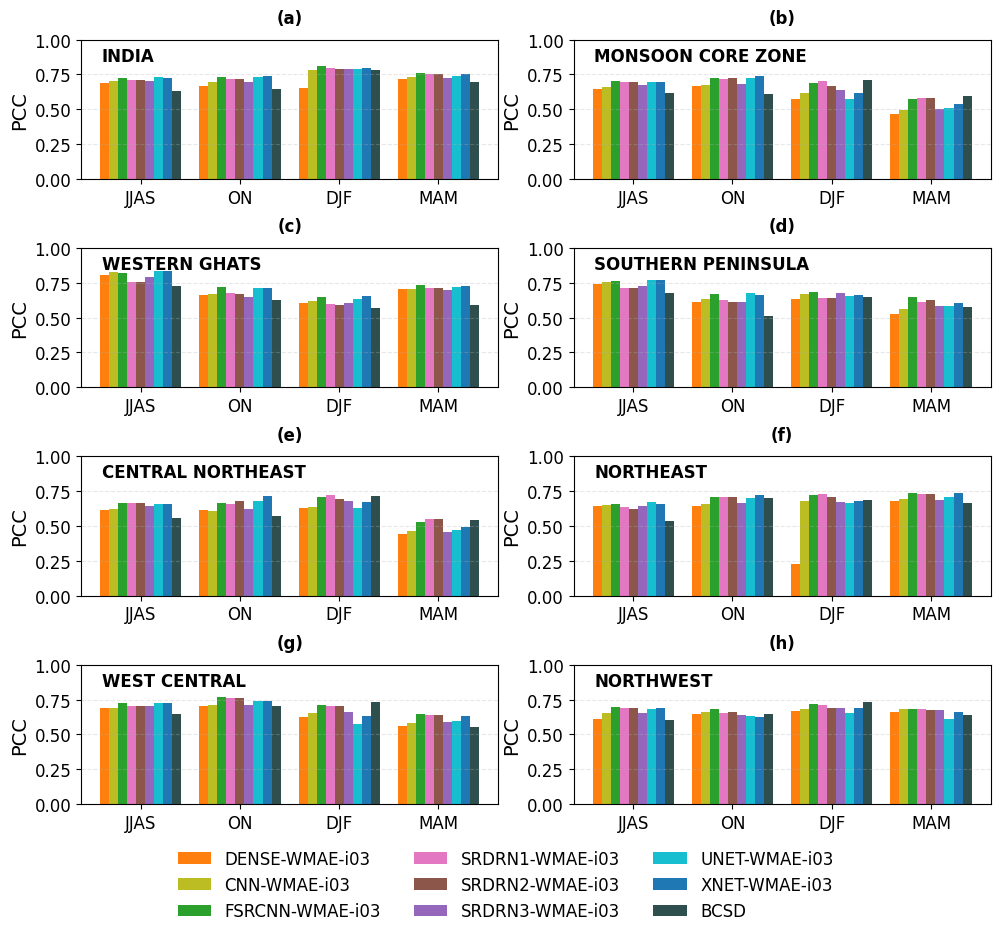

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def filter_df(df, column, string):
    """Select and merge rows from the dataframe where the specified string is present in the specified column."""
    return df[df[column].str.contains(string, na=False)]

# Read the data
df = pd.read_csv('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/TABLE_EVALMETRICS_wSEASZONE_v1.0.0.csv')

# Define regions and seasons
regions = ['IND', 'MCZ', 'WG', 'SP',  'CNE', 'NE', 'WC', 'NW']
regions_names = [
    'INDIA', 
    'MONSOON CORE ZONE', 
    'WESTERN GHATS', 
    'SOUTHERN PENINSULA', 
    'CENTRAL NORTHEAST', 
    'NORTHEAST',
    'WEST CENTRAL', 
    'NORTHWEST'
]
seasons = [ 'JJAS',  'ON', 'DJF', 'MAM',]
0
# Define methods (using i03 versions as per your data)
methods = ['DENSE-WMAE-i03', 
           'CNN-WMAE-i03',
           'FSRCNN-WMAE-i03',
           'SRDRN1-WMAE-i03',
           'SRDRN2-WMAE-i03', 
           'SRDRN3-WMAE-i03',
           'UNET-WMAE-i03',
           'XNET-WMAE-i03',
           'BCSD',
        ]

# Define colors
colors = [
    "#ff7f0e",  # Orange pair
    "#bcbd22",  # Yellow-green pair
    "#2ca02c",  # Green pair
    "#e377c2",  # Pink pair
    "#8c564b",  # Brown pair
    "#9467bd",  # Purple pair
    "#17becf",  # Teal pair
    "#1f77b4",  # Blue pair
    "#2F4F4F",
]

# Light Shades
# colors = [
#     "#ffbb78",  # Orange pair
#     "#dbdb8d",  # Yellow-green pair
#     "#98df8a",  # Green pair
#     "#f7b6d2",  # Pink pair
#     "#c49c94",  # Brown pair
#     "#c5b0d5",  # Purple pair
#     "#9edae5",  # Teal pair 
#     "#aec7e8",  # Blue pair
#     "#2F4F4F",
#     ]

# Create figure with 3x2 subplots
fig, axes = plt.subplots(4, 2, figsize=(10, 9))
fig.subplots_adjust(hspace=1, wspace=0.1)
# fig.suptitle('PCC Scores by Region and Season', fontsize=16, fontweight='bold')

bar_width = 0.5
gap = 1
metric = 'PCC'

for idx, (region, region_name, ax) in enumerate(zip(regions, regions_names, axes.flat)):
    x = np.arange(len(seasons)) * (len(methods) * bar_width + gap)
    
    for j, method in enumerate(methods):
        season_values = []
        for season in seasons:
            value = df[(df['ZONE'] == region) & 
                      (df['SEASON'] == season) & 
                      (df['LABEL'] == method)][metric].values
            season_values.append(value[0] if len(value) > 0 else np.nan)
        
        ax.bar(x + j * bar_width, season_values, width=bar_width, 
               color=colors[j], label=method if idx == 0 else "", zorder=1)
    
    # Customize subplot
    ax.set_title(f"({chr(97 + idx)})", loc='center', fontweight='bold', pad=12)
    ax.set_ylabel(metric, fontsize=14)
    ax.set_xticks(x + (len(methods) * bar_width) / 2 - bar_width / 2)
    ax.set_xticklabels(seasons)
    ax.tick_params(axis='both', labelsize=12)
    ax.set_ylim(0, 1.0)
    ax.grid(True, axis='y', linestyle='--', alpha=0.3, zorder=0)
    
    # Add subplot labels
    ax.text(0.05, 0.85, f"{region_name}", transform=ax.transAxes, 
            fontsize=12, fontweight='bold', fontfamily='sans-serif')

# Add single legend at the bottom
# fig.legend(methods, loc='center', fontsize=12, bbox_to_anchor=(1.12, 0.55), 
#           ncol=1, frameon=False)

fig.legend(methods, loc='center', fontsize=12, bbox_to_anchor=(0.5, 0.01), 
           ncol=3, frameon=False)

# Adjust layout
plt.tight_layout()
plt.subplots_adjust(bottom=0.1)

# SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
# plt.savefig(f'{SAVE_PATH}/Figure_MultiBar_Plot_Zones_Season.png', 
#             format='png', dpi=600, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()

## Figure 09: Bar Plot of Seasonal Skill of Climate Indices

### Prepare the data

In [ ]:
"""
#!/bin/bash

explist=(
quantile_mapping_disagregated_out.nc
p07a_n01_l01_i01_b01_r01_012_out.nc
p07a_n01_l01_i02_b01_r01_012_out.nc
p07a_n01_l01_i03_b01_r01_012_out.nc
p07a_n01_l02_i01_b01_r01_012_out.nc
p07a_n01_l02_i02_b01_r01_012_out.nc
p07a_n01_l02_i03_b01_r01_012_out.nc
p07a_n02_l01_i01_b01_r01_012_out.nc
p07a_n02_l01_i02_b01_r01_012_out.nc
p07a_n02_l01_i03_b01_r01_012_out.nc
p07a_n02_l02_i01_b01_r01_012_out.nc
p07a_n02_l02_i02_b01_r01_012_out.nc
p07a_n02_l02_i03_b01_r01_012_out.nc
p07a_n03_l01_i01_b01_r01_012_out.nc
p07a_n03_l01_i02_b01_r01_012_out.nc
p07a_n03_l01_i03_b01_r01_012_out.nc
p07a_n03_l02_i01_b01_r01_012_out.nc
p07a_n03_l02_i02_b01_r01_012_out.nc
p07a_n03_l02_i03_b01_r01_012_out.nc
p07a_s01_l01_i01_b01_r01_012_out.nc
p07a_s01_l01_i02_b01_r01_012_out.nc
p07a_s01_l01_i03_b01_r01_012_out.nc
p07a_s01_l02_i01_b01_r01_012_out.nc
p07a_s01_l02_i02_b01_r01_012_out.nc
p07a_s01_l02_i03_b01_r01_012_out.nc
p07a_s02_l01_i01_b01_r01_012_out.nc
p07a_s02_l01_i02_b01_r01_012_out.nc
p07a_s02_l01_i03_b01_r01_012_out.nc
p07a_s02_l02_i01_b01_r01_012_out.nc
p07a_s02_l02_i02_b01_r01_012_out.nc
p07a_s02_l02_i03_b01_r01_012_out.nc
p07a_s03_l01_i01_b01_r01_012_out.nc
p07a_s03_l01_i02_b01_r01_012_out.nc
p07a_s03_l01_i03_b01_r01_012_out.nc
p07a_s03_l02_i01_b01_r01_012_out.nc
p07a_s03_l02_i02_b01_r01_012_out.nc
p07a_s03_l02_i03_b01_r01_012_out.nc
p07a_u01_l01_i01_b01_r01_012_out.nc
p07a_u01_l01_i02_b01_r01_012_out.nc
p07a_u01_l01_i03_b01_r01_012_out.nc
p07a_u01_l02_i01_b01_r01_012_out.nc
p07a_u01_l02_i02_b01_r01_012_out.nc
p07a_u01_l02_i03_b01_r01_012_out.nc
p07a_u02_l01_i01_b01_r01_012_out.nc
p07a_u02_l01_i02_b01_r01_012_out.nc
p07a_u02_l01_i03_b01_r01_012_out.nc
p07a_u02_l02_i01_b01_r01_012_out.nc
p07a_u02_l02_i02_b01_r01_012_out.nc
p07a_u02_l02_i03_b01_r01_012_out.nc
ref_imda_012_data.nc
)

################################################## P07A_RMEAN_v1.nc ################################################

#----------------------------------------------------------------------------------------------------
varname=RMEANMON
SOURCEPATH=/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/GENDATA
DESTINPATH=/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/CLIMATE_INDICES_CALC
#----------------------------------------------------------------------------------------------------
echo Processing ... ${varname}

DIR=${DESTINPATH}/${varname}

if [ "$1" = "c" ]; then
    rm -rfv $DIR
fi

if [ "$2" = "d" ]; then
    rm -v ${DESTINPATH}/${OUTFILE}
fi

mkdir -p "${DIR}"

for exp_id in ${explist[@]}; do
        filepath=$(find ${SOURCEPATH} -maxdepth 1 -name "${exp_id}" -type f | sed 's/\.\///')
        filename=$(basename "$filepath")
        echo "${filename}"
        cdo -v -L \
	-setname,"prec" \
        -monmean "${SOURCEPATH}/${filename}" \
        "${DIR}/${filename}"
        echo ''
done



################################################# P07A_RX1DAY_v1.nc ################################################

#----------------------------------------------------------------------------------------------------
varname=RX1DAYMON
SOURCEPATH=/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/GENDATA
DESTINPATH=/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/CLIMATE_INDICES_CALC
#----------------------------------------------------------------------------------------------------
echo Processing ... ${varname}

DIR=${DESTINPATH}/${varname}

if [ "$1" = "c" ]; then
    rm -rfv $DIR
fi

if [ "$2" = "d" ]; then
    rm -v ${DESTINPATH}/${OUTFILE}
fi

mkdir -p "${DIR}"


for exp_id in ${explist[@]}; do
        filepath=$(find ${SOURCEPATH} -maxdepth 1 -name "${exp_id}" -type f | sed 's/\.\///')
        filename=$(basename "$filepath")
        echo "${filename}"
        cdo -v -L \
	-setname,"prec" \
        -etccdi_rx1day,freq=month "${SOURCEPATH}/${filename}" \
        "${DIR}/${filename}"
        echo ''
done

################################################## P07A_R{PCTL}_v1.nc ################################################

for pctl in 99 95; do # 90 80 75 50 25 2 1 98

#----------------------------------------------------------------------------------------------------
varname=R${pctl}MON
SOURCEPATH=/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/GENDATA
DESTINPATH=/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/CLIMATE_INDICES_CALC
#----------------------------------------------------------------------------------------------------
echo Processing ... ${varname}

DIR=${DESTINPATH}/${varname}

if [ "$1" = "c" ]; then
    rm -rfv $DIR
fi

if [ "$2" = "d" ]; then
    rm -v ${DESTINPATH}/${OUTFILE}
fi

mkdir -p "${DIR}"


for exp_id in ${explist[@]}; do
        filepath=$(find ${SOURCEPATH} -maxdepth 1 -name "${exp_id}" -type f | sed 's/\.\///')
        filename=$(basename "$filepath")
        echo "${filename}"
        cdo -v -L \
	-setname,"prec" \
        -monpctl,${pctl} "${SOURCEPATH}/${filename}" -monmin "${SOURCEPATH}/${filename}" -monmax "${SOURCEPATH}/${filename}" \
        "${DIR}/${filename}"
        echo ''
done
done
"""
pass

In [82]:
# #!/usr/bin/env python3
# # -*- coding: utf-8 -*-
# """
# Created on Fri Jul 26 14:18:22 2024

# @author: midhunm
# """

# import os
# import pickle
# import numpy as np
# import pandas as pd
# import xarray as xr
# from scipy.stats import pearsonr, ttest_ind
# import hydroeval as he
# from tqdm import tqdm
# from sklearn.metrics import explained_variance_score, r2_score, mean_squared_error
# from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error

# # Define evaluation metrics functions
# def kge_calc(y_true, y_pred):
#     evaluations = y_true[~np.isnan(y_true)].flatten()
#     simulations = y_pred[~np.isnan(y_pred)].flatten()    
    
#     kge, r, alpha, beta = he.evaluator(he.kgeprime, simulations, evaluations)
#     return kge[0], r[0], alpha[0], beta[0]

# def nse_calc(y_true, y_pred):
#     evaluations = y_true[~np.isnan(y_true)].flatten()
#     simulations = y_pred[~np.isnan(y_pred)].flatten()    
    
#     nse = he.evaluator(he.nse, simulations, evaluations)
#     return nse[0]

# def rmse_calc(y_true, y_pred):
#     evaluations = y_true[~np.isnan(y_true)].flatten()
#     simulations = y_pred[~np.isnan(y_pred)].flatten()    
    
#     rmse = he.evaluator(he.rmse, simulations, evaluations)
#     return rmse[0]

# def mare_calc(y_true, y_pred):    
#     evaluations = y_true[~np.isnan(y_true)].flatten()
#     simulations = y_pred[~np.isnan(y_pred)].flatten() 
    
#     mare = he.evaluator(he.mare, simulations, evaluations)
#     return mare[0]

# def pbias_calc(y_true, y_pred):
#     evaluations = y_true[~np.isnan(y_true)].flatten()
#     simulations = y_pred[~np.isnan(y_pred)].flatten()   
    
#     pbias = he.evaluator(he.pbias, simulations, evaluations)
#     return pbias[0] * -1 # Reverse sign

# def pcc_calc(y_true, y_pred):
#     y_true = y_true[~np.isnan(y_true)].flatten()
#     y_pred = y_pred[~np.isnan(y_pred)].flatten()
    
#     pcc, pcc_pval = pearsonr(y_true, y_pred)
#     return pcc, pcc_pval

# def acc_calc(y_true, y_pred):
#     """
#     Calculate the Anomaly Correlation Coefficient (ACC).
#     Anomalies for both y_true and y_pred are calculated w.r.t. the mean of y_true.
#     """
#     y_true = y_true[~np.isnan(y_true)].flatten()
#     y_pred = y_pred[~np.isnan(y_pred)].flatten()
#     print(f'\tMean of y_true and y_pred: {np.mean(y_true)} and {np.mean(y_pred)}')
#     y_true_anomaly = y_true - np.mean(y_true)
#     y_pred_anomaly = y_pred - np.mean(y_pred) 
#     acc, acc_pval = pearsonr(y_true_anomaly, y_pred_anomaly)
#     return acc, acc_pval

# def ttest_calc(y_true, y_pred):
#     """
#     Calculate the Students T-Test independent.
#     """
#     y_true = y_true[~np.isnan(y_true)].flatten()
#     y_pred = y_pred[~np.isnan(y_pred)].flatten()
    
#     tstat, tstat_pval = ttest_ind(y_true, y_pred)
#     return tstat, tstat_pval

# def mbe_calc(y_true, y_pred):
#     """Calculate Mean Bias Error (MBE)."""
#     y_true = y_true[~np.isnan(y_true)].flatten()
#     y_pred = y_pred[~np.isnan(y_pred)].flatten()
    
#     mbe = np.mean(y_pred - y_true)
#     return mbe


# def tss_calc(y_true, y_pred, r_max = 0.999):
#     """Calculate Taylor Skill Score (TSS).""" 
#     y_true = y_true[~np.isnan(y_true)].flatten()
#     y_pred = y_pred[~np.isnan(y_pred)].flatten()
    
#     r = pearsonr(y_true, y_pred)[0]
#     y_true_std = np.std(y_true)
#     y_pred_std = np.std(y_pred)
#     numer = 4 * ((1 + r) ** 2)
#     denom = (((y_pred_std / y_true_std) + (y_true_std / y_pred_std)) ** 2) * ((1 + r_max) ** 2)
#     tss = numer / denom
#     return tss

# def evs_calc(y_true, y_pred):
#     """Calculate Explained Variance Score (TSS).""" 
#     y_true = y_true[~np.isnan(y_true)].flatten()
#     y_pred = y_pred[~np.isnan(y_pred)].flatten()
    
#     evs = explained_variance_score(y_true, y_pred)
#     return evs
       
# def r2_calc(y_true, y_pred):
#     """Calculate R2 Score (R2).""" 
#     y_true = y_true[~np.isnan(y_true)].flatten()
#     y_pred = y_pred[~np.isnan(y_pred)].flatten()
    
#     r2 = r2_score(y_true, y_pred)
#     return r2

# def mse_calc(y_true, y_pred):
#     """Calculate Mean Squared Error (MSE).""" 
#     y_true = y_true[~np.isnan(y_true)].flatten()
#     y_pred = y_pred[~np.isnan(y_pred)].flatten()
    
#     mse = mean_squared_error(y_true, y_pred)
#     return mse

# def mae_calc(y_true, y_pred):
#     """Calculate Mean Absolute Error (MAE).""" 
#     y_true = y_true[~np.isnan(y_true)].flatten()
#     y_pred = y_pred[~np.isnan(y_pred)].flatten()
    
#     mae = mean_absolute_error(y_true, y_pred)
#     return mae

# def mape_calc(y_true, y_pred):
#     """Calculate Mean Absolute Percentage Error (MAPE).""" 
#     y_true = y_true[~np.isnan(y_true)].flatten()
#     y_pred = y_pred[~np.isnan(y_pred)].flatten()
    
#     mape = mean_absolute_percentage_error(y_true, y_pred)
#     return mape

# def nrmse_calc(y_true, y_pred):
#     """Calculate Mean Absolute Percentage Error (MAPE).""" 
#     y_true = y_true[~np.isnan(y_true)].flatten()
#     y_pred = y_pred[~np.isnan(y_pred)].flatten()

#     nrmse = rmse_calc(y_true, y_pred) / (np.max(y_true) - np.min(y_true))
#     return nrmse
    
# def filter_months(dataarray, filter_months_list = None):
#     """Filter months from an xarray dataarray"""
#     return dataarray.sel(time=dataarray['time.month'].isin(filter_months_list))

# def mask_array(dataarray, maskarray):
#     """Mask an xarray dataarray"""
#     if isinstance(maskarray, xr.DataArray):
#         maskarray = maskarray.values
#     if dataarray.shape[1:2] != maskarray.shape[1:2]:
#         raise ValueError("dataarray and maskarray must have the same shape")
#     return dataarray*maskarray

# def make_eval_table(data_dict,
#                    mask_dict=None, 
#                    seas_dict=None, 
#                    suffix='OK', 
#                    csv_save_path = '.'):


#     results = []

#     for season, month_list in seas_dict.items():
    
#         for zone, (zone_mask_path, zone_name) in mask_dict.items():

#             print(f'\nMasking for ... {zone}: {zone_name}: {zone_mask_path}')
#             print(f'Season ... {season}: {month_list}')
            
#             mask = xr.open_dataset(zone_mask_path).mask
            
#             y_true = xr.open_dataset(data_dict['REF'][0])
#             y_true = y_true["prec"]
#             y_true = filter_months(y_true, filter_months_list = month_list)
#             y_true = mask_array(y_true, mask)
#             y_true = y_true.data.squeeze()
            
#             for exp_id, (exp_data_path, label) in data_dict.items():
            
#                 if exp_id=='REF':
#                     continue
            
#                 else:
#                     print(f'\n\tCalculating metrics for ... {exp_id}: {label}')
#                     print(f'\tLoading ... {exp_data_path}')
                    
#                     y_pred = xr.open_dataset(exp_data_path)
#                     y_pred = y_pred['prec']
#                     y_pred = filter_months(y_pred, filter_months_list = month_list)
#                     y_pred = mask_array(y_pred, mask)
#                     y_pred = y_pred.data.squeeze()
                    
#                     metrics_values = {
                                
#                                 'KGE'       : kge_calc(y_true, y_pred)[0],
#                                 'R'         : kge_calc(y_true, y_pred)[1],
#                                 'ALPHA'     : kge_calc(y_true, y_pred)[2],
#                                 'BETA'      : kge_calc(y_true, y_pred)[3],
#                                 'TSS'       : tss_calc(y_true, y_pred),
#                                 'NSE'       : nse_calc(y_true, y_pred),
#                                 'RMSE'      : rmse_calc(y_true, y_pred),
#                                 'NRMSE'     : nrmse_calc(y_true, y_pred),
#                                 'MARE'      : mare_calc(y_true, y_pred),
#                                 'PBIAS'     : pbias_calc(y_true, y_pred),
#                                 'EVS'       : evs_calc(y_true, y_pred),
#                                 'R2'        : r2_calc(y_true, y_pred),
#                                 'MSE'       : mse_calc(y_true, y_pred),
#                                 'MAE'       : mae_calc(y_true, y_pred),
#                                 'MAPE'      : mape_calc(y_true, y_pred),
#                                 'MBE'       : mbe_calc(y_true, y_pred),
#                                 'PCC'       : pcc_calc(y_true, y_pred)[0],
#                                 'PCC_PVAL'  : pcc_calc(y_true, y_pred)[1],
#                                 'ACC'       : acc_calc(y_true, y_pred)[0],
#                                 'ACC_PVAL'  : acc_calc(y_true, y_pred)[1], 
#                                 'TSTAT'     : ttest_calc(y_true, y_pred)[0],
#                                 'TSTAT_PVAL': ttest_calc(y_true, y_pred)[1],
#                                 'MAX_VAL'   : np.nanmax(y_pred)
#                             }
        
#                     # Round metrics to the desired decimal place
#                     rounded_metrics_values = {key: round(value, 8) for key, value in metrics_values.items()}

#                     print_value = metrics_values['PCC']
#                     print(f'\tPCC: {print_value}')
                    
#                     # Append results to the list
#                     results.append([zone, zone_name, season, exp_id, label] + list(rounded_metrics_values.values()))
        
#     # Give headers to CSV file
#     header = ['ZONE', 'ZONE_NAME', 'SEASON', 'EXP_ID', 'LABEL'] + list(rounded_metrics_values.keys())

#     #################### SAVE RESULTS ####################

#     # Convert the results to a DataFrame
#     df = pd.DataFrame(results, columns=header)
    
#     print("\nFinal Results:")
#     print(df.to_string(index=False))

#     csv_name = f'TABLE_EVALMETRICS_wSEASZONE_{suffix}.csv'
#     df.to_csv(f'{csv_save_path}/{csv_name}', index=False)
    
#     print(f'\nResults saved at {csv_save_path}/{csv_name}')
#     locals().clear()

# #%% Calculte and save csv.
    
# for indice in ["R99MON",  "R95MON", "RX1DAYMON",  "RMEANMON"]:
#     DATA_PATH = f"/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/CLIMATE_INDICES_DATA/{indice}"
#     data_dict = {  
        
#         'REF': [f'{DATA_PATH}/ref_imda_012_data.nc', 'IMDAA'],

#         'N01_L01_I01': [f'{DATA_PATH}/p07a_n01_l01_i01_b01_r01_012_out.nc', 'DENSE-WMAE-i01'  ],
#         'N01_L01_I02': [f'{DATA_PATH}/p07a_n01_l01_i02_b01_r01_012_out.nc', 'DENSE-WMAE-i02'  ],
#         'N01_L01_I03': [f'{DATA_PATH}/p07a_n01_l01_i03_b01_r01_012_out.nc', 'DENSE-WMAE-i03'  ],
#         'N01_L02_I01': [f'{DATA_PATH}/p07a_n01_l02_i01_b01_r01_012_out.nc', 'DENSE-GAMMA-i01' ],
#         'N01_L02_I02': [f'{DATA_PATH}/p07a_n01_l02_i02_b01_r01_012_out.nc', 'DENSE-GAMMA-i02' ],
#         'N01_L02_I03': [f'{DATA_PATH}/p07a_n01_l02_i03_b01_r01_012_out.nc', 'DENSE-GAMMA-i03' ],

#         'N02_L01_I01': [f'{DATA_PATH}/p07a_n02_l01_i01_b01_r01_012_out.nc', 'CNN-WMAE-i01'    ],
#         'N02_L01_I02': [f'{DATA_PATH}/p07a_n02_l01_i02_b01_r01_012_out.nc', 'CNN-WMAE-i02'    ],
#         'N02_L01_I03': [f'{DATA_PATH}/p07a_n02_l01_i03_b01_r01_012_out.nc', 'CNN-WMAE-i03'    ],
#         'N02_L02_I01': [f'{DATA_PATH}/p07a_n02_l02_i01_b01_r01_012_out.nc', 'CNN-GAMMA-i01'   ],
#         'N02_L02_I02': [f'{DATA_PATH}/p07a_n02_l02_i02_b01_r01_012_out.nc', 'CNN-GAMMA-i02'   ],
#         'N02_L02_I03': [f'{DATA_PATH}/p07a_n02_l02_i03_b01_r01_012_out.nc', 'CNN-GAMMA-i03'   ],
        
#         'N03_L01_I01': [f'{DATA_PATH}/p07a_n03_l01_i01_b01_r01_012_out.nc', 'FSRCNN-WMAE-i01' ],
#         'N03_L01_I02': [f'{DATA_PATH}/p07a_n03_l01_i02_b01_r01_012_out.nc', 'FSRCNN-WMAE-i02' ],
#         'N03_L01_I03': [f'{DATA_PATH}/p07a_n03_l01_i03_b01_r01_012_out.nc', 'FSRCNN-WMAE-i03' ],
#         'N03_L02_I01': [f'{DATA_PATH}/p07a_n03_l02_i01_b01_r01_012_out.nc', 'FSRCNN-GAMMA-i01'],
#         'N03_L02_I02': [f'{DATA_PATH}/p07a_n03_l02_i02_b01_r01_012_out.nc', 'FSRCNN-GAMMA-i02'],
#         'N03_L02_I03': [f'{DATA_PATH}/p07a_n03_l02_i03_b01_r01_012_out.nc', 'FSRCNN-GAMMA-i03'],

#         'S01_L01_I01': [f'{DATA_PATH}/p07a_s01_l01_i01_b01_r01_012_out.nc', 'SRDRN1-WMAE-i01' ],
#         'S01_L01_I02': [f'{DATA_PATH}/p07a_s01_l01_i02_b01_r01_012_out.nc', 'SRDRN1-WMAE-i02' ],
#         'S01_L01_I03': [f'{DATA_PATH}/p07a_s01_l01_i03_b01_r01_012_out.nc', 'SRDRN1-WMAE-i03' ],
#         'S01_L02_I01': [f'{DATA_PATH}/p07a_s01_l02_i01_b01_r01_012_out.nc', 'SRDRN1-GAMMA-i01'],
#         'S01_L02_I02': [f'{DATA_PATH}/p07a_s01_l02_i02_b01_r01_012_out.nc', 'SRDRN1-GAMMA-i02'],
#         'S01_L02_I03': [f'{DATA_PATH}/p07a_s01_l02_i03_b01_r01_012_out.nc', 'SRDRN1-GAMMA-i03'],
        
#         'S02_L01_I01': [f'{DATA_PATH}/p07a_s02_l01_i01_b01_r01_012_out.nc', 'SRDRN2-WMAE-i01' ],
#         'S02_L01_I02': [f'{DATA_PATH}/p07a_s02_l01_i02_b01_r01_012_out.nc', 'SRDRN2-WMAE-i02' ],
#         'S02_L01_I03': [f'{DATA_PATH}/p07a_s02_l01_i03_b01_r01_012_out.nc', 'SRDRN2-WMAE-i03' ],
#         'S02_L02_I01': [f'{DATA_PATH}/p07a_s02_l02_i01_b01_r01_012_out.nc', 'SRDRN2-GAMMA-i01'],
#         'S02_L02_I02': [f'{DATA_PATH}/p07a_s02_l02_i02_b01_r01_012_out.nc', 'SRDRN2-GAMMA-i02'],
#         'S02_L02_I03': [f'{DATA_PATH}/p07a_s02_l02_i03_b01_r01_012_out.nc', 'SRDRN2-GAMMA-i03'],

#         'S03_L01_I01': [f'{DATA_PATH}/p07a_s03_l01_i01_b01_r01_012_out.nc', 'SRDRN3-WMAE-i01' ],
#         'S03_L01_I02': [f'{DATA_PATH}/p07a_s03_l01_i02_b01_r01_012_out.nc', 'SRDRN3-WMAE-i02' ],
#         'S03_L01_I03': [f'{DATA_PATH}/p07a_s03_l01_i03_b01_r01_012_out.nc', 'SRDRN3-WMAE-i03' ],
#         'S03_L02_I01': [f'{DATA_PATH}/p07a_s03_l02_i01_b01_r01_012_out.nc', 'SRDRN3-GAMMA-i01'],
#         'S03_L02_I02': [f'{DATA_PATH}/p07a_s03_l02_i02_b01_r01_012_out.nc', 'SRDRN3-GAMMA-i02'],
#         'S03_L02_I03': [f'{DATA_PATH}/p07a_s03_l02_i03_b01_r01_012_out.nc', 'SRDRN3-GAMMA-i03'],

#         'U01_L01_I01': [f'{DATA_PATH}/p07a_u01_l01_i01_b01_r01_012_out.nc', 'UNET-WMAE-i01'   ],
#         'U01_L01_I02': [f'{DATA_PATH}/p07a_u01_l01_i02_b01_r01_012_out.nc', 'UNET-WMAE-i02'   ],
#         'U01_L01_I03': [f'{DATA_PATH}/p07a_u01_l01_i03_b01_r01_012_out.nc', 'UNET-WMAE-i03'   ],
#         'U01_L02_I01': [f'{DATA_PATH}/p07a_u01_l02_i01_b01_r01_012_out.nc', 'UNET-GAMMA-i01'  ],
#         'U01_L02_I02': [f'{DATA_PATH}/p07a_u01_l02_i02_b01_r01_012_out.nc', 'UNET-GAMMA-i02'  ],
#         'U01_L02_I03': [f'{DATA_PATH}/p07a_u01_l02_i03_b01_r01_012_out.nc', 'UNET-GAMMA-i03'  ],

#         'U02_L01_I01': [f'{DATA_PATH}/p07a_u02_l01_i01_b01_r01_012_out.nc', 'XNET-WMAE-i01'   ],
#         'U02_L01_I02': [f'{DATA_PATH}/p07a_u02_l01_i02_b01_r01_012_out.nc', 'XNET-WMAE-i02'   ],
#         'U02_L01_I03': [f'{DATA_PATH}/p07a_u02_l01_i03_b01_r01_012_out.nc', 'XNET-WMAE-i03'   ],
#         'U02_L02_I01': [f'{DATA_PATH}/p07a_u02_l02_i01_b01_r01_012_out.nc', 'XNET-GAMMA-i01'  ],
#         'U02_L02_I02': [f'{DATA_PATH}/p07a_u02_l02_i02_b01_r01_012_out.nc', 'XNET-GAMMA-i02'  ],
#         'U02_L02_I03': [f'{DATA_PATH}/p07a_u02_l02_i03_b01_r01_012_out.nc', 'XNET-GAMMA-i03'  ],
        
#         'C01': [f'{DATA_PATH}/c01_quantile_mapping_disagregated_out.nc' , 'BCSD'],

#         }

#     MASK_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES"
#     mask_dict = {
#         'IND': [f'{MASK_PATH}/India.nc'             , 'INDIA'], 
#         # 'MCZ': [f'{MASK_PATH}/Monsoon_Core_Zone.nc' , 'MONSOON CORE ZONE'], 
#         # 'WG' : [f'{MASK_PATH}/Western_Ghats.nc'     , 'WESTERN GHATS'], 
#         # 'SP' : [f'{MASK_PATH}/South_Peninsular.nc'  , 'SOUTHERN PENINSULA'], 
#         # 'CNE': [f'{MASK_PATH}/Central_Northeast.nc' , 'CENTRAL NORTHEAST'], 
#         # 'NE' : [f'{MASK_PATH}/Northeast.nc'         , 'NORTHEAST'], 
#         # 'WC' : [f'{MASK_PATH}/West_Central.nc'      , 'WEST CENTRAL'], 
#         # 'NW' : [f'{MASK_PATH}/Northwest.nc'         , 'NORTHWEST'], 
#     }

#     seas_dict = {
#         'JJAS': [6, 7, 8, 9],
#         'ON'  : [10, 11],
#         'DJF' : [12, 1, 2],
#         'MAM' : [3, 4, 5],
#         'ALLD': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12],
#     }

#     SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

#     if __name__ == "__main__":
#         make_eval_table(data_dict, mask_dict, seas_dict, suffix=f'{indice}_IND_v1.0.0', csv_save_path = SAVE_PATH)

# #%%


### Plot the diagram

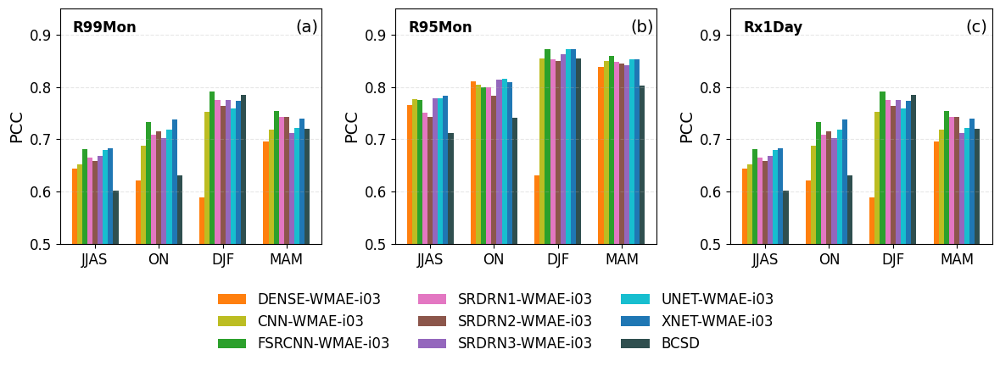

In [122]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def filter_df(df, column, string):
    """
    Filter the dataframe to select rows where the specified string is present 
    in the specified column.
    """
    return df[df[column].str.contains(string, na=False)]

def plot_barplot_season_skills(ax, df, climate_indice, region_dict, methods, seasons, colors, metric="PCC", bar_width=0.3, gap=1, ylims=(0, 1)):
    """
    Plot a barplot for seasonal skill scores across regions.
    """
    for i, (region, region_name) in enumerate(region_dict.items()):
        # Calculate x positions for the bars
        x = np.arange(len(seasons)) * (len(methods) * bar_width + gap)
        
        for j, method in enumerate(methods):
            # Collect metric values for each season
            season_values = [
                df[(df['ZONE'] == region) & (df['SEASON'] == season) & (df['LABEL'] == method)][metric].values[0]
                if not df[(df['ZONE'] == region) & (df['SEASON'] == season) & (df['LABEL'] == method)].empty else np.nan
                for season in seasons
            ]
            # Plot bars for the current method
            ax.bar(x + j * bar_width, season_values, width=bar_width, 
                   color=colors[j], label=method if i == 0 else "", zorder=1)
        
        # Customize subplot
        # ax.set_title(f"({chr(97 + i)}) {climate_indice}", loc='center', fontweight='bold', pad=12)
        ax.set_ylabel(metric, fontsize=14)
        ax.set_xticks(x + (len(methods) * bar_width) / 2 - bar_width / 2)
        ax.set_xticklabels(seasons)
        ax.tick_params(axis='both', labelsize=12)
        ax.set_ylim(ylims[0], ylims[1])
        ax.grid(True, axis='y', linestyle='--', alpha=0.3, zorder=0)

        ax.text(0.05, 0.9, climate_indice, transform=ax.transAxes, 
                    fontsize=12, fontfamily='sans-serif', fontweight='bold')

################################### Read the data ###################################
CSV_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
climate_data = {
    "R99Mon": pd.read_csv(f'{CSV_PATH}/TABLE_EVALMETRICS_wSEASZONE_R99MON_IND_v1.0.0.csv'),
    "R95Mon": pd.read_csv(f'{CSV_PATH}/TABLE_EVALMETRICS_wSEASZONE_R95MON_IND_v1.0.0.csv'),
    "Rx1Day": pd.read_csv(f'{CSV_PATH}/TABLE_EVALMETRICS_wSEASZONE_RX1DAYMON_IND_v1.0.0.csv'),
}

# Define regions, seasons, methods, and colors
region_dict = {'IND': 'INDIA'} # Add more regions
seasons = ['JJAS', 'ON', 'DJF', 'MAM']
methods = ['DENSE-WMAE-i03', 'CNN-WMAE-i03', 'FSRCNN-WMAE-i03', 
           'SRDRN1-WMAE-i03', 'SRDRN2-WMAE-i03', 'SRDRN3-WMAE-i03', 
           'UNET-WMAE-i03', 'XNET-WMAE-i03', 'BCSD']
colors = [
    "#ff7f0e", "#bcbd22", "#2ca02c", "#e377c2", 
    "#8c564b", "#9467bd", "#17becf", "#1f77b4", "#2F4F4F",
]

# Create figure
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
fig.subplots_adjust(hspace=0.5, wspace=0.2)

# Plot barplots for each climate index
for ax, (climate_indice, df) in zip(axes.flat, climate_data.items()):
    plot_barplot_season_skills(ax, df, climate_indice, region_dict, methods, seasons, colors, ylims=(0.5,0.95))

# Add single legend at the bottom
fig.legend(methods, loc='center', fontsize=12, bbox_to_anchor=(0.5, 0.02), 
           ncol=3, frameon=False)

for i, ax in enumerate(axes.flat):
    ax.text(0.9, 0.9, f"({chr(97 + i)})", transform=ax.transAxes, 
            fontsize=14, fontweight='normal')

# Adjust layout and show the plot
plt.tight_layout()
plt.subplots_adjust(bottom=0.25)

# SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
# plt.savefig(f'{SAVE_PATH}/Figure_BarPlot_Season_Skill_Indices.png', 
#             format='png', dpi=600, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()


## Figure 10: Radar Plot of Climate Indices

### Prepare data in CDO

In [60]:
"""
#!/bin/bash

SOURCEPATH="/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/GENDATA"
DESTINPATH="/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/CLIMATE_INDICES"

explist=(
ref
c01
n01_l01_i01
n01_l01_i02
n01_l01_i03
n01_l02_i01
n01_l02_i02
n01_l02_i03
n02_l01_i01
n02_l01_i02
n02_l01_i03
n02_l02_i01
n02_l02_i02
n02_l02_i03
n03_l01_i01
n03_l01_i02
n03_l01_i03
n03_l02_i01
n03_l02_i02
n03_l02_i03
s01_l01_i01
s01_l01_i02
s01_l01_i03
s01_l02_i01
s01_l02_i02
s01_l02_i03
s02_l01_i01
s02_l01_i02
s02_l01_i03
s02_l02_i01
s02_l02_i02
s02_l02_i03
s03_l01_i01
s03_l01_i02
s03_l01_i03
s03_l02_i01
s03_l02_i02
s03_l02_i03
u01_l01_i01
u01_l01_i02
u01_l01_i03
u01_l02_i01
u01_l02_i02
u01_l02_i03
u02_l01_i01
u02_l01_i02
u02_l01_i03
u02_l02_i01
u02_l02_i02
u02_l02_i03
)

################################################ P07A_CLIMATE_INDICES_RX1DAYMON_v1.nc ################################################

echo Processing .. "RX1DAYMON"
#----------------------------------------------------------------------------------------------------
varname=RX1DAYMON
OUTFILE=P07A_CLIMATE_INDICES_${varname}_v1.nc
#----------------------------------------------------------------------------------------------------

DIR=TEMP

if [ "$1" = "c" ]; then
    rm -rfv $DIR
fi

if [ "$2" = "d" ]; then
    rm -v ${DESTINPATH}/${OUTFILE}
fi

mkdir -p "${DIR}"


for exp_id in ${explist[@]}; do
        filepath=$(find ${SOURCEPATH} -maxdepth 1 -name "*${exp_id}*.nc" -type f | sed 's/\.\///')
        filename=$(basename "$filepath")
        echo "${filename}"
        cdo -v -L \
        -setname,${exp_id^^}_${varname} \
        -etccdi_rx1day,freq=month "${SOURCEPATH}/${filename}" \
        "${PWD}/${DIR}/TEMP_${exp_id}_${varname}.nc"
        echo ''
done

cdo -v -L merge ${DIR}/TEMP*.nc ${DESTINPATH}/${OUTFILE}

################################################ P07A_CLIMATE_INDICES_RMONMEAN_v1.nc ################################################

echo Processing .. "RMONMEAN"
#----------------------------------------------------------------------------------------------------
varname=RMONMEAN
OUTFILE=P07A_CLIMATE_INDICES_${varname}_v1.nc
#----------------------------------------------------------------------------------------------------

DIR=TEMP

if [ "$1" = "c" ]; then
    rm -rfv $DIR
fi

if [ "$2" = "d" ]; then
    rm -v ${DESTINPATH}/${OUTFILE}
fi

mkdir -p "${DIR}"


for exp_id in ${explist[@]}; do
        filepath=$(find ${SOURCEPATH} -maxdepth 1 -name "*${exp_id}*.nc" -type f | sed 's/\.\///')
        filename=$(basename "$filepath")
        echo "${filename}"
        cdo -v -L \
        -setname,${exp_id^^}_${varname} \
        -monmean "${SOURCEPATH}/${filename}" \
        "${PWD}/${DIR}/TEMP_${exp_id}_${varname}.nc"
        echo ''
done

cdo -v -L merge ${DIR}/TEMP*.nc ${DESTINPATH}/${OUTFILE}

######################################### P07A_CLIMATE_INDICES_R{99/95/90/75/50}MON_v1.nc ########################################

for pctl in 99 95 90 75 50 25 1 2 98; do
echo Processing .. R${pctl}MON
#----------------------------------------------------------------------------------------------------
varname=R${pctl}MON
OUTFILE=P07A_CLIMATE_INDICES_${varname}_v1.nc
#----------------------------------------------------------------------------------------------------

DIR=TEMP

if [ "$1" = "c" ]; then
    rm -rfv $DIR
fi

if [ "$2" = "d" ]; then
    rm -v ${DESTINPATH}/${OUTFILE}
fi

mkdir -p "${DIR}"


for exp_id in ${explist[@]}; do
        filepath=$(find ${SOURCEPATH} -maxdepth 1 -name "*${exp_id}*.nc" -type f | sed 's/\.\///')
        filename=$(basename "$filepath")
        echo "${filename}"
        cdo -v -L \
        -setname,${exp_id^^}_${varname} \
        -monpctl,${pctl} "${SOURCEPATH}/${filename}" -monmin "${SOURCEPATH}/${filename}" -monmax "${SOURCEPATH}/${filename}" \
        "${PWD}/${DIR}/TEMP_${exp_id}_${varname}.nc"
        echo ''
done

cdo -v -L merge ${DIR}/TEMP*.nc ${DESTINPATH}/${OUTFILE}

done

###############################################################################################################################

"""
pass

### Prepare the CSV files for the metrics

In [ ]:
import numpy as np
import pandas as pd
import xarray as xr
import hydroeval as he
from scipy.stats import pearsonr


def kge_only_calc(y_true, y_pred):
    evaluations = y_true[~np.isnan(y_true)].flatten()
    simulations = y_pred[~np.isnan(y_pred)].flatten()

    print(f'\ty_true flatten: {evaluations.shape}')
    print(f'\ty_pred flatten: {simulations.shape}')

    kge, pcc, alpha, beta = he.evaluator(he.kgeprime, simulations, evaluations)
    return kge[0]

def pcc_only_calc(y_true, y_pred):
    y_true = y_true[~np.isnan(y_true)].flatten()
    y_pred = y_pred[~np.isnan(y_pred)].flatten()

    pcc, pcc_pval = pearsonr(y_true, y_pred)
    return pcc

def nse_only_calc(y_true, y_pred):
    evaluations = y_true[~np.isnan(y_true)].flatten()
    simulations = y_pred[~np.isnan(y_pred)].flatten()

    nse = he.evaluator(he.nse, simulations, evaluations)
    return nse[0]

def filter_months(dataarray, filter_months_list = [6, 7, 8, 9]):
    """Filter months from an xarray dataarray"""
    return dataarray.sel(time=dataarray['time.month'].isin(filter_months_list))

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray*maskarray

def gen_plot_data(data_dict,
                  mask_dict,
                  model_dict,
                  jjas_only=False, 
                  version='1.0.0', 
                  csv_save_path = '.',
                  metric_name = 'NSE',
                 ):

    for varname, (filepath) in data_dict.items():
        
        print(f'\nCalculating metrics for ... {varname}')
        print(f'Loading ... {filepath}')

        ds = xr.open_dataset(filepath)
        
        final_results = {}
        for (zone, (zone_mask_path, zone_name)) in mask_dict.items():

            print(f'\n\tCalculating metrics for ... {zone}: {zone_name}')
            print(f'\tLoading ... {zone_mask_path}')
        
            mask = xr.open_dataset(zone_mask_path).mask
            
            y_true = ds[f'REF_{varname}']
            if jjas_only:
                y_true = filter_months(y_true, filter_months_list = [6, 7, 8, 9])
            y_true = mask_array(y_true, mask)
            y_true = y_true.data.squeeze()
            
            regional_results = {}
            for model_id, model_name in model_dict.items():
        
                if model_id == 'REF':
                    continue
                else:
                    y_pred = ds[f'{model_id}_{varname}']
                    if jjas_only:
                        y_pred = filter_months(y_pred, filter_months_list = [6, 7, 8, 9])
                    y_pred = mask_array(y_pred, mask)
                    y_pred = y_pred.data.squeeze()

                    if metric_name=="KGE":
                        metric_value = kge_only_calc(y_true, y_pred)
                    elif metric_name=="NSE":
                        metric_value = nse_only_calc(y_true, y_pred)
                    elif metric_name=="PCC":
                        metric_value = pcc_only_calc(y_true, y_pred)
                    else:
                        print("error: CHECK CORRECT METRIC OPTIONS!")
                    
                    print(f'\tProcessing ... {model_name}: {metric_name} = {metric_value.round(4)}')
                    regional_results[model_name] = metric_value
        
            final_results[zone_name] = regional_results

        # Convert the final_results dictionary to a DataFrame
        df = pd.DataFrame(final_results)
        csv_name = f'P07A_CLIMATE_INDICES_{varname}_{metric_name}_JJAS_v{version}.csv' if jjas_only else f'P07A_CLIMATE_INDICES_{varname}_{metric_name}_v{version}.csv'
        df.to_csv(f'{csv_save_path}/{csv_name}', index_label='EXP_NAME')
        print(f"Results saved at: {csv_save_path}/{csv_name}")

##########################################################################################################################

# All Zones : All year

model_dict = {
    'REF': 'IMDAA',

    # 'N01_L01_I01': 'DENSE-WMAE-i01',
    # 'N02_L01_I01': 'CNN-WMAE-i01',
    # 'N03_L01_I01': 'FSRCNN-WMAE-i01',
    # 'S01_L01_I01': 'SRDRN1-WMAE-i01',
    # 'S02_L01_I01': 'SRDRN2-WMAE-i01', 
    # 'S03_L01_I01': 'SRDRN3-WMAE-i01', 
    # 'U01_L01_I01': 'UNET-WMAE-i01', 
    # 'U02_L01_I01': 'XNET-WMAE-i01',

    # 'N01_L01_I02': 'DENSE-WMAE-i02',
    # 'N02_L01_I02': 'CNN-WMAE-i02',
    # 'N03_L01_I02': 'FSRCNN-WMAE-i02',
    # 'S01_L01_I02': 'SRDRN1-WMAE-i02',
    # 'S02_L01_I02': 'SRDRN2-WMAE-i02', 
    # 'S03_L01_I02': 'SRDRN3-WMAE-i02', 
    # 'U01_L01_I02': 'UNET-WMAE-i02', 
    # 'U02_L01_I02': 'XNET-WMAE-i02',
    
    'N01_L01_I03': 'DENSE-WMAE-i03',
    'N02_L01_I03': 'CNN-WMAE-i03',
    'N03_L01_I03': 'FSRCNN-WMAE-i03',
    'S01_L01_I03': 'SRDRN1-WMAE-i03',
    'S02_L01_I03': 'SRDRN2-WMAE-i03', 
    'S03_L01_I03': 'SRDRN3-WMAE-i03', 
    'U01_L01_I03': 'UNET-WMAE-i03', 
    'U02_L01_I03': 'XNET-WMAE-i03',

    # 'N01_L02_I01': 'DENSE-GAMMA-i01',
    # 'N02_L02_I01': 'CNN-GAMMA-i01',
    # 'N03_L02_I01': 'FSRCNN-GAMMA-i01',
    # 'S01_L02_I01': 'SRDRN1-GAMMA-i01',
    # 'S02_L02_I01': 'SRDRN2-GAMMA-i01', 
    # 'S03_L02_I01': 'SRDRN3-GAMMA-i01', 
    # 'U01_L02_I01': 'UNET-GAMMA-i01', 
    # 'U02_L02_I01': 'XNET-GAMMA-i01',

    # 'N01_L02_I02': 'DENSE-GAMMA-i02',
    # 'N02_L02_I02': 'CNN-GAMMA-i02',
    # 'N03_L02_I02': 'FSRCNN-GAMMA-i02',
    # 'S01_L02_I02': 'SRDRN1-GAMMA-i02',
    # 'S02_L02_I02': 'SRDRN2-GAMMA-i02', 
    # 'S03_L02_I02': 'SRDRN3-GAMMA-i02', 
    # 'U01_L02_I02': 'UNET-GAMMA-i02', 
    # 'U02_L02_I02': 'XNET-GAMMA-i02',
    
    # 'N01_L02_I03': 'DENSE-GAMMA-i03',
    # 'N02_L02_I03': 'CNN-GAMMA-i03',
    # 'N03_L02_I03': 'FSRCNN-GAMMA-i03',
    # 'S01_L02_I03': 'SRDRN1-GAMMA-i03',
    # 'S02_L02_I03': 'SRDRN2-GAMMA-i03', 
    # 'S03_L02_I03': 'SRDRN3-GAMMA-i03', 
    # 'U01_L02_I03': 'UNET-GAMMA-i03', 
    # 'U02_L02_I03': 'XNET-GAMMA-i03',
    
    'C01': 'BCSD',
}

DATA_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/CLIMATE_INDICES.L01.I02"
data_dict = {
    'R90MON': f'{DATA_PATH}/P07A_CLIMATE_INDICES_R90MON_v1.nc',
    'R95MON': f'{DATA_PATH}/P07A_CLIMATE_INDICES_R95MON_v1.nc',
    'RX1DAYMON': f'{DATA_PATH}/P07A_CLIMATE_INDICES_RX1DAYMON_v1.nc',
}

MASK_PATH = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES'
mask_dict = {
    'IND': [f'{MASK_PATH}/India.nc', 'INDIA'], 
    'MCZ': [f'{MASK_PATH}/Monsoon_Core_Zone.nc', 'MONSOON CORE ZONE'], 
    'WG' : [f'{MASK_PATH}/Western_Ghats.nc' , 'WESTERN GHATS'], 
    'SP' : [f'{MASK_PATH}/South_Peninsular.nc' , 'SOUTHERN PENINSULA'], 
    'CNE': [f'{MASK_PATH}/Central_Northeast.nc', 'CENTRAL NORTHEAST'], 
    'NE' : [f'{MASK_PATH}/Northeast.nc' , 'NORTHEAST'], 
    'WC' : [f'{MASK_PATH}/West_Central.nc' , 'WEST CENTRAL'], 
    'NW' : [f'{MASK_PATH}/Northwest.nc' , 'NORTHWEST'], 
}

SAVE_PATH = DATA_PATH

for metric in ['PCC']: # , 'NSE'
    gen_plot_data(
        data_dict,
        mask_dict,
        model_dict,
        jjas_only = False, 
        version = '1', 
        csv_save_path = SAVE_PATH,
        metric_name = metric,
    )

### Plot the diagram: WMAE-i02

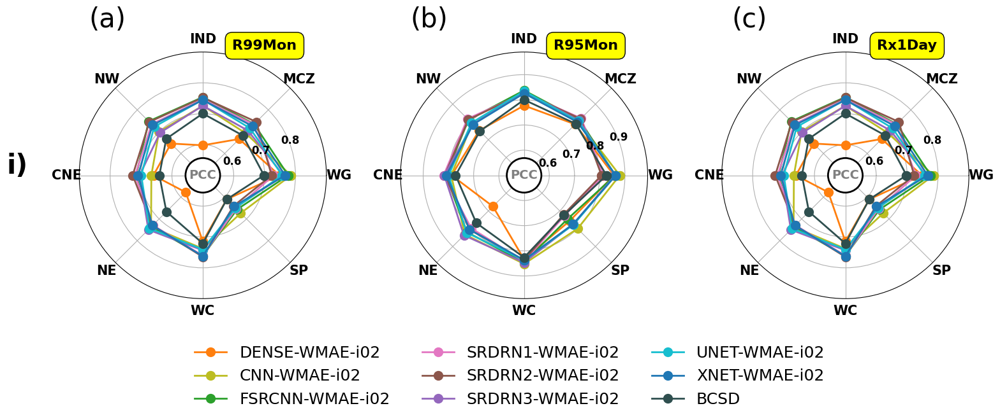

In [19]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from math import pi
from matplotlib.patches import Circle

def plot_radar_plot_tab10(ax=None,
                          csv_file_path='.',
                          varname='varname',
                          label='subplot',
                          ylim=(0.5, 0.8),
                          metric_name='PCC'):
    
    zones_dict = {
        'WG': 'WESTERN GHATS',
        'MCZ': 'MONSOON CORE ZONE',
        'IND': 'INDIA',
        'NW': 'NORTHWEST',
        'CNE': 'CENTRAL NORTHEAST',
        'NE': 'NORTHEAST',
        'WC': 'WEST CENTRAL',
        'SP': 'SOUTHERN PENINSULA',
    }
    
    # Load the CSV data
    data = pd.read_csv(csv_file_path)
    
    # Get the model names from the CSV file
    model_names = data['EXP_NAME'].values # Uncomment for future use
    radar_values = {model: [] for model in model_names}
    
    # Extract metric values for each model and region
    for zone in zones_dict.keys():
        for i, model in enumerate(model_names):
            radar_values[model].append(data[zones_dict[zone]].values[i])
    
    # Create DataFrame for the radar chart
    radar_data = pd.DataFrame(radar_values, index=zones_dict.keys())
    
    # Number of variables (regions) we're plotting
    num_vars = len(zones_dict)
    
    # Compute the angle of each axis
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    angles += angles[:1]
    
    if ax is None:
        fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))
    
    colors = [
        
        "#ff7f0e",  # Orange pair
        "#bcbd22",  # Yellow-green pair
        "#2ca02c",  # Green pair
        "#e377c2",  # Pink pair
        "#8c564b",  # Brown pair
        "#9467bd",  # Purple pair
        "#17becf",  # Teal pair
        "#1f77b4",  # Blue pair
        "#2F4F4F",
    ]
    
    # Store handles and labels for legend
    handles = []
    labels = []
    
    # Plot each model
    for i, model in enumerate(model_names):
        if model in radar_data.columns:
            values = radar_data[model].tolist()
            values += values[:1]
            line, = ax.plot(angles, values, linewidth=2, linestyle='-', marker='o', markersize=10, label=model,
                            color=colors[i % len(model_names)])
            ax.fill(angles, values, alpha=0, color=colors[i % len(model_names)])
            handles.append(line)  # Add line handle to the legend list
            labels.append(model)  # Add model name to the legend labels list
        else:
            print(f"Warning: Model '{model}' not found in radar_data columns.")
    
    # Set xlabels
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(list(zones_dict.keys()), fontsize=15, fontweight='bold')
    
    # Set ylabels
    ax.set_ylim(ylim[0], ylim[1])
    y_ticks = np.arange(ylim[0], ylim[1] + 0.1, 0.1)  # 0.1 increments
    ax.set_yticks(y_ticks[1:-1])

    # Hide default y-tick labels
    ax.set_yticklabels([])

    # Add y-tick labels manually with a high zorder
    for tick in y_ticks[1:-1]:
        ax.text(np.pi / 9, tick, f'{tick:.1f}', ha='center', fontsize=12, fontweight='bold', color='black', zorder=12) 
    
    # Create a white circle at the center
    circle = Circle((0.5, 0.5), 0.07, color='white', ec='black', lw=2, transform=ax.transAxes, zorder=10)
    ax.add_patch(circle)
    
    # Add the metric name on top of the circle
    ax.text(0.5, 0.5, metric_name, ha='center', va='center', color='grey', fontsize=14, fontweight='semibold', transform=ax.transAxes, zorder=11)

    # Add label at the top right of the plot
    ax.text(0.75, 1.01, label, transform=ax.transAxes, ha='center', fontsize=16, fontweight='bold',
            bbox=dict(facecolor='yellow', edgecolor='black', boxstyle='round,pad=0.5'))

    return handles, labels  # Return handles and labels for legend

######################################################################################################################################

metric_name = "PCC"

fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(18, 6), subplot_kw=dict(polar=True))
plt.subplots_adjust(hspace=0.3, wspace=0.3)

varname_dict = {
     # "RMONMEAN": ["MonMean", (0.74, 1)],
     # "R50MON": ["R50Mon", (0.74, 1)],
     # "R99MON": ["R99Mon", (0.5, 0.9)],
     "R95MON": ["R95Mon", (0.5, 0.99)],
     "RX1DAYMON": ["Rx1Day", (0.5, 0.9)],
     "R90MON": ["R90Mon", (0.74, 1)],
    }

DATA_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/CLIMATE_INDICES.L01.I02" # Edit here

# Get model names and plot handles for the legend
handles_list = []
labels_list = []
for i, (ax, (varname, (varlabel, ylim))) in enumerate(zip(axs.flat, varname_dict.items())):
    csv_file_path = f"{DATA_PATH}/P07A_CLIMATE_INDICES_{varname}_{metric_name}_v1.csv"
    handles, labels = plot_radar_plot_tab10(ax=ax, csv_file_path=csv_file_path, varname=varname, ylim=ylim, label=varlabel)
    handles_list.extend(handles)
    labels_list.extend(labels)
    ax.text(0.04, 1.1, f"({chr(97 + i)})", transform=ax.transAxes, fontsize=30, color='k', fontweight='normal')

# Create a common legend using the handles and labels from the first subplot
fig.legend(handles=handles_list[:9], labels=labels_list[:9], loc='lower center', bbox_to_anchor=(0.5, -0.15), ncol=3, fontsize=18, frameon=False)

# Adding the "i)" label to the left side of the plot
plt.text(
    x=0.08,  # Horizontal position (adjust as needed)
    y=0.5,  # Vertical position (same as bbox_to_anchor for alignment)
    s="i)",  # The text you want to add
    fontsize=30,
    fontweight = 'bold',
    ha='right',  # Align text to the right for placement
    transform=fig.transFigure  # Use figure-relative coordinates
)

# Save and show plot

# SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
# plt.savefig(f'{SAVE_PATH}/Figure_RadarPlot_ExtremeIndices_{metric_name}_1.png', 
#             format='png', dpi=600, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()


### Plot the diagram: WMAE-i03

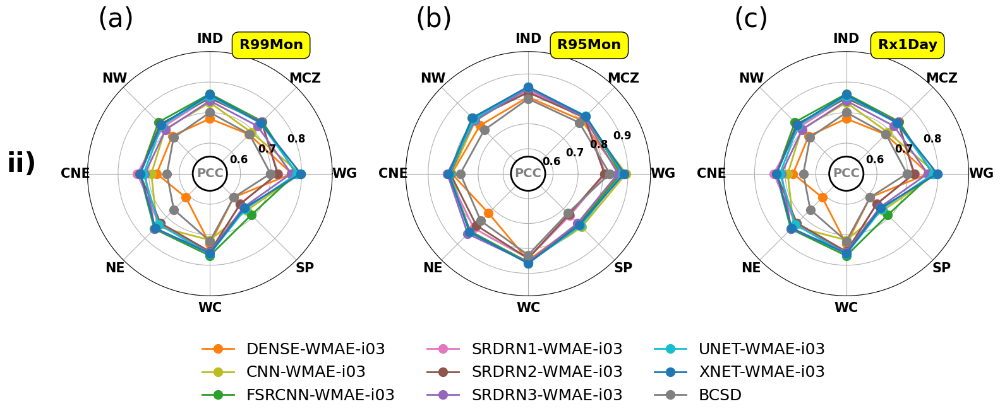

In [4]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from math import pi
from matplotlib.patches import Circle

def plot_radar_plot_tab10(ax=None,
                          csv_file_path='.',
                          varname='varname',
                          label='subplot',
                          ylim=(0.5, 0.8),
                          metric_name='PCC'):
    
    zones_dict = {
        'WG': 'WESTERN GHATS',
        'MCZ': 'MONSOON CORE ZONE',
        'IND': 'INDIA',
        'NW': 'NORTHWEST',
        'CNE': 'CENTRAL NORTHEAST',
        'NE': 'NORTHEAST',
        'WC': 'WEST CENTRAL',
        'SP': 'SOUTHERN PENINSULA',
    }
    
    # Load the CSV data
    data = pd.read_csv(csv_file_path)
    
    # Get the model names from the CSV file
    model_names = data['EXP_NAME'].values # Uncomment for future use
    radar_values = {model: [] for model in model_names}
    
    # Extract metric values for each model and region
    for zone in zones_dict.keys():
        for i, model in enumerate(model_names):
            radar_values[model].append(data[zones_dict[zone]].values[i])
    
    # Create DataFrame for the radar chart
    radar_data = pd.DataFrame(radar_values, index=zones_dict.keys())
    
    # Number of variables (regions) we're plotting
    num_vars = len(zones_dict)
    
    # Compute the angle of each axis
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    angles += angles[:1]
    
    if ax is None:
        fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))
    
    colors = [
        
        "#ff7f0e",  # Orange pair
        "#bcbd22",  # Yellow-green pair
        "#2ca02c",  # Green pair
        "#e377c2",  # Pink pair
        "#8c564b",  # Brown pair
        "#9467bd",  # Purple pair
        "#17becf",  # Teal pair
        "#1f77b4",  # Blue pair
        "grey"
        # "#2F4F4F",
    ]
    
    # Store handles and labels for legend
    handles = []
    labels = []
    
    # Plot each model
    for i, model in enumerate(model_names):
        if model in radar_data.columns:
            values = radar_data[model].tolist()
            values += values[:1]
            line, = ax.plot(angles, values, linewidth=2, linestyle='-', marker='o', markersize=10, label=model,
                            color=colors[i % len(model_names)])
            ax.fill(angles, values, alpha=0, color=colors[i % len(model_names)])
            handles.append(line)  # Add line handle to the legend list
            labels.append(model)  # Add model name to the legend labels list
        else:
            print(f"Warning: Model '{model}' not found in radar_data columns.")
    
    # Set xlabels
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(list(zones_dict.keys()), fontsize=15, fontweight='bold')
    
    # Set ylabels
    ax.set_ylim(ylim[0], ylim[1])
    y_ticks = np.arange(ylim[0], ylim[1] + 0.1, 0.1)  # 0.1 increments
    ax.set_yticks(y_ticks[1:-1])

    # Hide default y-tick labels
    ax.set_yticklabels([])

    # Add y-tick labels manually with a high zorder
    for tick in y_ticks[1:-1]:
        ax.text(np.pi / 9, tick, f'{tick:.1f}', ha='center', fontsize=12, fontweight='bold', color='black', zorder=12) 
    
    # Create a white circle at the center
    circle = Circle((0.5, 0.5), 0.07, color='white', ec='black', lw=2, transform=ax.transAxes, zorder=10)
    ax.add_patch(circle)
    
    # Add the metric name on top of the circle
    ax.text(0.5, 0.5, metric_name, ha='center', va='center', color='grey', fontsize=14, fontweight='semibold', transform=ax.transAxes, zorder=11)

    # Add label at the top right of the plot
    ax.text(0.75, 1.01, label, transform=ax.transAxes, ha='center', fontsize=16, fontweight='bold',
            bbox=dict(facecolor='yellow', edgecolor='black', boxstyle='round,pad=0.5'))

    return handles, labels  # Return handles and labels for legend

######################################################################################################################################

metric_name = "PCC"

fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(18, 6), subplot_kw=dict(polar=True))
plt.subplots_adjust(hspace=0.3, wspace=0.3)

varname_dict = {
    # "RMONMEAN": ["MonMean", (0.74, 1)],
    # "R50MON": ["R50Mon", (0.74, 1)],
     "R99MON": ["R99Mon", (0.5, 0.9)],
     "R95MON": ["R95Mon", (0.5, 0.99)],
     "RX1DAYMON": ["Rx1Day", (0.5, 0.9)],
     # "R90MON": ["R90Mon", (0.74, 1)],
}

DATA_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/CLIMATE_INDICES.L01.I03" # Edit here

# Get model names and plot handles for the legend
handles_list = []
labels_list = []
for i, (ax, (varname, (varlabel, ylim))) in enumerate(zip(axs.flat, varname_dict.items())):
    csv_file_path = f"{DATA_PATH}/P07A_CLIMATE_INDICES_{varname}_{metric_name}_v1.csv"
    handles, labels = plot_radar_plot_tab10(ax=ax, csv_file_path=csv_file_path, varname=varname, ylim=ylim, label=varlabel)
    handles_list.extend(handles)
    labels_list.extend(labels)
    ax.text(0.04, 1.1, f"({chr(97 + i)})", transform=ax.transAxes, fontsize=30, color='k', fontweight='normal')

# Create a common legend using the handles and labels from the first subplot
fig.legend(handles=handles_list[:9], labels=labels_list[:9], loc='lower center', bbox_to_anchor=(0.5, -0.15), ncol=3, fontsize=18, frameon=False)

# Adding the "i)" label to the left side of the plot
plt.text(
    x=0.08,  # Horizontal position (adjust as needed)
    y=0.5,  # Vertical position (same as bbox_to_anchor for alignment)
    s="ii)",  # The text you want to add
    fontsize=30,
    fontweight = 'bold',
    ha='right',  # Align text to the right for placement
    transform=fig.transFigure  # Use figure-relative coordinates
)

# Save and show plot

# SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
# plt.savefig(f'{SAVE_PATH}/Figure_RadarPlot_ExtremeIndices_{metric_name}_2.png', 
#             format='png', dpi=600, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()


## Merge the two

In [20]:
from PIL import Image

metric_name = "PCC"
SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
# plt.savefig(, 

# Load the two images
image1 = Image.open(f'{SAVE_PATH}/Figure_RadarPlot_ExtremeIndices_{metric_name}_1.png')  # Replace with the path to your first image
image2 = Image.open(f'{SAVE_PATH}/Figure_RadarPlot_ExtremeIndices_{metric_name}_2.png')  # Replace with the path to your second image

# Ensure both images have the same width (resize if needed)
if image1.width != image2.width:
    new_width = min(image1.width, image2.width)
    image1 = image1.resize((new_width, int(image1.height * new_width / image1.width)))
    image2 = image2.resize((new_width, int(image2.height * new_width / image2.width)))

# Create a new image with the combined height
combined_height = image1.height + image2.height
combined_image = Image.new("RGBA", (image1.width, combined_height))

# Paste the images on top of each other
combined_image.paste(image1, (0, 0))  # Paste image1 at the top
combined_image.paste(image2, (0, image1.height))  # Paste image2 below it

# Save or display the merged image
combined_image.save(f'{SAVE_PATH}/Figure_RadarPlot_ExtremeIndices_{metric_name}.png')  # Save as a new PNG file
combined_image.show()  # Display the merged image


Opening in existing browser session.


### Make the Radar Chart: PCC

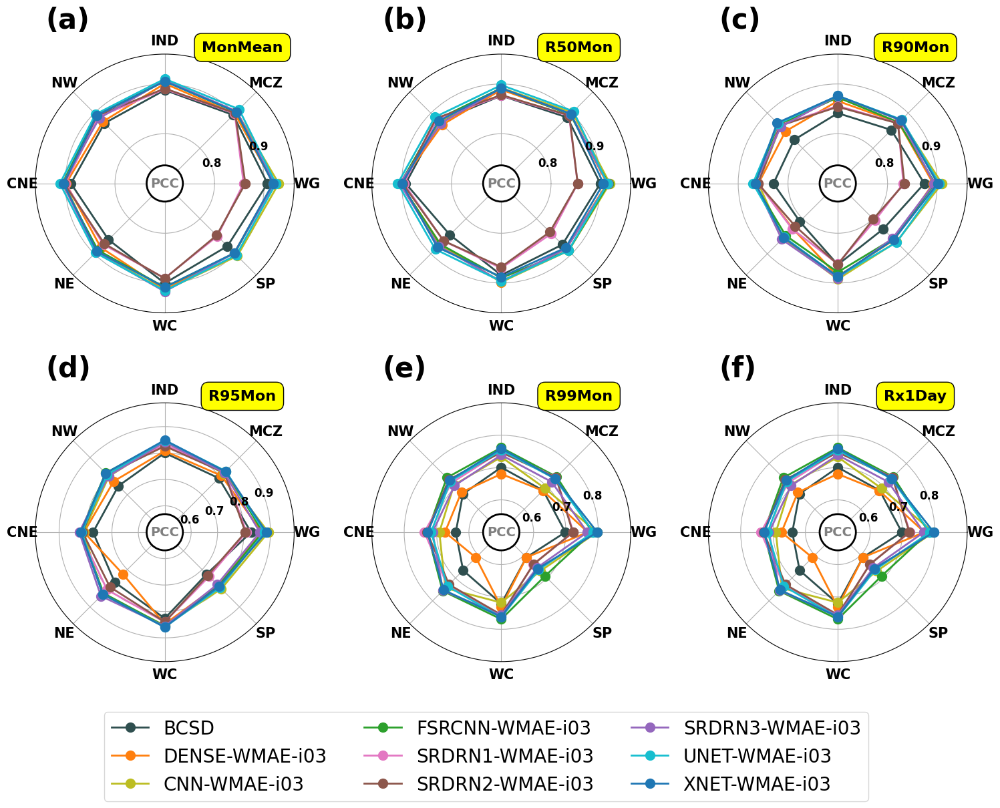

In [68]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from math import pi
from matplotlib.patches import Circle

def plot_radar_plot_tab10(ax=None,
                          csv_file_path='.',
                          varname='varname',
                          label='subplot',
                          ylim=(0.5, 0.8),
                          metric_name='PCC'):
    
    zones_dict = {
        'WG': 'WESTERN GHATS',
        'MCZ': 'MONSOON CORE ZONE',
        'IND': 'INDIA',
        'NW': 'NORTHWEST',
        'CNE': 'CENTRAL NORTHEAST',
        'NE': 'NORTHEAST',
        'WC': 'WEST CENTRAL',
        'SP': 'SOUTHERN PENINSULA',
    }
    
    # Load the CSV data
    data = pd.read_csv(csv_file_path)
    
    # Get the model names from the CSV file
    model_names = data['EXP_NAME'].values
    radar_values = {model: [] for model in model_names}
    
    # Extract metric values for each model and region
    for zone in zones_dict.keys():
        for i, model in enumerate(model_names):
            radar_values[model].append(data[zones_dict[zone]].values[i])
    
    # Create DataFrame for the radar chart
    radar_data = pd.DataFrame(radar_values, index=zones_dict.keys())
    # 
    # Number of variables (regions) we're plotting
    num_vars = len(zones_dict)
    
    # Compute the angle of each axis
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    angles += angles[:1]
    
    if ax is None:
        fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))
    
    colors = [
        "#2F4F4F",
        "#ff7f0e",  # Orange pair
        "#bcbd22",  # Yellow-green pair
        "#2ca02c",  # Green pair
        "#e377c2",  # Pink pair
        "#8c564b",  # Brown pair
        "#9467bd",  # Purple pair
        "#17becf",  # Teal pair
        "#1f77b4",  # Blue pair
    ]
    
    # Store handles and labels for legend
    handles = []
    labels = []
    
    # Plot each model
    for i, model in enumerate(model_names):
        if model in radar_data.columns:
            values = radar_data[model].tolist()
            values += values[:1]
            line, = ax.plot(angles, values, linewidth=2, linestyle='-', marker='o', markersize=10, label=model,
                            color=colors[i % len(model_names)])
            ax.fill(angles, values, alpha=0, color=colors[i % len(model_names)])
            handles.append(line)  # Add line handle to the legend list
            labels.append(model)  # Add model name to the legend labels list
        else:
            print(f"Warning: Model '{model}' not found in radar_data columns.")
    
    # Set xlabels
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(list(zones_dict.keys()), fontsize=15, fontweight='bold')
    
    # Set ylabels
    ax.set_ylim(ylim[0], ylim[1])
    y_ticks = np.arange(ylim[0], ylim[1] + 0.1, 0.1)  # 0.1 increments
    ax.set_yticks(y_ticks[1:-1])

    # Hide default y-tick labels
    ax.set_yticklabels([])

    # Add y-tick labels manually with a high zorder
    for tick in y_ticks[1:-1]:
        ax.text(np.pi / 9, tick, f'{tick:.1f}', ha='center', fontsize=12, fontweight='bold', color='black', zorder=12) 
    
    # Create a white circle at the center
    circle = Circle((0.5, 0.5), 0.07, color='white', ec='black', lw=2, transform=ax.transAxes, zorder=10)
    ax.add_patch(circle)
    
    # Add the metric name on top of the circle
    ax.text(0.5, 0.5, metric_name, ha='center', va='center', color='grey', fontsize=14, fontweight='semibold', transform=ax.transAxes, zorder=11)

    # Add label at the top right of the plot
    ax.text(0.8, 1.01, label, transform=ax.transAxes, ha='center', fontsize=16, fontweight='bold',
            bbox=dict(facecolor='yellow', edgecolor='black', boxstyle='round,pad=0.5'))

    return handles, labels  # Return handles and labels for legend

######################################################################################################################################

metric_name = "PCC"

fig, axs = plt.subplots(nrows=2, ncols=3, figsize=(18, 12), subplot_kw=dict(polar=True))
plt.subplots_adjust(hspace=0.3, wspace=0.3)

varname_dict = {
    "RMONMEAN": ["MonMean", (0.74, 1)],
    "R50MON": ["R50Mon", (0.74, 1)],
    "R90MON": ["R90Mon", (0.74, 1)],
    "R95MON": ["R95Mon", (0.5, 0.99)],
    "R99MON": ["R99Mon", (0.5, 0.9)],
    "RX1DAYMON": ["Rx1Day", (0.5, 0.9)],
}

DATA_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/CLIMATE_INDICES.L01.I03"
mark_list = ['(a)', '(b)', '(c)', '(d)', '(e)', '(f)',]

# Get model names and plot handles for the legend
handles_list = []
labels_list = []
for i, (ax, (varname, (varlabel, ylim))) in enumerate(zip(axs.flat, varname_dict.items())):
    csv_file_path = f"{DATA_PATH}/P07A_CLIMATE_INDICES_{varname}_{metric_name}_v1.csv"
    handles, labels = plot_radar_plot_tab10(ax=ax, csv_file_path=csv_file_path, varname=varname, ylim=ylim, label=varlabel)
    handles_list.extend(handles)
    labels_list.extend(labels)
    ax.text(0.04, 1.1, mark_list[i], transform=ax.transAxes, fontsize=30, color='k', fontweight='bold')

# Create a common legend using the handles and labels from the first subplot
fig.legend(handles=handles_list[:9], labels=labels_list[:9], loc='lower center', bbox_to_anchor=(0.5, -0.07), ncol=3, fontsize=20)

# Save and show plot

SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
plt.savefig(f'{SAVE_PATH}/Figure09_RadarPlot_ClimIndices_{metric_name}.png', 
            format='png', dpi=600, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()


### Plot the Diagram: NSE

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from math import pi
from matplotlib.patches import Circle

def plot_radar_plot_tab10(ax=None,
                          csv_file_path='.',
                          varname='varname',
                          label='subplot',
                          ylim=(0.5, 0.8),
                          metric_name='PCC'):
    
    zones_dict = {
        'WG': 'WESTERN GHATS',
        'MCZ': 'MONSOON CORE ZONE',
        'IND': 'INDIA',
        'NW': 'NORTHWEST',
        'CNE': 'CENTRAL NORTHEAST',
        'NE': 'NORTHEAST',
        'WC': 'WEST CENTRAL',
        'SP': 'SOUTHERN PENINSULA',
    }
    
    # Load the CSV data
    data = pd.read_csv(csv_file_path)
    
    # Get the model names from the CSV file
    model_names = data['EXP_NAME'].values
    radar_values = {model: [] for model in model_names}
    
    # Extract metric values for each model and region
    for zone in zones_dict.keys():
        for i, model in enumerate(model_names):
            radar_values[model].append(data[zones_dict[zone]].values[i])
    
    # Create DataFrame for the radar chart
    radar_data = pd.DataFrame(radar_values, index=zones_dict.keys())
    
    # Number of variables (regions) we're plotting
    num_vars = len(zones_dict)
    
    # Compute the angle of each axis
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    angles += angles[:1]
    
    if ax is None:
        fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))
    
    colors = [
        "#2F4F4F",
        "#ff7f0e",  # Orange pair
        "#bcbd22",  # Yellow-green pair
        "#2ca02c",  # Green pair
        "#e377c2",  # Pink pair
        "#8c564b",  # Brown pair
        "#9467bd",  # Purple pair
        "#17becf",  # Teal pair
        "#1f77b4",  # Blue pair
    ]
    
    # Store handles and labels for legend
    handles = []
    labels = []
    
    # Plot each model
    for i, model in enumerate(model_names):
        if model in radar_data.columns:
            values = radar_data[model].tolist()
            values += values[:1]
            line, = ax.plot(angles, values, linewidth=2, linestyle='-', marker='o', markersize=10, label=model,
                            color=colors[i % len(model_names)])
            ax.fill(angles, values, alpha=0, color=colors[i % len(model_names)])
            handles.append(line)  # Add line handle to the legend list
            labels.append(model)  # Add model name to the legend labels list
        else:
            print(f"Warning: Model '{model}' not found in radar_data columns.")
    
    # Set xlabels
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(list(zones_dict.keys()), fontsize=15, fontweight='bold')
    
    # Set ylabels
    ax.set_ylim(ylim[0], ylim[1])
    y_ticks = np.arange(ylim[0], ylim[1] + 0.1, 0.1)  # 0.1 increments
    ax.set_yticks(y_ticks[1:-1])

    # Hide default y-tick labels
    ax.set_yticklabels([])

    # Add y-tick labels manually with a high zorder
    for tick in y_ticks[1:-1]:
        ax.text(np.pi / 9, tick, f'{tick:.1f}', ha='center', fontsize=12, fontweight='bold', color='black', zorder=12) 
    
    # Create a white circle at the center
    circle = Circle((0.5, 0.5), 0.07, color='white', ec='black', lw=2, transform=ax.transAxes, zorder=10)
    ax.add_patch(circle)
    
    # Add the metric name on top of the circle
    ax.text(0.5, 0.5, metric_name, ha='center', va='center', color='grey', fontsize=14, fontweight='semibold', transform=ax.transAxes, zorder=11)

    # Add label at the top right of the plot
    ax.text(0.8, 1.01, label, transform=ax.transAxes, ha='center', fontsize=16, fontweight='bold',
            bbox=dict(facecolor='yellow', edgecolor='black', boxstyle='round,pad=0.5'))

    return handles, labels  # Return handles and labels for legend

######################################################################################################################################

metric_name = "NSE"

fig, axs = plt.subplots(nrows=2, ncols=3, figsize=(18, 12), subplot_kw=dict(polar=True))
plt.subplots_adjust(hspace=0.3, wspace=0.3)

varname_dict = {
    "RMONMEAN": ["MonMean", (0.5, 0.99)],
    "R50MON": ["R50Mon", (0.5, 0.99)],
    "R90MON": ["R90Mon", (0.5, 0.99)],
    "R95MON": ["R95Mon", (0.3, 0.79)],
    "R99MON": ["R99Mon", (0.1, 0.6)],
    "RX1DAYMON": ["Rx1Day", (0.1, 0.6)],
}

DATA_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/CLIMATE_INDICES.L01.I03"
mark_list = ['(a)', '(b)', '(c)', '(d)', '(e)', '(f)',]

# Get model names and plot handles for the legend
handles_list = []
labels_list = []
for i, (ax, (varname, (varlabel, ylim))) in enumerate(zip(axs.flat, varname_dict.items())):
    csv_file_path = f"{DATA_PATH}/P07A_CLIMATE_INDICES_{varname}_{metric_name}_v1.csv"
    handles, labels = plot_radar_plot_tab10(ax=ax, csv_file_path=csv_file_path, varname=varname, ylim=ylim, label=varlabel)
    handles_list.extend(handles)
    labels_list.extend(labels)
    ax.text(0.04, 1.1, mark_list[i], transform=ax.transAxes, fontsize=30, color='k', fontweight='bold')

# Create a common legend using the handles and labels from the first subplot
fig.legend(handles=handles_list[:9], labels=labels_list[:9], loc='lower center', bbox_to_anchor=(0.5, -0.07), ncol=3, fontsize=20)

# Save and show plot

SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
plt.savefig(f'{SAVE_PATH}/FigureSX_RadarPlot_ClimIndices_{metric_name}.png', 
            format='png', dpi=600, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()


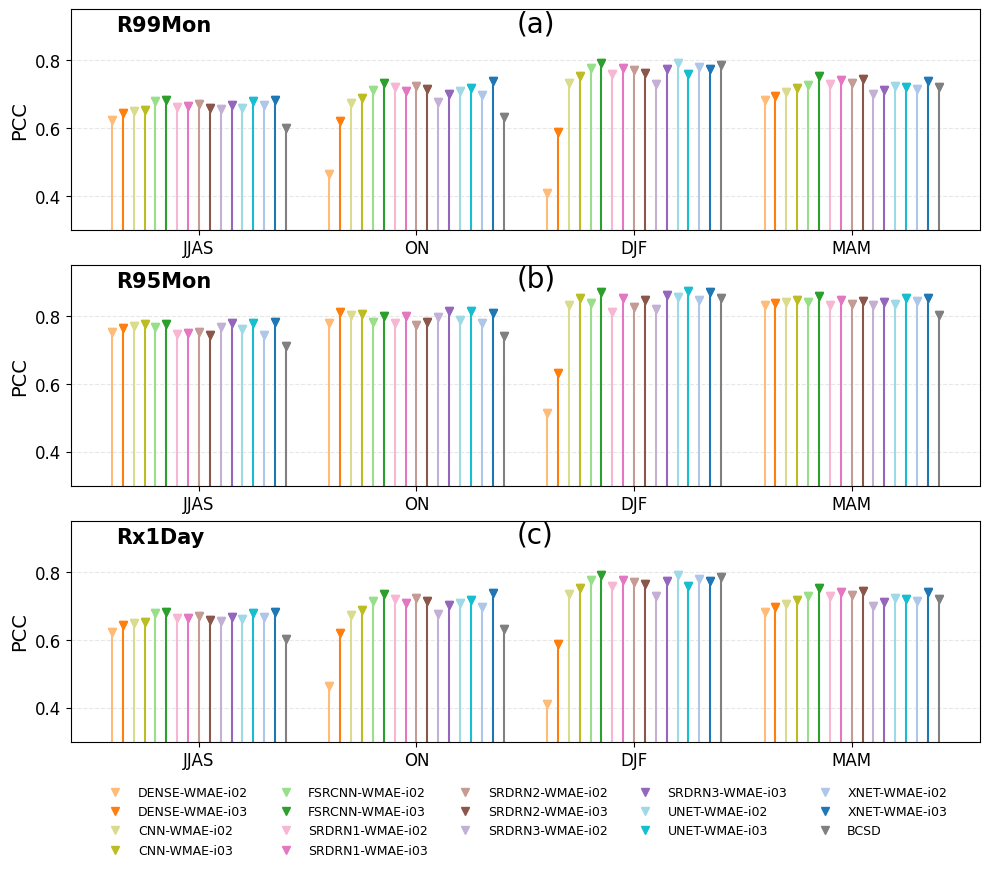

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def filter_df(df, column, string):
    """
    Filter the dataframe to select rows where the specified string is present 
    in the specified column.
    """
    return df[df[column].str.contains(string, na=False)]

def plot_stemplot_season_skills(ax, df, climate_indice, region_dict, methods, seasons, colors, metric="PCC", ylims=(0, 1)):
    """
    Plot a stem plot for seasonal skill scores across regions.
    """
    # ax.patch.set_facecolor('#f0f0f0')
    for i, (region, region_name) in enumerate(region_dict.items()):
        for j, method in enumerate(methods):
            # Collect metric values for each season
            season_values = [
                df[(df['ZONE'] == region) & (df['SEASON'] == season) & (df['LABEL'] == method)][metric].values[0]
                if not df[(df['ZONE'] == region) & (df['SEASON'] == season) & (df['LABEL'] == method)].empty else np.nan
                for season in seasons
            ]
            # Define x positions for the stems
            x = np.arange(len(seasons)) + j * 0.05  # Slight offset for each method
            
            # Plot stems with circles
            ax.stem(
                x,
                season_values,
                linefmt=colors[j],  # Line color
                markerfmt='v',      # Marker style
                basefmt=" ",        # No baseline
                label=method if i == 0 else "",
            )
            ax.plot(x, season_values, 'v', color=colors[j])  # Set marker color
            
        # Shift x-ticks to the center of the grouped stems
        tick_positions = np.arange(len(seasons)) + (len(methods) * 0.05) / 2 - 0.05 / 2
        ax.set_xticks(tick_positions)

        # Customize subplot
        ax.set_ylabel(metric, fontsize=14)
        ax.set_xticklabels(seasons)
        ax.tick_params(axis='both', labelsize=12)
        ax.set_ylim(ylims[0], ylims[1])
        ax.grid(True, axis='y', linestyle='--', alpha=0.3, zorder=0)

        ax.text(0.05, 0.9, climate_indice, transform=ax.transAxes, 
                fontsize=15, fontfamily='sans-serif', fontweight='bold')

################################### Read the data ###################################
CSV_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
climate_data = {
    "R99Mon": pd.read_csv(f'{CSV_PATH}/TABLE_EVALMETRICS_wSEASZONE_R99MON_IND_v1.0.0.csv'),
    "R95Mon": pd.read_csv(f'{CSV_PATH}/TABLE_EVALMETRICS_wSEASZONE_R95MON_IND_v1.0.0.csv'),
    "Rx1Day": pd.read_csv(f'{CSV_PATH}/TABLE_EVALMETRICS_wSEASZONE_RX1DAYMON_IND_v1.0.0.csv'),
}

# Define regions, seasons, methods, and colors
region_dict = {'IND': 'INDIA'}  # Add more regions
seasons = ['JJAS', 'ON', 'DJF', 'MAM']
methods = [
    'DENSE-WMAE-i02', 'DENSE-WMAE-i03', 
    'CNN-WMAE-i02', 'CNN-WMAE-i03', 
    'FSRCNN-WMAE-i02', 'FSRCNN-WMAE-i03', 
    'SRDRN1-WMAE-i02', 'SRDRN1-WMAE-i03',
    'SRDRN2-WMAE-i02', 'SRDRN2-WMAE-i03', 
    'SRDRN3-WMAE-i02', 'SRDRN3-WMAE-i03', 
    'UNET-WMAE-i02', 'UNET-WMAE-i03',
    'XNET-WMAE-i02', 'XNET-WMAE-i03', 
    'BCSD'
]

colors = [
    "#ffbb78", "#ff7f0e",  # Orange pair
    "#dbdb8d", "#bcbd22",  # Yellow-green pair
    "#98df8a", "#2ca02c",  # Green pair
    "#f7b6d2", "#e377c2",  # Pink pair
    "#c49c94", "#8c564b",  # Brown pair
    "#c5b0d5", "#9467bd",  # Purple pair
    "#9edae5", "#17becf",  # Teal pair 
    "#aec7e8", "#1f77b4",  # Blue pair
    "grey"
    # "#2F4F4F",
    ]

# Create figure
fig, axes = plt.subplots(3, 1, figsize=(10, 10))
fig.subplots_adjust(hspace=0.5, wspace=0.2)

# Plot stem plots for each climate index
for ax, (climate_indice, df) in zip(axes.flat, climate_data.items()):
    plot_stemplot_season_skills(ax, df, climate_indice, region_dict, methods, seasons, colors, ylims=(0.3, 0.95))

# # Add single legend at the bottom
# fig.legend(methods, loc='center', fontsize=11, bbox_to_anchor=(0.52, 0.17), 
#            ncol=5, frameon=False)
fig.legend(methods, loc='center', fontsize=9, bbox_to_anchor=(0.53, 0.17), 
           ncol=5, frameon=False)

for i, ax in enumerate(axes.flat):
    ax.text(0.49, 0.9, f"({chr(97 + i)})", transform=ax.transAxes, 
            fontsize=20, fontweight='normal')

# Adjust layout and show the plot
plt.tight_layout()
plt.subplots_adjust(bottom=0.25)

# SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
# plt.savefig(f'{SAVE_PATH}/Figure_StemPlot_Season_Skill_Indices.png', 
#             format='png', dpi=600, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()


# Supplementary Information

## Figure SX: Spatial Map - PBIAS

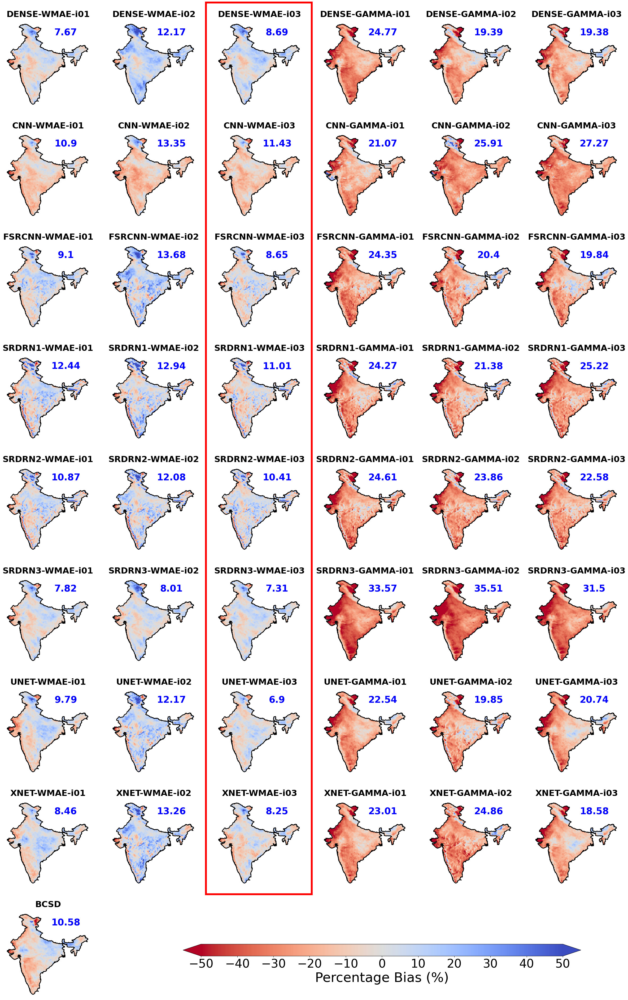

In [123]:
## Masked spatial plots
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import geopandas as gpd
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.patches import PathPatch
import cmaps
from shapely.geometry import box
from matplotlib.gridspec import GridSpec
import matplotlib.patches as patches

#################### Calculate metric value ####################

def abs_mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(abs(arr))
    return arr

def mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(arr)
    return arr

def create_axes(nrows, ncols, figsize=(13,13), hspace=None, wspace=None):
    
    # Create figure and axis objects
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows, ncols, figure=fig, hspace=hspace) #  , wspace=wspace hspace=0.5, wspace=0

    # Create subplots with specific projection using GridSpec
    axes = []
    for i in range(nrows):
        for j in range(ncols):
            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
            axes.append(ax)
    # fig.tight_layout()

    # fig.tight_layout(pad=0) 
    # plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
    return fig, axes

def get_lon_lat(ds, data_var):
    """
    Extract longitude and latitude values from 
    xarray array and variable name
    """
    
    data_coords = ds[data_var].coords
    lon_var, lat_var = None, None

    for coord_name, coord_var in data_coords.items():
        if 'longitude' in coord_var.standard_name or 'lon' in coord_var.standard_name:
            lon_var = coord_var
        elif 'latitude' in coord_var.standard_name or 'lat' in coord_var.standard_name:
            lat_var = coord_var

    return lon_var, lat_var

def filter_df(df, column, string):
    """ Select and merge rows from the dataframe where the specified string is present in the specified column""" 
    filtered_df = df[df[column].str.contains(string, na=False)]
    return filtered_df

def df_to_dict(df, key_col, value_cols):
    """
    Convert multiple columns of a DataFrame into a dictionary with lists of values.
    """
    return df.set_index(key_col)[value_cols].T.to_dict('list')

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray*maskarray

def my_custom_subplot(ax, ds, lonlat, cmap, vmin, vmax, 
                      title=None, ylabel=None, 
                      text=None, text_loc=None, 
                      overlay_pval=False, pval_data=None, 
                     ):
    
    # Plot data ds1 with inverted y-axis
    im = ax.imshow(ds, 
                   cmap=cmap, 
                   alpha=1.0, 
                   vmin=vmin, 
                   vmax=vmax,
                   extent=[lonlat[0].data.min(), 
                           lonlat[0].data.max(),
                           lonlat[1].data.max(),
                           lonlat[1].data.min()], 
                   origin='upper', 
                   transform=ccrs.PlateCarree()
                  )
    # ---------------
    # Add coastlines
    # ---------------
    # ax.coastlines(resolution='50m')
    ax.invert_yaxis()
    
    # --------------------
    # Add India shapefile
    # --------------------
    shapefile_path = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES/India.shp"         
    shapefile_df = gpd.read_file(shapefile_path)
    countries = shapefile_df['geometry']
    ax.add_geometries(countries, ccrs.PlateCarree(), facecolor='none', edgecolor='black', linewidth=2)

    # -----------------------
    # Overlay pvalue hatches 
    # -----------------------
    if overlay_pval:

        if pval_data is None:
            raise ValueError('You have asked to plot pval stipples, but no data passed.')
        else:
            significance_threshold = 0.01
            significant_mask = pval_data <= significance_threshold
        

    
        # Overlay hatched polygons for significant correlations
        bbox = box(lonlat[0].data.min(), lonlat[1].data.min(), lonlat[0].data.max(), lonlat[1].data.max())
        for geom in countries:
            if bbox.intersects(geom):
                masked_geom = geom.intersection(bbox)
                if masked_geom.is_empty:
                    continue   
                if significant_mask.sel(longitude=slice(masked_geom.bounds[0], masked_geom.bounds[2]),
                                         latitude=slice(masked_geom.bounds[1], masked_geom.bounds[3])).any():
                    ax.add_geometries([masked_geom], 
                                      ccrs.PlateCarree(), 
                                      facecolor='none', 
                                      edgecolor='k', 
                                      hatch='.', 
                                      linewidth=1)
                    continue
    
    # -------------------------
    # Add text inside the plot
    # -------------------------
    if text is not None:
        ax.text(text_loc[0], text_loc[1], 
                text, 
                transform=ax.transAxes, ha='center', va='center', 
                fontsize=25, fontweight='bold', 
                color='blue', backgroundcolor=None, bbox=None)

    # ------------------------------
    # Additional plot customization
    # ------------------------------
    ax.set_title(title, loc='center', fontsize=23, fontweight='semibold')
    ax.set_ylabel(ylabel, loc='center', fontsize=22, fontweight='semibold')
    ax.set_xticks(np.arange(70, 100, 5), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(10, 40, 5), crs=ccrs.PlateCarree())
    lon_formatter = LongitudeFormatter(zero_direction_label=False)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.tick_params(axis="both", labelsize=12)

    ax.set_axis_off()
    
    return im


#-----------------------------------------------------------------------
######################## Main run control below ########################
#-----------------------------------------------------------------------

# Create axes for subplots and set lonlat limits
fig, axes = create_axes(nrows=9, ncols=6, figsize=(30,45), hspace=0.1, wspace=None)
lon_l, lat_l = (70, 98, 5), (10, 38, 5)

# Load datafiles
DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
d = xr.open_dataset(f'{DPATH}/EVAL_METRICS_SPATIAL_v1.nc')
df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")

m = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES/India.nc')

varname = 'PBIAS'
cbar_label = 'Percentage Bias (%)'

DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")
df = filter_df(df, column='ZONE_NAME', string="INDIA")
# df = filter_df(df, column='EXP_ID', string="L01")

exp_dict = df_to_dict(df, key_col="EXP_ID", value_cols=["LABEL", varname])

# if 'C01' in exp_dict:
#     del exp_dict['C01']  # This will safely remove 'b' without changing the dictionary to a lis

#-----------------------------------------------------------------------
############################# Edit below ###############################
#-----------------------------------------------------------------------

cmap = 'coolwarm_r' #cmaps.GMT_panoply
vmin, vmax, inc = -50, 50, 10



for i, (exp_id, (title, metric_val)) in enumerate(exp_dict.items()):
    
    my_var = f'{exp_id}_{varname}'
    ds_f = mask_array(d[my_var].squeeze(), m['mask'].squeeze())
    im = my_custom_subplot(ax=axes[i], 
                    ds=ds_f,
                    lonlat=get_lon_lat(d, my_var), 
                    cmap=cmap, vmin=vmin, vmax=vmax,
                    text=abs_mean(ds_f.data).round(2), #round(metric_val, 3), #mean(d[my_var][:].data).round(4),
                    text_loc=[0.7, 0.85],
                    ylabel=None,
                    title=title,
                    overlay_pval=False,
                    pval_data = d[f'{exp_id}_TSTAT_PVAL'],
                    )
    
#----------------------------------------------------
# Add the rectangular box to the Figure object
#----------------------------------------------------

# Calculate the rectangle position and size to cover the third column
x = axes[2].get_position().xmin - 0.012 # x position of the third column
y = axes[44].get_position().ymin  - 0.057  # Shift down by decreasing y position
width = axes[2].get_position().width * 1.2  # width of the third column subplot
height = (axes[2].get_position().ymax  * 1.1) - (axes[44].get_position().ymin * 1.1)  # total height of the third column

# Add the rectangle to the figure using fig.patches
rect = patches.Rectangle((x, y), width, height, linewidth=5, edgecolor='r', facecolor='none', transform=fig.transFigure)
fig.patches.append(rect)  # Add patch to fig.patches

#----------------------------------------------------
# Uncomment below code snippet to set horizontal cbar 
#----------------------------------------------------

fig.subplots_adjust(bottom=0.05)
cbar_ax = fig.add_axes([0.35, 0.09, 0.5, 0.01])
cb = fig.colorbar(im, cax=cbar_ax, 
                  ticks=np.arange(vmin, vmax+inc, inc), 
                  orientation="horizontal", 
                  extend='both')
cb.ax.tick_params(labelsize=32)
cb.set_label(cbar_label, 
             rotation = 0, 
             fontsize = 36, 
             fontweight='normal') 

for ax in axes[-5:]:
    ax.axis('off')

# SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
# plt.savefig(f'{SAVE_PATH}/FigureSX_SpatialMap_{varname.upper()}.png', 
#             format='png', dpi=400, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()


## Figure: R90BIAS

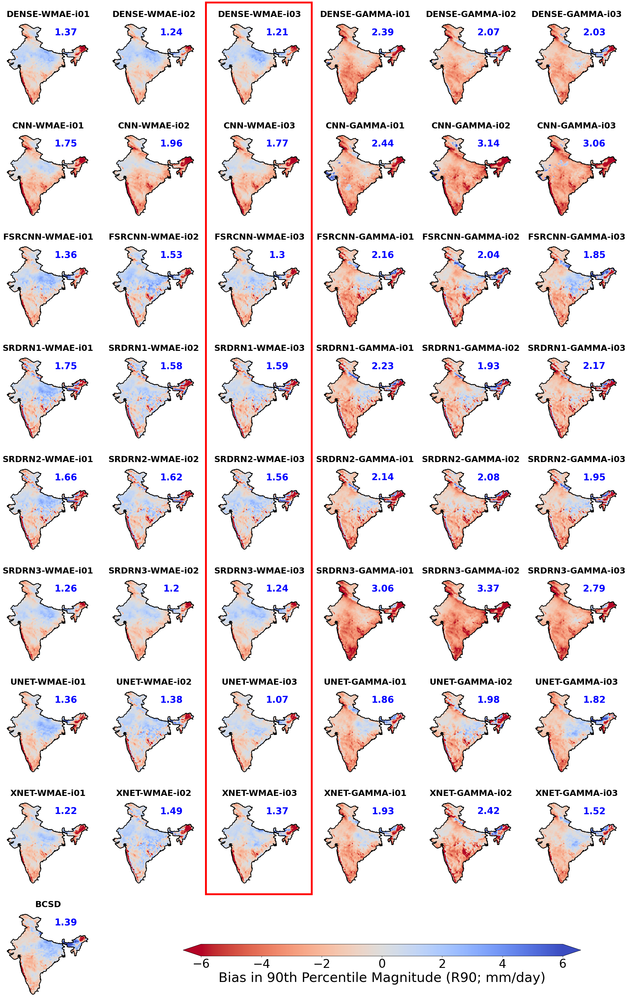

In [12]:
## Masked spatial plots
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import geopandas as gpd
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.patches import PathPatch
import cmaps
from shapely.geometry import box
from matplotlib.gridspec import GridSpec
import matplotlib.patches as patches

#################### Calculate metric value ####################

def abs_mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(abs(arr))
    return arr

def mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(arr)
    return arr

def create_axes(nrows, ncols, figsize=(13,13), hspace=None, wspace=None):
    
    # Create figure and axis objects
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows, ncols, figure=fig, hspace=hspace) #  , wspace=wspace hspace=0.5, wspace=0

    # Create subplots with specific projection using GridSpec
    axes = []
    for i in range(nrows):
        for j in range(ncols):
            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
            axes.append(ax)
    # fig.tight_layout()

    # fig.tight_layout(pad=0) 
    # plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
    return fig, axes

def get_lon_lat(ds, data_var):
    """
    Extract longitude and latitude values from 
    xarray array and variable name
    """
    
    data_coords = ds[data_var].coords
    lon_var, lat_var = None, None

    for coord_name, coord_var in data_coords.items():
        if 'longitude' in coord_var.standard_name or 'lon' in coord_var.standard_name:
            lon_var = coord_var
        elif 'latitude' in coord_var.standard_name or 'lat' in coord_var.standard_name:
            lat_var = coord_var

    return lon_var, lat_var

def filter_df(df, column, string):
    """ Select and merge rows from the dataframe where the specified string is present in the specified column""" 
    filtered_df = df[df[column].str.contains(string, na=False)]
    return filtered_df

def df_to_dict(df, key_col, value_cols):
    """
    Convert multiple columns of a DataFrame into a dictionary with lists of values.
    """
    return df.set_index(key_col)[value_cols].T.to_dict('list')

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray*maskarray

def my_custom_subplot(ax, ds, lonlat, cmap, vmin, vmax, 
                      title=None, ylabel=None, 
                      text=None, text_loc=None, 
                      overlay_pval=False, pval_data=None, 
                     ):
    
    # Plot data ds1 with inverted y-axis
    im = ax.imshow(ds, 
                   cmap=cmap, 
                   alpha=1.0, 
                   vmin=vmin, 
                   vmax=vmax,
                   extent=[lonlat[0].data.min(), 
                           lonlat[0].data.max(),
                           lonlat[1].data.max(),
                           lonlat[1].data.min()], 
                   origin='upper', 
                   transform=ccrs.PlateCarree()
                  )
    # ---------------
    # Add coastlines
    # ---------------
    # ax.coastlines(resolution='50m')
    ax.invert_yaxis()
    
    # --------------------
    # Add India shapefile
    # --------------------
    shapefile_path = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES/India.shp"         
    shapefile_df = gpd.read_file(shapefile_path)
    countries = shapefile_df['geometry']
    ax.add_geometries(countries, ccrs.PlateCarree(), facecolor='none', edgecolor='black', linewidth=2)

    # -----------------------
    # Overlay pvalue hatches 
    # -----------------------
    if overlay_pval:

        if pval_data is None:
            raise ValueError('You have asked to plot pval stipples, but no data passed.')
        else:
            significance_threshold = 0.01
            significant_mask = pval_data <= significance_threshold
        

    
        # Overlay hatched polygons for significant correlations
        bbox = box(lonlat[0].data.min(), lonlat[1].data.min(), lonlat[0].data.max(), lonlat[1].data.max())
        for geom in countries:
            if bbox.intersects(geom):
                masked_geom = geom.intersection(bbox)
                if masked_geom.is_empty:
                    continue   
                if significant_mask.sel(longitude=slice(masked_geom.bounds[0], masked_geom.bounds[2]),
                                         latitude=slice(masked_geom.bounds[1], masked_geom.bounds[3])).any():
                    ax.add_geometries([masked_geom], 
                                      ccrs.PlateCarree(), 
                                      facecolor='none', 
                                      edgecolor='k', 
                                      hatch='.', 
                                      linewidth=1)
                    continue
    
    # -------------------------
    # Add text inside the plot
    # -------------------------
    if text is not None:
        ax.text(text_loc[0], text_loc[1], 
                text, 
                transform=ax.transAxes, ha='center', va='center', 
                fontsize=25, fontweight='bold', 
                color='blue', backgroundcolor=None, bbox=None)

    # ------------------------------
    # Additional plot customization
    # ------------------------------
    ax.set_title(title, loc='center', fontsize=23, fontweight='semibold')
    ax.set_ylabel(ylabel, loc='center', fontsize=22, fontweight='semibold')
    ax.set_xticks(np.arange(70, 100, 5), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(10, 40, 5), crs=ccrs.PlateCarree())
    lon_formatter = LongitudeFormatter(zero_direction_label=False)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.tick_params(axis="both", labelsize=12)

    ax.set_axis_off()
    
    return im


#-----------------------------------------------------------------------
######################## Main run control below ########################
#-----------------------------------------------------------------------

# Create axes for subplots and set lonlat limits
fig, axes = create_axes(nrows=9, ncols=6, figsize=(30,45), hspace=0.1, wspace=None)
lon_l, lat_l = (70, 98, 5), (10, 38, 5)

# Load datafiles
DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
d = xr.open_dataset(f'{DPATH}/EVAL_METRICS_SPATIAL_R90BIAS.nc')
df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")

m = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES/India.nc')

varname = 'R90BIAS'
cbar_label = 'Bias in 90th Percentile Magnitude (R90; mm/day)'

DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")
df = filter_df(df, column='ZONE_NAME', string="INDIA")
# df = filter_df(df, column='EXP_ID', string="L01")

exp_dict = df_to_dict(df, key_col="EXP_ID", value_cols=["LABEL", "PBIAS"])

# if 'C01' in exp_dict:
#     del exp_dict['C01']  # This will safely remove 'b' without changing the dictionary to a lis

#-----------------------------------------------------------------------
############################# Edit below ###############################
#-----------------------------------------------------------------------

cmap = 'coolwarm_r' #cmaps.GMT_panoply
vmin, vmax, inc = -6, 6, 2

for i, (exp_id, (title, metric_val)) in enumerate(exp_dict.items()):
    
    my_var = f'{exp_id}_{varname}'
    ds_f = mask_array(d[my_var].squeeze(), m['mask'].squeeze())
    im = my_custom_subplot(ax=axes[i], 
                    ds=ds_f,
                    lonlat=get_lon_lat(d, my_var), 
                    cmap=cmap, vmin=vmin, vmax=vmax,
                    text=abs_mean(ds_f.data).round(2), #round(metric_val, 3), #mean(d[my_var][:].data).round(4),
                    text_loc=[0.7, 0.85],
                    ylabel=None,
                    title=title,
                    overlay_pval=False,
                    pval_data = None #d[f'{exp_id}_TSTAT_PVAL'],
                    )
    
#----------------------------------------------------
# Add the rectangular box to the Figure object
#----------------------------------------------------

# Calculate the rectangle position and size to cover the third column
x = axes[2].get_position().xmin - 0.012 # x position of the third column
y = axes[44].get_position().ymin  - 0.057  # Shift down by decreasing y position
width = axes[2].get_position().width * 1.2  # width of the third column subplot
height = (axes[2].get_position().ymax  * 1.1) - (axes[44].get_position().ymin * 1.1)  # total height of the third column

# Add the rectangle to the figure using fig.patches
rect = patches.Rectangle((x, y), width, height, linewidth=5, edgecolor='r', facecolor='none', transform=fig.transFigure)
fig.patches.append(rect)  # Add patch to fig.patches

#----------------------------------------------------
# Uncomment below code snippet to set horizontal cbar 
#----------------------------------------------------

fig.subplots_adjust(bottom=0.05)
cbar_ax = fig.add_axes([0.35, 0.09, 0.5, 0.01])
cb = fig.colorbar(im, cax=cbar_ax, 
                  ticks=np.arange(vmin, vmax+inc, inc), 
                  orientation="horizontal", 
                  extend='both')
cb.ax.tick_params(labelsize=32)
cb.set_label(cbar_label, 
             rotation = 0, 
             fontsize = 36, 
             fontweight='normal') 

for ax in axes[-5:]:
    ax.axis('off')

SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
plt.savefig(f'{SAVE_PATH}/FigureSX_SpatialMap_{varname.upper()}.png', 
            format='png', dpi=400, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()


## Figure: R95BIAS

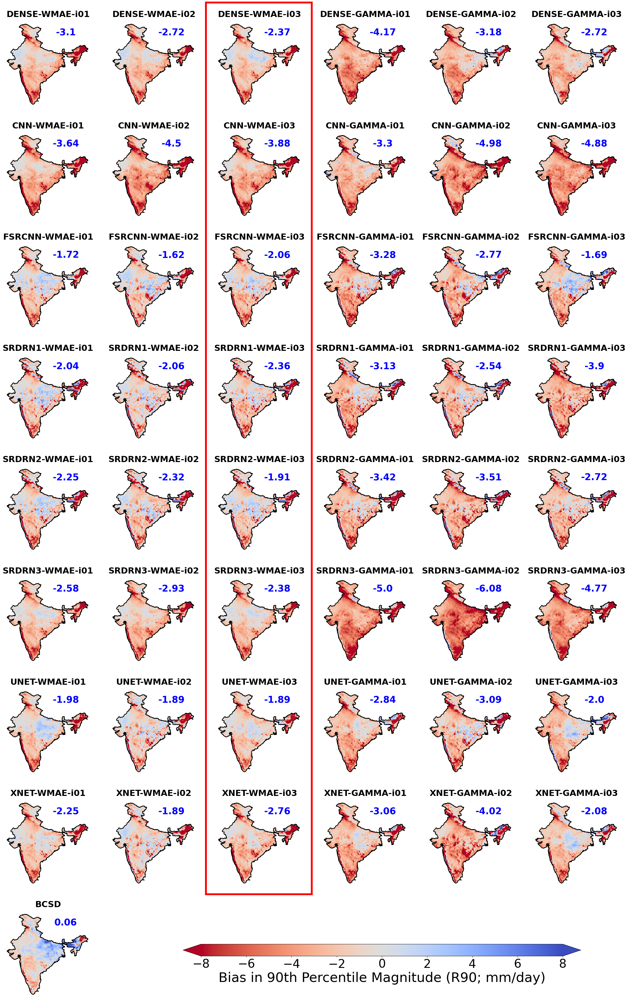

In [14]:
## Masked spatial plots
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import geopandas as gpd
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.patches import PathPatch
import cmaps
from shapely.geometry import box
from matplotlib.gridspec import GridSpec
import matplotlib.patches as patches

#################### Calculate metric value ####################

def abs_mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(abs(arr))
    return arr

def mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(arr)
    return arr

def create_axes(nrows, ncols, figsize=(13,13), hspace=None, wspace=None):
    
    # Create figure and axis objects
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows, ncols, figure=fig, hspace=hspace) #  , wspace=wspace hspace=0.5, wspace=0

    # Create subplots with specific projection using GridSpec
    axes = []
    for i in range(nrows):
        for j in range(ncols):
            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
            axes.append(ax)
    # fig.tight_layout()

    # fig.tight_layout(pad=0) 
    # plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
    return fig, axes

def get_lon_lat(ds, data_var):
    """
    Extract longitude and latitude values from 
    xarray array and variable name
    """
    
    data_coords = ds[data_var].coords
    lon_var, lat_var = None, None

    for coord_name, coord_var in data_coords.items():
        if 'longitude' in coord_var.standard_name or 'lon' in coord_var.standard_name:
            lon_var = coord_var
        elif 'latitude' in coord_var.standard_name or 'lat' in coord_var.standard_name:
            lat_var = coord_var

    return lon_var, lat_var

def filter_df(df, column, string):
    """ Select and merge rows from the dataframe where the specified string is present in the specified column""" 
    filtered_df = df[df[column].str.contains(string, na=False)]
    return filtered_df

def df_to_dict(df, key_col, value_cols):
    """
    Convert multiple columns of a DataFrame into a dictionary with lists of values.
    """
    return df.set_index(key_col)[value_cols].T.to_dict('list')

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray*maskarray

def my_custom_subplot(ax, ds, lonlat, cmap, vmin, vmax, 
                      title=None, ylabel=None, 
                      text=None, text_loc=None, 
                      overlay_pval=False, pval_data=None, 
                     ):
    
    # Plot data ds1 with inverted y-axis
    im = ax.imshow(ds, 
                   cmap=cmap, 
                   alpha=1.0, 
                   vmin=vmin, 
                   vmax=vmax,
                   extent=[lonlat[0].data.min(), 
                           lonlat[0].data.max(),
                           lonlat[1].data.max(),
                           lonlat[1].data.min()], 
                   origin='upper', 
                   transform=ccrs.PlateCarree()
                  )
    # ---------------
    # Add coastlines
    # ---------------
    # ax.coastlines(resolution='50m')
    ax.invert_yaxis()
    
    # --------------------
    # Add India shapefile
    # --------------------
    shapefile_path = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES/India.shp"         
    shapefile_df = gpd.read_file(shapefile_path)
    countries = shapefile_df['geometry']
    ax.add_geometries(countries, ccrs.PlateCarree(), facecolor='none', edgecolor='black', linewidth=2)

    # -----------------------
    # Overlay pvalue hatches 
    # -----------------------
    if overlay_pval:

        if pval_data is None:
            raise ValueError('You have asked to plot pval stipples, but no data passed.')
        else:
            significance_threshold = 0.01
            significant_mask = pval_data <= significance_threshold
        

    
        # Overlay hatched polygons for significant correlations
        bbox = box(lonlat[0].data.min(), lonlat[1].data.min(), lonlat[0].data.max(), lonlat[1].data.max())
        for geom in countries:
            if bbox.intersects(geom):
                masked_geom = geom.intersection(bbox)
                if masked_geom.is_empty:
                    continue   
                if significant_mask.sel(longitude=slice(masked_geom.bounds[0], masked_geom.bounds[2]),
                                         latitude=slice(masked_geom.bounds[1], masked_geom.bounds[3])).any():
                    ax.add_geometries([masked_geom], 
                                      ccrs.PlateCarree(), 
                                      facecolor='none', 
                                      edgecolor='k', 
                                      hatch='.', 
                                      linewidth=1)
                    continue
    
    # -------------------------
    # Add text inside the plot
    # -------------------------
    if text is not None:
        ax.text(text_loc[0], text_loc[1], 
                text, 
                transform=ax.transAxes, ha='center', va='center', 
                fontsize=25, fontweight='bold', 
                color='blue', backgroundcolor=None, bbox=None)

    # ------------------------------
    # Additional plot customization
    # ------------------------------
    ax.set_title(title, loc='center', fontsize=23, fontweight='semibold')
    ax.set_ylabel(ylabel, loc='center', fontsize=22, fontweight='semibold')
    ax.set_xticks(np.arange(70, 100, 5), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(10, 40, 5), crs=ccrs.PlateCarree())
    lon_formatter = LongitudeFormatter(zero_direction_label=False)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.tick_params(axis="both", labelsize=12)

    ax.set_axis_off()
    
    return im


#-----------------------------------------------------------------------
######################## Main run control below ########################
#-----------------------------------------------------------------------

# Create axes for subplots and set lonlat limits
fig, axes = create_axes(nrows=9, ncols=6, figsize=(30,45), hspace=0.1, wspace=None)
lon_l, lat_l = (70, 98, 5), (10, 38, 5)

# Load datafiles
DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
d = xr.open_dataset(f'{DPATH}/EVAL_METRICS_SPATIAL_R95BIAS.nc')
df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")

m = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES/India.nc')

varname = 'R95BIAS'
cbar_label = 'Bias in 90th Percentile Magnitude (R90; mm/day)'

DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")
df = filter_df(df, column='ZONE_NAME', string="INDIA")
# df = filter_df(df, column='EXP_ID', string="L01")

exp_dict = df_to_dict(df, key_col="EXP_ID", value_cols=["LABEL", "PBIAS"])

# if 'C01' in exp_dict:
#     del exp_dict['C01']  # This will safely remove 'b' without changing the dictionary to a lis

#-----------------------------------------------------------------------
############################# Edit below ###############################
#-----------------------------------------------------------------------

cmap = 'coolwarm_r' #cmaps.GMT_panoply
vmin, vmax, inc = -8, 8, 2

for i, (exp_id, (title, metric_val)) in enumerate(exp_dict.items()):
    
    my_var = f'{exp_id}_{varname}'
    ds_f = mask_array(d[my_var].squeeze(), m['mask'].squeeze())
    im = my_custom_subplot(ax=axes[i], 
                    ds=ds_f,
                    lonlat=get_lon_lat(d, my_var), 
                    cmap=cmap, vmin=vmin, vmax=vmax,
                    text=mean(ds_f.data).round(2), #round(metric_val, 3), #mean(d[my_var][:].data).round(4),
                    text_loc=[0.7, 0.85],
                    ylabel=None,
                    title=title,
                    overlay_pval=False,
                    pval_data = None #d[f'{exp_id}_TSTAT_PVAL'],
                    )
    
#----------------------------------------------------
# Add the rectangular box to the Figure object
#----------------------------------------------------

# Calculate the rectangle position and size to cover the third column
x = axes[2].get_position().xmin - 0.012 # x position of the third column
y = axes[44].get_position().ymin  - 0.057  # Shift down by decreasing y position
width = axes[2].get_position().width * 1.2  # width of the third column subplot
height = (axes[2].get_position().ymax  * 1.1) - (axes[44].get_position().ymin * 1.1)  # total height of the third column

# Add the rectangle to the figure using fig.patches
rect = patches.Rectangle((x, y), width, height, linewidth=5, edgecolor='r', facecolor='none', transform=fig.transFigure)
fig.patches.append(rect)  # Add patch to fig.patches

#----------------------------------------------------
# Uncomment below code snippet to set horizontal cbar 
#----------------------------------------------------

fig.subplots_adjust(bottom=0.05)
cbar_ax = fig.add_axes([0.35, 0.09, 0.5, 0.01])
cb = fig.colorbar(im, cax=cbar_ax, 
                  ticks=np.arange(vmin, vmax+inc, inc), 
                  orientation="horizontal", 
                  extend='both')
cb.ax.tick_params(labelsize=32)
cb.set_label(cbar_label, 
             rotation = 0, 
             fontsize = 36, 
             fontweight='normal') 

for ax in axes[-5:]:
    ax.axis('off')

# SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
# plt.savefig(f'{SAVE_PATH}/FigureSX_SpatialMap_{varname.upper()}.png', 
#             format='png', dpi=400, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()


## Figure: Spatial Map of Evaluation Metrics - PCC

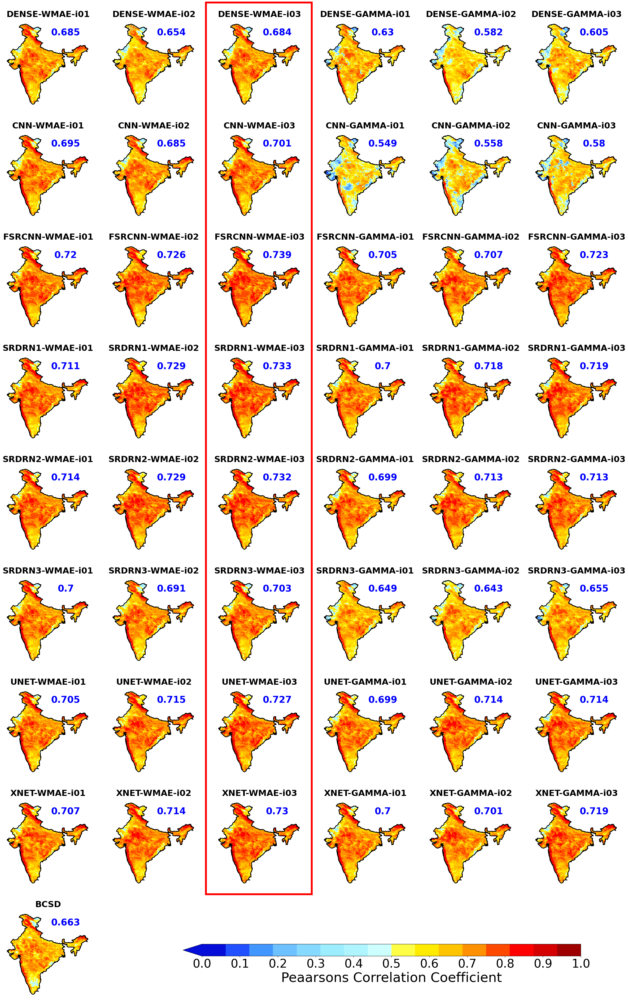

In [124]:
## Masked spatial plots
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import geopandas as gpd
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.patches import PathPatch
import cmaps
from shapely.geometry import box
from matplotlib.gridspec import GridSpec
import matplotlib.patches as patches

#################### Calculate metric value ####################

def abs_mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(abs(arr))
    return arr

def mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(arr)
    return arr

def create_axes(nrows, ncols, figsize=(13,13), hspace=None, wspace=None):
    
    # Create figure and axis objects
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows, ncols, figure=fig, hspace=hspace) #  , wspace=wspace hspace=0.5, wspace=0

    # Create subplots with specific projection using GridSpec
    axes = []
    for i in range(nrows):
        for j in range(ncols):
            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
            axes.append(ax)
    # fig.tight_layout()

    # fig.tight_layout(pad=0) 
    # plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
    return fig, axes

def get_lon_lat(ds, data_var):
    """
    Extract longitude and latitude values from 
    xarray array and variable name
    """
    
    data_coords = ds[data_var].coords
    lon_var, lat_var = None, None

    for coord_name, coord_var in data_coords.items():
        if 'longitude' in coord_var.standard_name or 'lon' in coord_var.standard_name:
            lon_var = coord_var
        elif 'latitude' in coord_var.standard_name or 'lat' in coord_var.standard_name:
            lat_var = coord_var

    return lon_var, lat_var

def filter_df(df, column, string):
    """ Select and merge rows from the dataframe where the specified string is present in the specified column""" 
    filtered_df = df[df[column].str.contains(string, na=False)]
    return filtered_df

def df_to_dict(df, key_col, value_cols):
    """
    Convert multiple columns of a DataFrame into a dictionary with lists of values.
    """
    return df.set_index(key_col)[value_cols].T.to_dict('list')

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray*maskarray

def my_custom_subplot(ax, ds, lonlat, cmap, vmin, vmax, 
                      title=None, ylabel=None, 
                      text=None, text_loc=None, 
                      overlay_pval=False, pval_data=None, 
                     ):
    
    # Plot data ds1 with inverted y-axis
    im = ax.imshow(ds, 
                   cmap=cmap, 
                   alpha=1.0, 
                   vmin=vmin, 
                   vmax=vmax,
                   extent=[lonlat[0].data.min(), 
                           lonlat[0].data.max(),
                           lonlat[1].data.max(),
                           lonlat[1].data.min()], 
                   origin='upper', 
                   transform=ccrs.PlateCarree()
                  )
    # ---------------
    # Add coastlines
    # ---------------
    # ax.coastlines(resolution='50m')
    ax.invert_yaxis()
    
    # --------------------
    # Add India shapefile
    # --------------------
    shapefile_path = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES/India.shp"         
    shapefile_df = gpd.read_file(shapefile_path)
    countries = shapefile_df['geometry']
    ax.add_geometries(countries, ccrs.PlateCarree(), facecolor='none', edgecolor='black', linewidth=2)

    # -----------------------
    # Overlay pvalue hatches 
    # -----------------------
    if overlay_pval:

        if pval_data is None:
            raise ValueError('You have asked to plot pval stipples, but no data passed.')
        else:
            significance_threshold = 0.01
            significant_mask = pval_data <= significance_threshold
        

    
        # Overlay hatched polygons for significant correlations
        bbox = box(lonlat[0].data.min(), lonlat[1].data.min(), lonlat[0].data.max(), lonlat[1].data.max())
        for geom in countries:
            if bbox.intersects(geom):
                masked_geom = geom.intersection(bbox)
                if masked_geom.is_empty:
                    continue   
                if significant_mask.sel(longitude=slice(masked_geom.bounds[0], masked_geom.bounds[2]),
                                         latitude=slice(masked_geom.bounds[1], masked_geom.bounds[3])).any():
                    ax.add_geometries([masked_geom], 
                                      ccrs.PlateCarree(), 
                                      facecolor='none', 
                                      edgecolor='k', 
                                      hatch='.', 
                                      linewidth=1)
                    continue
    
    # -------------------------
    # Add text inside the plot
    # -------------------------
    if text is not None:
        ax.text(text_loc[0], text_loc[1], 
                text, 
                transform=ax.transAxes, ha='center', va='center', 
                fontsize=25, fontweight='bold', 
                color='blue', backgroundcolor=None, bbox=None)

    # ------------------------------
    # Additional plot customization
    # ------------------------------
    ax.set_title(title, loc='center', fontsize=23, fontweight='semibold')
    ax.set_ylabel(ylabel, loc='center', fontsize=22, fontweight='semibold')
    ax.set_xticks(np.arange(70, 100, 5), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(10, 40, 5), crs=ccrs.PlateCarree())
    lon_formatter = LongitudeFormatter(zero_direction_label=False)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.tick_params(axis="both", labelsize=12)

    ax.set_axis_off()
    
    return im


#-----------------------------------------------------------------------
######################## Main run control below ########################
#-----------------------------------------------------------------------

# Create axes for subplots and set lonlat limits
fig, axes = create_axes(nrows=9, ncols=6, figsize=(30,45), hspace=0.1, wspace=None)
lon_l, lat_l = (70, 98, 5), (10, 38, 5)

# Load datafiles
DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
d = xr.open_dataset(f'{DPATH}/EVAL_METRICS_SPATIAL_v1.nc')
df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")

m = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES/India.nc')

varname = 'PCC'
cbar_label = 'Peaarsons Correlation Coefficient'

DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")
df = filter_df(df, column='ZONE_NAME', string="INDIA")
# df = filter_df(df, column='EXP_ID', string="L01")

exp_dict = df_to_dict(df, key_col="EXP_ID", value_cols=["LABEL", varname])

#-----------------------------------------------------------------------
############################# Edit below ###############################
#-----------------------------------------------------------------------

cmap = cmaps.GMT_panoply
vmin, vmax, inc = 0, 1, 0.1

for i, (exp_id, (title, metric_val)) in enumerate(exp_dict.items()):
    
    my_var = f'{exp_id}_{varname}'
    ds_f = mask_array(d[my_var].squeeze(), m['mask'].squeeze())
    im = my_custom_subplot(ax=axes[i], 
                    ds=ds_f,
                    lonlat=get_lon_lat(d, my_var), 
                    cmap=cmap, vmin=vmin, vmax=vmax,
                    text=abs_mean(ds_f.data).round(3), #round(metric_val, 3), #mean(d[my_var][:].data).round(4),
                    text_loc=[0.7, 0.85],
                    ylabel=None,
                    title=title,
                    overlay_pval=False,
                    pval_data = d[f'{exp_id}_TSTAT_PVAL'],
                    )
    
#----------------------------------------------------
# Add the rectangular box to the Figure object
#----------------------------------------------------

# Calculate the rectangle position and size to cover the third column
x = axes[2].get_position().xmin - 0.012 # x position of the third column
y = axes[44].get_position().ymin  - 0.057  # Shift down by decreasing y position
width = axes[2].get_position().width * 1.2  # width of the third column subplot
height = (axes[2].get_position().ymax  * 1.1) - (axes[44].get_position().ymin * 1.1)  # total height of the third column

# Add the rectangle to the figure using fig.patches
rect = patches.Rectangle((x, y), width, height, linewidth=5, edgecolor='r', facecolor='none', transform=fig.transFigure)
fig.patches.append(rect)  # Add patch to fig.patches

#----------------------------------------------------
# Uncomment below code snippet to set horizontal cbar 
#----------------------------------------------------

fig.subplots_adjust(bottom=0.05)
cbar_ax = fig.add_axes([0.35, 0.09, 0.5, 0.01])
cb = fig.colorbar(im, cax=cbar_ax, 
                  ticks=np.arange(vmin, vmax+inc, inc), 
                  orientation="horizontal", 
                  extend='min')
cb.ax.tick_params(labelsize=32)
cb.set_label(cbar_label, 
             rotation = 0, 
             fontsize = 36, 
             fontweight='normal') 

for ax in axes[-5:]:
    ax.axis('off')

SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS'
plt.savefig(f'{SAVE_DIR}/FigureSX_SpatialMap_{varname.upper()}.png', format='png', dpi=400, bbox_inches='tight',facecolor='w', edgecolor='w')
plt.show()



## Figure: Spatial Map of Evaluation Metrics - ACC

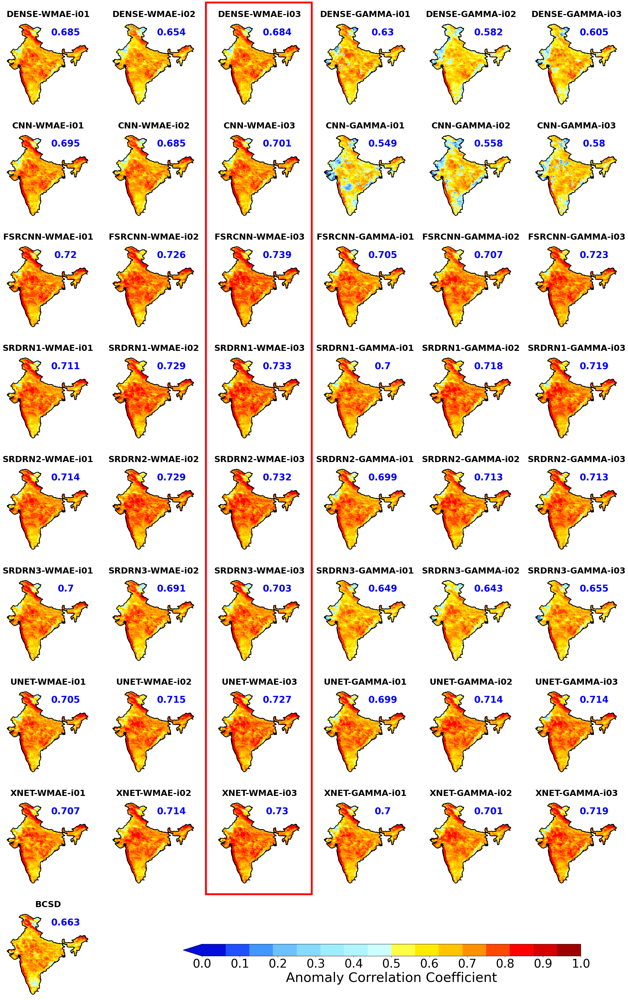

In [328]:
## Masked spatial plots
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import geopandas as gpd
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.patches import PathPatch
import cmaps
from shapely.geometry import box
from matplotlib.gridspec import GridSpec
import matplotlib.patches as patches

#################### Calculate metric value ####################

def abs_mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(abs(arr))
    return arr

def mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(arr)
    return arr

def create_axes(nrows, ncols, figsize=(13,13), hspace=None, wspace=None):
    
    # Create figure and axis objects
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows, ncols, figure=fig, hspace=hspace) #  , wspace=wspace hspace=0.5, wspace=0

    # Create subplots with specific projection using GridSpec
    axes = []
    for i in range(nrows):
        for j in range(ncols):
            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
            axes.append(ax)
    # fig.tight_layout()

    # fig.tight_layout(pad=0) 
    # plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
    return fig, axes

def get_lon_lat(ds, data_var):
    """
    Extract longitude and latitude values from 
    xarray array and variable name
    """
    
    data_coords = ds[data_var].coords
    lon_var, lat_var = None, None

    for coord_name, coord_var in data_coords.items():
        if 'longitude' in coord_var.standard_name or 'lon' in coord_var.standard_name:
            lon_var = coord_var
        elif 'latitude' in coord_var.standard_name or 'lat' in coord_var.standard_name:
            lat_var = coord_var

    return lon_var, lat_var

def filter_df(df, column, string):
    """ Select and merge rows from the dataframe where the specified string is present in the specified column""" 
    filtered_df = df[df[column].str.contains(string, na=False)]
    return filtered_df

def df_to_dict(df, key_col, value_cols):
    """
    Convert multiple columns of a DataFrame into a dictionary with lists of values.
    """
    return df.set_index(key_col)[value_cols].T.to_dict('list')

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray*maskarray

def my_custom_subplot(ax, ds, lonlat, cmap, vmin, vmax, 
                      title=None, ylabel=None, 
                      text=None, text_loc=None, 
                      overlay_pval=False, pval_data=None, 
                     ):
    
    # Plot data ds1 with inverted y-axis
    im = ax.imshow(ds, 
                   cmap=cmap, 
                   alpha=1.0, 
                   vmin=vmin, 
                   vmax=vmax,
                   extent=[lonlat[0].data.min(), 
                           lonlat[0].data.max(),
                           lonlat[1].data.max(),
                           lonlat[1].data.min()], 
                   origin='upper', 
                   transform=ccrs.PlateCarree()
                  )
    # ---------------
    # Add coastlines
    # ---------------
    # ax.coastlines(resolution='50m')
    ax.invert_yaxis()
    
    # --------------------
    # Add India shapefile
    # --------------------
    shapefile_path = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES/India.shp"         
    shapefile_df = gpd.read_file(shapefile_path)
    countries = shapefile_df['geometry']
    ax.add_geometries(countries, ccrs.PlateCarree(), facecolor='none', edgecolor='black', linewidth=2)

    # -----------------------
    # Overlay pvalue hatches 
    # -----------------------
    if overlay_pval:

        if pval_data is None:
            raise ValueError('You have asked to plot pval stipples, but no data passed.')
        else:
            significance_threshold = 0.01
            significant_mask = pval_data <= significance_threshold
        

    
        # Overlay hatched polygons for significant correlations
        bbox = box(lonlat[0].data.min(), lonlat[1].data.min(), lonlat[0].data.max(), lonlat[1].data.max())
        for geom in countries:
            if bbox.intersects(geom):
                masked_geom = geom.intersection(bbox)
                if masked_geom.is_empty:
                    continue   
                if significant_mask.sel(longitude=slice(masked_geom.bounds[0], masked_geom.bounds[2]),
                                         latitude=slice(masked_geom.bounds[1], masked_geom.bounds[3])).any():
                    ax.add_geometries([masked_geom], 
                                      ccrs.PlateCarree(), 
                                      facecolor='none', 
                                      edgecolor='k', 
                                      hatch='.', 
                                      linewidth=1)
                    continue
    
    # -------------------------
    # Add text inside the plot
    # -------------------------
    if text is not None:
        ax.text(text_loc[0], text_loc[1], 
                text, 
                transform=ax.transAxes, ha='center', va='center', 
                fontsize=25, fontweight='bold', 
                color='blue', backgroundcolor=None, bbox=None)

    # ------------------------------
    # Additional plot customization
    # ------------------------------
    ax.set_title(title, loc='center', fontsize=23, fontweight='semibold')
    ax.set_ylabel(ylabel, loc='center', fontsize=22, fontweight='semibold')
    ax.set_xticks(np.arange(70, 100, 5), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(10, 40, 5), crs=ccrs.PlateCarree())
    lon_formatter = LongitudeFormatter(zero_direction_label=False)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.tick_params(axis="both", labelsize=12)

    ax.set_axis_off()
    
    return im


#-----------------------------------------------------------------------
######################## Main run control below ########################
#-----------------------------------------------------------------------

# Create axes for subplots and set lonlat limits
fig, axes = create_axes(nrows=9, ncols=6, figsize=(30,45), hspace=0.1, wspace=None)
lon_l, lat_l = (70, 98, 5), (10, 38, 5)

# Load datafiles
DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
d = xr.open_dataset(f'{DPATH}/EVAL_METRICS_SPATIAL_v1.nc')
df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")

m = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES/India.nc')

varname = 'ACC'
cbar_label = 'Anomaly Correlation Coefficient'

DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")
df = filter_df(df, column='ZONE_NAME', string="INDIA")
# df = filter_df(df, column='EXP_ID', string="L01")

exp_dict = df_to_dict(df, key_col="EXP_ID", value_cols=["LABEL", varname])

#-----------------------------------------------------------------------
############################# Edit below ###############################
#-----------------------------------------------------------------------

cmap = cmaps.GMT_panoply
vmin, vmax, inc = 0, 1, 0.1

for i, (exp_id, (title, metric_val)) in enumerate(exp_dict.items()):
    
    my_var = f'{exp_id}_{varname}'
    ds_f = mask_array(d[my_var].squeeze(), m['mask'].squeeze())
    im = my_custom_subplot(ax=axes[i], 
                    ds=ds_f,
                    lonlat=get_lon_lat(d, my_var), 
                    cmap=cmap, vmin=vmin, vmax=vmax,
                    text=abs_mean(ds_f.data).round(3), #round(metric_val, 3), #mean(d[my_var][:].data).round(4),
                    text_loc=[0.7, 0.85],
                    ylabel=None,
                    title=title,
                    overlay_pval=False,
                    pval_data = d[f'{exp_id}_TSTAT_PVAL'],
                    )
    
#----------------------------------------------------
# Add the rectangular box to the Figure object
#----------------------------------------------------

# Calculate the rectangle position and size to cover the third column
x = axes[2].get_position().xmin - 0.012 # x position of the third column
y = axes[44].get_position().ymin  - 0.057  # Shift down by decreasing y position
width = axes[2].get_position().width * 1.2  # width of the third column subplot
height = (axes[2].get_position().ymax  * 1.1) - (axes[44].get_position().ymin * 1.1)  # total height of the third column

# Add the rectangle to the figure using fig.patches
rect = patches.Rectangle((x, y), width, height, linewidth=5, edgecolor='r', facecolor='none', transform=fig.transFigure)
fig.patches.append(rect)  # Add patch to fig.patches

#----------------------------------------------------
# Uncomment below code snippet to set horizontal cbar 
#----------------------------------------------------

fig.subplots_adjust(bottom=0.05)
cbar_ax = fig.add_axes([0.35, 0.09, 0.5, 0.01])
cb = fig.colorbar(im, cax=cbar_ax, 
                  ticks=np.arange(vmin, vmax+inc, inc), 
                  orientation="horizontal", 
                  extend='min')
cb.ax.tick_params(labelsize=32)
cb.set_label(cbar_label, 
             rotation = 0, 
             fontsize = 36, 
             fontweight='normal') 

for ax in axes[-5:]:
    ax.axis('off')

SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS'
# plt.savefig(f'{SAVE_DIR}/Figure_SpatialMap_{varname.upper()}.png', format='png', dpi=400, bbox_inches='tight',facecolor='w', edgecolor='w')
plt.show()



## Figure: Spatial Map of Evaluation Metrics - NSE

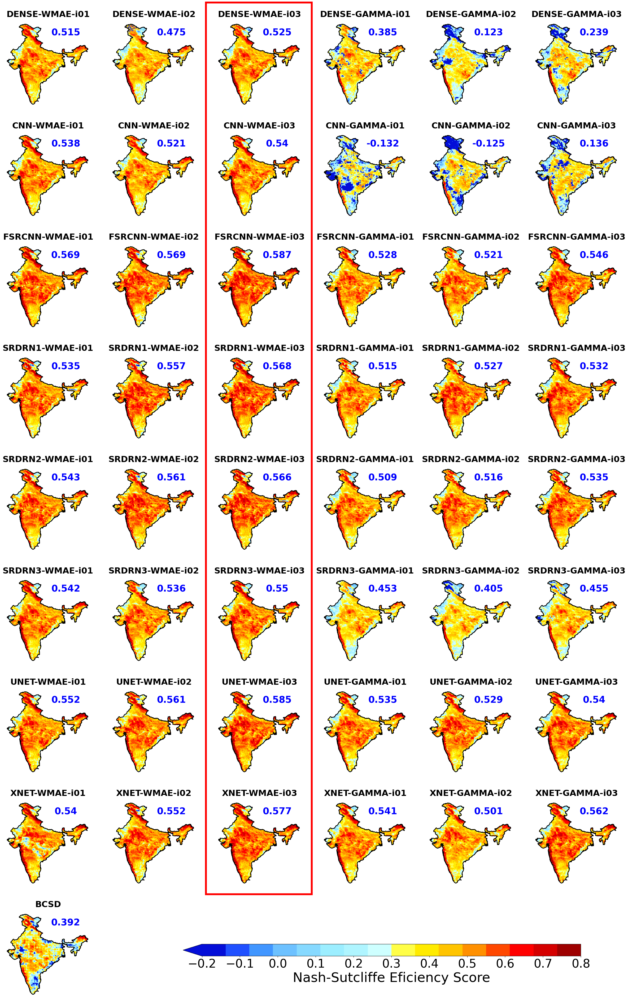

In [125]:
## Masked spatial plots
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import geopandas as gpd
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.patches import PathPatch
import cmaps
from shapely.geometry import box
from matplotlib.gridspec import GridSpec
import matplotlib.patches as patches

#################### Calculate metric value ####################

def abs_mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(abs(arr))
    return arr

def mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(arr)
    return arr

def create_axes(nrows, ncols, figsize=(13,13), hspace=None, wspace=None):
    
    # Create figure and axis objects
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows, ncols, figure=fig, hspace=hspace) #  , wspace=wspace hspace=0.5, wspace=0

    # Create subplots with specific projection using GridSpec
    axes = []
    for i in range(nrows):
        for j in range(ncols):
            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
            axes.append(ax)
    # fig.tight_layout()

    # fig.tight_layout(pad=0) 
    # plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
    return fig, axes

def get_lon_lat(ds, data_var):
    """
    Extract longitude and latitude values from 
    xarray array and variable name
    """
    
    data_coords = ds[data_var].coords
    lon_var, lat_var = None, None

    for coord_name, coord_var in data_coords.items():
        if 'longitude' in coord_var.standard_name or 'lon' in coord_var.standard_name:
            lon_var = coord_var
        elif 'latitude' in coord_var.standard_name or 'lat' in coord_var.standard_name:
            lat_var = coord_var

    return lon_var, lat_var

def filter_df(df, column, string):
    """ Select and merge rows from the dataframe where the specified string is present in the specified column""" 
    filtered_df = df[df[column].str.contains(string, na=False)]
    return filtered_df

def df_to_dict(df, key_col, value_cols):
    """
    Convert multiple columns of a DataFrame into a dictionary with lists of values.
    """
    return df.set_index(key_col)[value_cols].T.to_dict('list')

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray*maskarray

def my_custom_subplot(ax, ds, lonlat, cmap, vmin, vmax, 
                      title=None, ylabel=None, 
                      text=None, text_loc=None, 
                      overlay_pval=False, pval_data=None, 
                     ):
    
    # Plot data ds1 with inverted y-axis
    im = ax.imshow(ds, 
                   cmap=cmap, 
                   alpha=1.0, 
                   vmin=vmin, 
                   vmax=vmax,
                   extent=[lonlat[0].data.min(), 
                           lonlat[0].data.max(),
                           lonlat[1].data.max(),
                           lonlat[1].data.min()], 
                   origin='upper', 
                   transform=ccrs.PlateCarree()
                  )
    # ---------------
    # Add coastlines
    # ---------------
    # ax.coastlines(resolution='50m')
    ax.invert_yaxis()
    
    # --------------------
    # Add India shapefile
    # --------------------
    shapefile_path = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES/India.shp"         
    shapefile_df = gpd.read_file(shapefile_path)
    countries = shapefile_df['geometry']
    ax.add_geometries(countries, ccrs.PlateCarree(), facecolor='none', edgecolor='black', linewidth=2)

    # -----------------------
    # Overlay pvalue hatches 
    # -----------------------
    if overlay_pval:

        if pval_data is None:
            raise ValueError('You have asked to plot pval stipples, but no data passed.')
        else:
            significance_threshold = 0.01
            significant_mask = pval_data <= significance_threshold
        

    
        # Overlay hatched polygons for significant correlations
        bbox = box(lonlat[0].data.min(), lonlat[1].data.min(), lonlat[0].data.max(), lonlat[1].data.max())
        for geom in countries:
            if bbox.intersects(geom):
                masked_geom = geom.intersection(bbox)
                if masked_geom.is_empty:
                    continue   
                if significant_mask.sel(longitude=slice(masked_geom.bounds[0], masked_geom.bounds[2]),
                                         latitude=slice(masked_geom.bounds[1], masked_geom.bounds[3])).any():
                    ax.add_geometries([masked_geom], 
                                      ccrs.PlateCarree(), 
                                      facecolor='none', 
                                      edgecolor='k', 
                                      hatch='.', 
                                      linewidth=1)
                    continue
    
    # -------------------------
    # Add text inside the plot
    # -------------------------
    if text is not None:
        ax.text(text_loc[0], text_loc[1], 
                text, 
                transform=ax.transAxes, ha='center', va='center', 
                fontsize=25, fontweight='bold', 
                color='blue', backgroundcolor=None, bbox=None)

    # ------------------------------
    # Additional plot customization
    # ------------------------------
    ax.set_title(title, loc='center', fontsize=23, fontweight='semibold')
    ax.set_ylabel(ylabel, loc='center', fontsize=22, fontweight='semibold')
    ax.set_xticks(np.arange(70, 100, 5), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(10, 40, 5), crs=ccrs.PlateCarree())
    lon_formatter = LongitudeFormatter(zero_direction_label=False)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.tick_params(axis="both", labelsize=12)

    ax.set_axis_off()
    
    return im


#-----------------------------------------------------------------------
######################## Main run control below ########################
#-----------------------------------------------------------------------

# Create axes for subplots and set lonlat limits
fig, axes = create_axes(nrows=9, ncols=6, figsize=(30,45), hspace=0.1, wspace=None)
lon_l, lat_l = (70, 98, 5), (10, 38, 5)

# Load datafiles
DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
d = xr.open_dataset(f'{DPATH}/EVAL_METRICS_SPATIAL_v1.nc')
df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")

m = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES/India.nc')

varname = 'NSE'
cbar_label = 'Nash-Sutcliffe Eficiency Score'

DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")
df = filter_df(df, column='ZONE_NAME', string="INDIA")
# df = filter_df(df, column='EXP_ID', string="L01")

exp_dict = df_to_dict(df, key_col="EXP_ID", value_cols=["LABEL", varname])

#-----------------------------------------------------------------------
############################# Edit below ###############################
#-----------------------------------------------------------------------

cmap = cmaps.GMT_panoply
vmin, vmax, inc = -0.2, 0.8, 0.1

for i, (exp_id, (title, metric_val)) in enumerate(exp_dict.items()):
    
    my_var = f'{exp_id}_{varname}'
    ds_f = mask_array(d[my_var].squeeze(), m['mask'].squeeze())
    im = my_custom_subplot(ax=axes[i], 
                    ds=ds_f,
                    lonlat=get_lon_lat(d, my_var), 
                    cmap=cmap, vmin=vmin, vmax=vmax,
                    text=round(metric_val, 3), #, # #mean(d[my_var][:].data).round(4),
                    text_loc=[0.7, 0.85],
                    ylabel=None,
                    title=title,
                    overlay_pval=False,
                    pval_data = d[f'{exp_id}_TSTAT_PVAL'],
                    )
    
#----------------------------------------------------
# Add the rectangular box to the Figure object
#----------------------------------------------------

# Calculate the rectangle position and size to cover the third column
x = axes[2].get_position().xmin - 0.012 # x position of the third column
y = axes[44].get_position().ymin  - 0.057  # Shift down by decreasing y position
width = axes[2].get_position().width * 1.2  # width of the third column subplot
height = (axes[2].get_position().ymax  * 1.1) - (axes[44].get_position().ymin * 1.1)  # total height of the third column

# Add the rectangle to the figure using fig.patches
rect = patches.Rectangle((x, y), width, height, linewidth=5, edgecolor='r', facecolor='none', transform=fig.transFigure)
fig.patches.append(rect)  # Add patch to fig.patches

#----------------------------------------------------
# Uncomment below code snippet to set horizontal cbar 
#----------------------------------------------------

fig.subplots_adjust(bottom=0.05)
cbar_ax = fig.add_axes([0.35, 0.09, 0.5, 0.01])
cb = fig.colorbar(im, cax=cbar_ax, 
                  ticks=np.arange(vmin, vmax+inc, inc), 
                  orientation="horizontal", 
                  extend='min')
cb.ax.tick_params(labelsize=32)
cb.set_label(cbar_label, 
             rotation = 0, 
             fontsize = 36, 
             fontweight='normal') 

for ax in axes[-5:]:
    ax.axis('off')

SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS'
plt.savefig(f'{SAVE_DIR}/FigureSX_SpatialMap_{varname.upper()}.png', format='png', dpi=400, bbox_inches='tight',facecolor='w', edgecolor='w')
plt.show()



## Plot Training Curves - i01

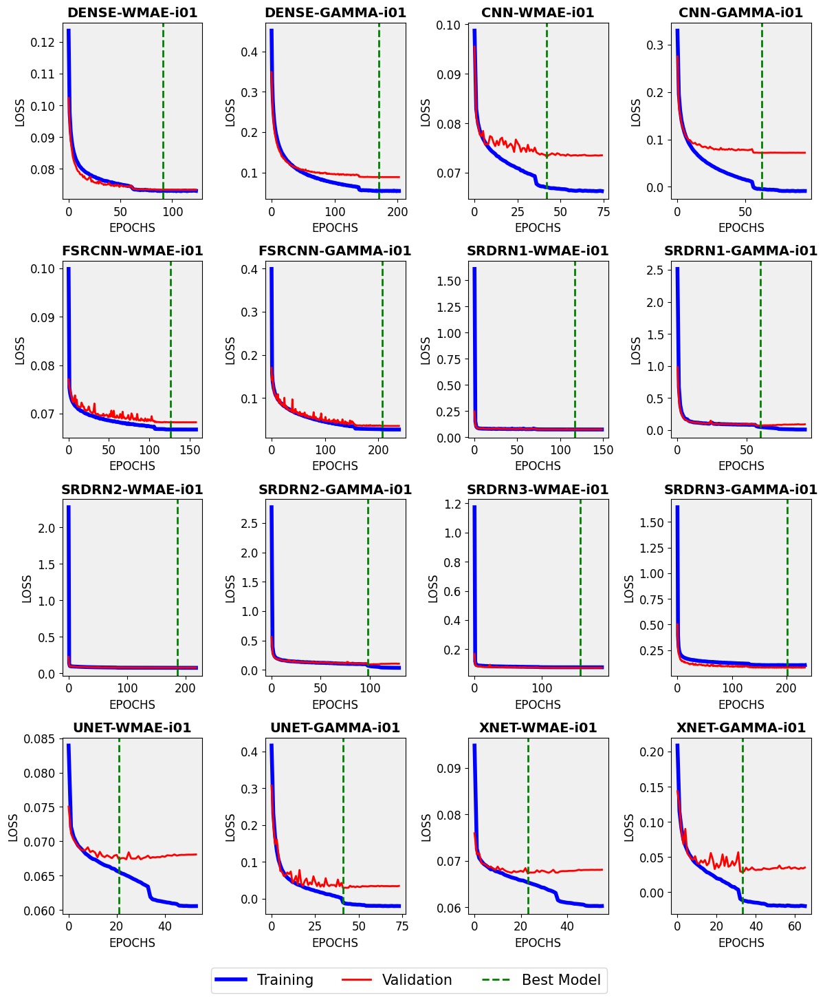

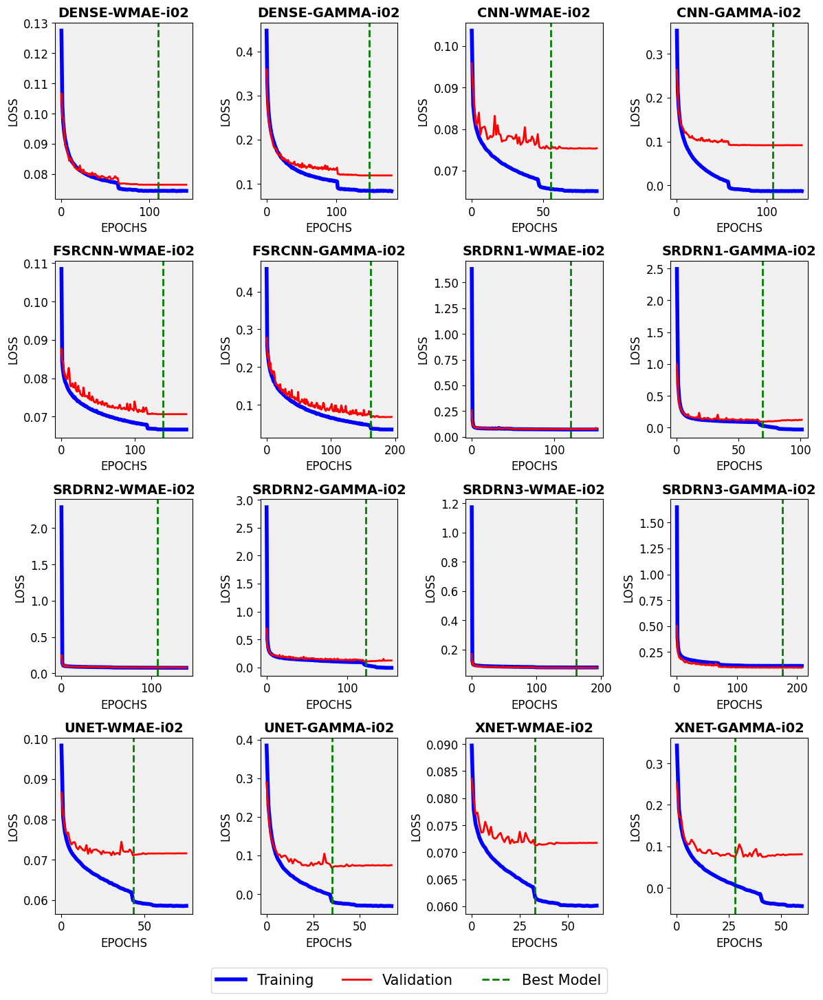

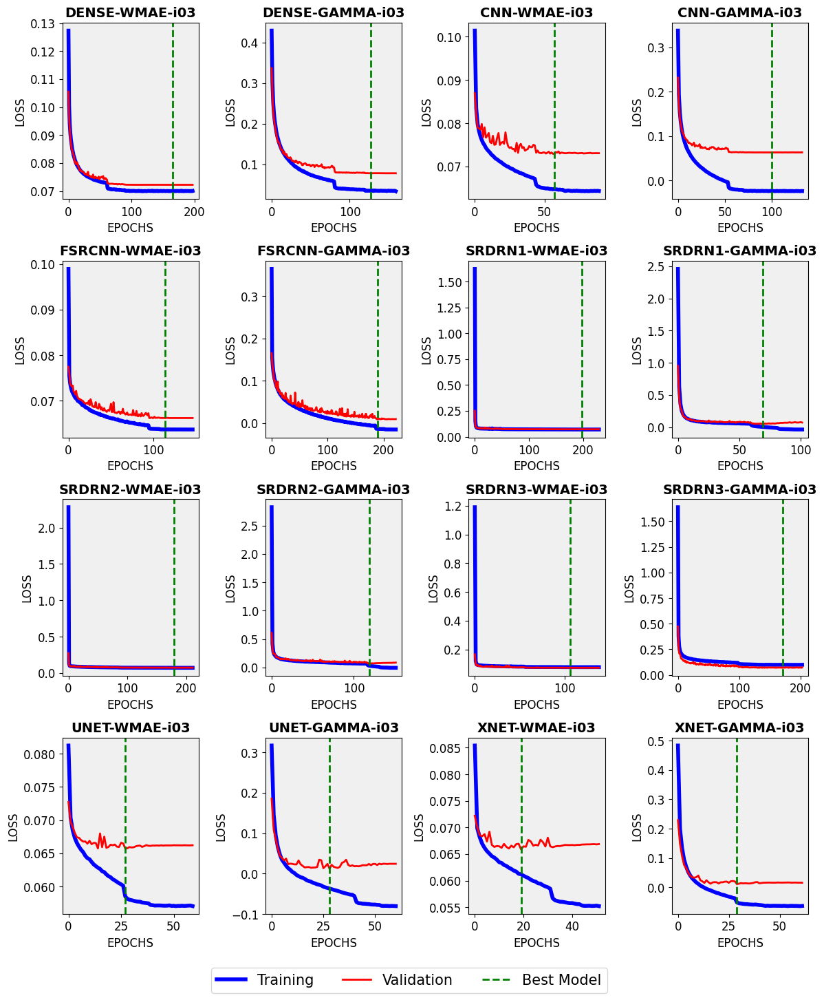

In [139]:
import os
import numpy as np
import xarray as xr
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from matplotlib.ticker import MultipleLocator

def filter_df(df, column, string):
    """
    Filter the dataframe to select rows where the specified string is present 
    in the specified column.
    """
    return df[df[column].str.contains(string, na=False)]

def df_to_dict(df, key_col, value_cols):
    """
    Convert multiple columns of a DataFrame into a dictionary with lists of values.
    """
    return df.set_index(key_col)[value_cols].T.to_dict()
    
def list_files(directory):
    file_dict = {}
    for filename in os.listdir(directory):
        if os.path.isfile(os.path.join(directory, filename)):
            key = filename[5:16].upper()
            file_dict[key] = os.path.join(directory, filename)

    # Return a dictionary sorted by keys
    return dict(sorted(file_dict.items()))

def plot_traincurve(ax, csv_path, label, loss_head='LOSS', ylim=None):
    
    df = pd.read_csv(csv_path)
    
    ax.set_facecolor('#F0F0F0')  
    # ax.grid(True)

    if loss_head=='LOSS':
        ax.plot(df['epoch'], df['loss'], linewidth=4, color='blue', label = 'Training Set')
        ax.plot(df['epoch'], df['val_loss'], linewidth=2, color='red', label = 'Validation Set')
        
    
    elif loss_head=='MAE':
        ax.plot(df['epoch'], df['mean_absolute_error'], linewidth=4, color='blue', label = 'Training Set')
        ax.plot(df['epoch'], df['val_mean_absolute_error'], linewidth=4, color='lightgreen', label = 'Validation Set')
        

    elif loss_head=='MSE':
        ax.plot(df['epoch'], df['mean_squared_error'], linewidth=4, color='blue', label = 'Training Set') 
        ax.plot(df['epoch'], df['val_mean_squared_error'], linewidth=4, color='lightgreen', label = 'Validation Set')
       

    else:
        raise ValueError('Invalid choice of loss_head. Avail options are LOSS, MAE, MSE')
        
    # Find the index of the minimum val_loss
    min_val_loss_idx = df['val_loss'].idxmin()
    min_val_loss_epoch = df.at[min_val_loss_idx, 'epoch']
    min_val_loss_value = df.at[min_val_loss_idx, 'val_loss']
    
    # Annotate the lowest val_loss point with a star marker
    # ax.scatter(min_val_loss_epoch, min_val_loss_value, color='green', s=1000, marker='*', zorder=5)
    ax.axvline(x = min_val_loss_epoch, color='green', linewidth = 2, linestyle='--', label='Best Model')

    # Set tick parameters
    ax.tick_params(axis='both', labelsize=12)
    ax.set_xlabel('EPOCHS', fontsize = 12)
    
    ax.set_ylabel(loss_head, fontsize = 12)
    
    if not ylim is None:
        ax.set_ylim(ylim[0], ylim[1])

    ax.set_title(label, fontsize=14, fontweight='bold')

####################################################################################################################

for group in ['I01', 'I02', 'I03']:
    
    CSV_DIR = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/TRAINLOGS"
    csv_dict = list_files(CSV_DIR)
    
    DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
    df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")
    df = filter_df(df, column='ZONE_NAME', string="INDIA")
    df = filter_df(df, column='EXP_ID', string=group)  # Edit here
    exp_dict = df_to_dict(df, key_col="EXP_ID", value_cols="LABEL")
    
    # Initialize files_dict as an empty dictionary
    files_dict = {}
    
    # Update files_dict with values from exp_dict
    for key in csv_dict:  # Iterate over keys in csv_dict
        if key in exp_dict:
            files_dict[key] = {'csv_path': csv_dict[key], 'label': exp_dict[key]}
    
    # Number of experiments
    num_experiments = len(files_dict)
    
    # Create a subplot grid (4x4) based on the number of experiments
    rows, cols = 4, 4
    fig, axes = plt.subplots(rows, cols, figsize=(12, 14))
    
    # Flatten the axes array to make it iterable
    axes = axes.flat
    
    # Ensure we only plot the available experiments
    for i, (exp_id, values) in enumerate(files_dict.items()):
        if i >= len(axes):  # Avoid out-of-bounds errors
            break
        csv_path, label = values['csv_path'], values['label']
        # print(f'\nLoading ... {exp_id}: {label}\n\t{csv_path}')
        plot_traincurve(axes[i], csv_path=csv_path, label=label, loss_head='LOSS', ylim=(None, None))
    
    # Adjust the legend placement on the last subplot
    fig.legend(["Training", "Validation", "Best Model"], loc='upper center', ncol=3, fontsize=15, bbox_to_anchor=(0.5, -0.001))
    
    # Adjust layout and show the plot
    plt.tight_layout()
    SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS'
    plt.savefig(f'{SAVE_DIR}/FigureSX_TrainingCurve_{group}.png', format='png', dpi=400, bbox_inches='tight',facecolor='w', edgecolor='w')
    plt.show()


## Figure Plot Snapshot Precipitation